In [1]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import plotly
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime, timedelta
from scipy.optimize import curve_fit
from scipy.ndimage import uniform_filter1d, gaussian_filter1d
from scipy import stats
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from statsmodels.tsa.seasonal import seasonal_decompose
from fbprophet import Prophet

# The final approximation function is here
from Approximation_func import time_series_approximation
from Supporting_inform_funcs import metrics_calc

from jupyterthemes import jtplot
jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False)

import plotly.io as pio
pio.templates.default = "plotly_dark"

In [2]:
#data = pd.read_excel('./Testing_field.xlsx', header=0, sheet_name=None)

In [3]:
#testing_data['Дни'] = (testing_data['Дата'] - testing_data['Дата'].iloc[0]).dt.days

In [4]:
#time_series_approximation(df, field, fourier_order=8, noise_alpha=0.05, noise_window=5, changepoint_cutoff=0.98, prediction=3*365)

In [37]:
data = pd.read_excel('./Production_UGSS.xlsx', header=0, sheet_name=None)

In [38]:
df = pd.concat([data[key] for key in data.keys()], axis=0, ignore_index=True)

In [39]:
df.head()

,Дата,Предприятие,Месторождение,Добыча,Собственные нужды
0,2010-01-01,ГДП Ямбург,Заполярное,347770.0,3427.930487
1,2010-01-02,ГДП Ямбург,Заполярное,347090.0,3479.253922
2,2010-01-03,ГДП Ямбург,Заполярное,345865.0,3415.807493
3,2010-01-04,ГДП Ямбург,Заполярное,345055.0,3323.091021
4,2010-01-05,ГДП Ямбург,Заполярное,346272.0,3438.256770


In [40]:
df['Дни'] = (df['Дата'] - df['Дата'].iloc[0]).dt.days

In [79]:
fields_GP = df['Месторождение'].unique()[np.where(~np.isin(df['Месторождение'].unique(), ['ЗАО Нортгаз (ГП 50%)', 
                                                                                          'ОАО НГК Славнефть (ГП 50%)', 
                                                                                          'АО Арктикгаз (ГП 50%)',
                                                                                          'ЗАО УралНГП (ГП 37.7%)', 
                                                                                          'ОАО Томскнефть (ГП 50%)',
                                                                                          'Нефтяные компании', 
                                                                                          'Независимые производители']))]
df.loc[np.isin(df['Месторождение'], fields_GP), :].groupby('Дата').agg(Добыча=('Добыча', np.sum), Собственные_нужды=('Собственные нужды', np.sum))

,Добыча,Собственные_нужды
Дата,,
2010-01-01,1611164.000,19883.250000
2010-01-02,1617588.000,20565.550000
2010-01-03,1609525.000,20190.500000
2010-01-04,1612668.000,19804.200000
2010-01-05,1614672.000,20083.000000
...,...,...
2021-07-20,1073839.707,47084.824731
2021-07-21,1142293.661,48131.738124
2021-07-22,1159881.804,49865.781375


In [41]:
own_trend_list = pd.read_excel('./Trends_list.xlsx', header=0)

In [55]:
exceptions = {'change_points': {# Improve the history matching by adding new change points
                                'Заполярное': [2735],#, 3450], #, 3877],
                                'Ямсовейское': [3200],
                                'Губкинское (сеном)': [2100],
                                "АО Арктикгаз (ГП 50%)": [2000],
                                'Вынгапуровское': [1900],
                                'Еты-Пуровское': [2480],
                                'Комсомольское': [2500],
                                'Южно-Русское НГКМ': [3660],
                                'Бейсугское ГМ': [2130],
                                'Ямбургское': [2000, 2760],
                                'Медвежье (сеном)': [3540], # [2150],
                                'Вынгаяхинское': [2490],
                                'Мирное': [3410],
                                'УКПГ-22 (Ачимовка)': [1780, 3850],
                                'УКПГ-31 (Ачимгаз)': [1050],
                                "Патроновское ГКМ": [3200, 3790],
                                "Зап.-Красноармейское ГМ": [3845],
                                "Казанское": [570],
                                "Граничное ГКМ": [2530],
                                "ОАО Томскнефть (ГП 50%)": [3500],
                                "Нефтяные компании": [200],
                                "Независимые производители": [550, 2750],
                                "ЗАО ПечораНГП": [1850, 2350],
                                "Ен.-Яхинское (В.)": [2350],
                                "Сев.-Прибрежное НГКМ": [2220],
                                
                                # Correction of not fitted fields
                                'Харасавэйское': [3820],
                                'Гречаное ГМ': [2300, 3945],
                                'Ю.Черноерковск.НГКМ': [3545],
                                "Рыбальное": [3445, 4160],
                                "Киринское ГКМ": [1830],
                                "Северо-Булганакское": [3290],
                               },
              'simple_approximation': {# Use simple approximation for series with lack of data
                                       "Тазовское (МНГ)": np.median, 
                                       "Рыбальное": np.median,
                                       "Ен.-Яхинское (ГПН-Зап)": np.median, 
                                       "УКПГ-51 (АчимДевелопмент)": np.median,
                                       "УКПГ-НТС": np.median,
                                       "Пинджинское": np.median,
                                       "Зап.-Красноармейское ГМ": np.median,
                                      },
#               'own_trend': own_trend_list,
              'own_trend': pd.DataFrame(columns=['Дата', 'Собственные нужды', 'Месторождение']),
             }

************************************************************************************************************************
The field "Заполярное"
Change points: [2011.8 2014.2 2016.7 2017.5]
Fourier function of 8-th order
R2=0.795; MAE=22816.5 (mean_y=265607.26); RMSE=29791.29


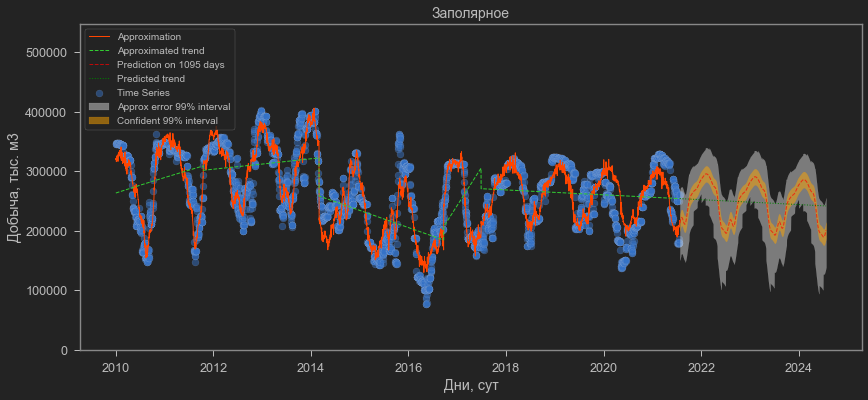

************************************************************************************************************************
The field "Ямбургское"
Change points: [2015.5 2017.6]
Fourier function of 8-th order
R2=0.922; MAE=11295.26 (mean_y=191935.64); RMSE=15997.46


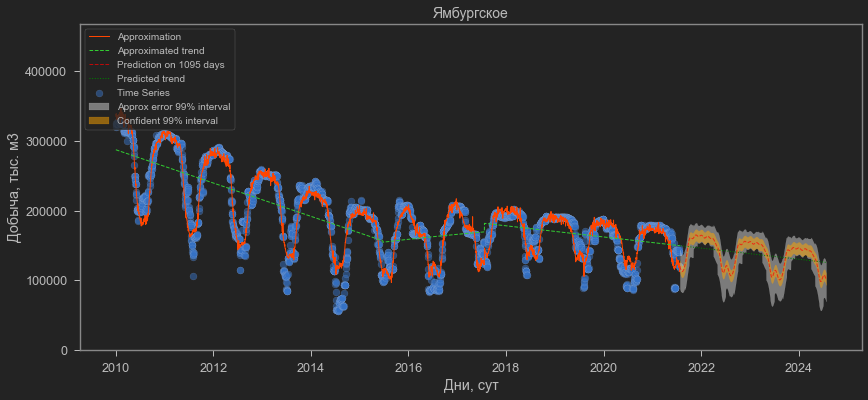

************************************************************************************************************************
The field "Бованенковское"
Change points: [nan]
Fourier function of 8-th order
R2=0.934; MAE=16478.11 (mean_y=188021.84); RMSE=23400.26


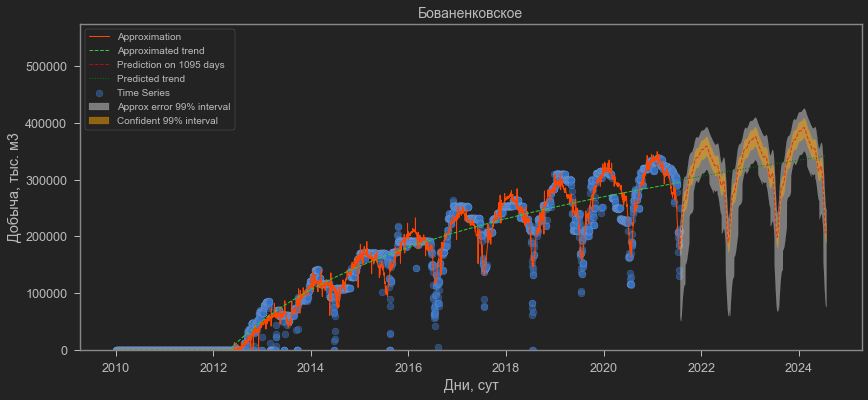

************************************************************************************************************************
The field "Медвежье (сеном)"
Change points: [2012.2 2014.4 2016.7 2019.4 2019.7]
Fourier function of 8-th order
R2=0.921; MAE=1739.79 (mean_y=22380.67); RMSE=2978.77


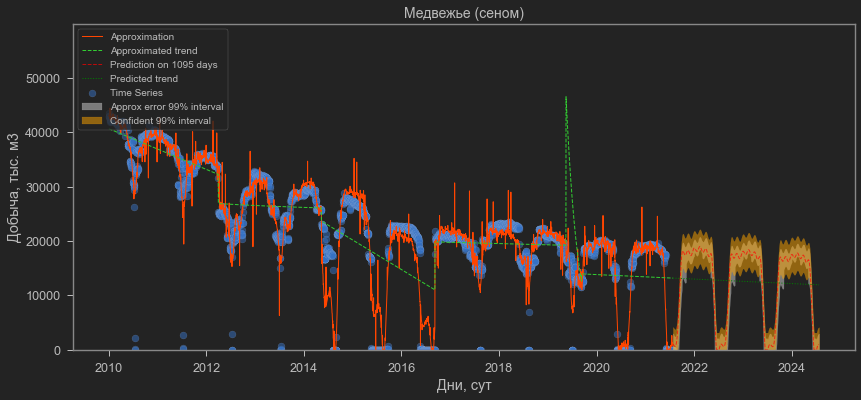

************************************************************************************************************************
The field "УКПГ-НТС"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-0.079; MAE=343.42 (mean_y=2682.45); RMSE=759.64


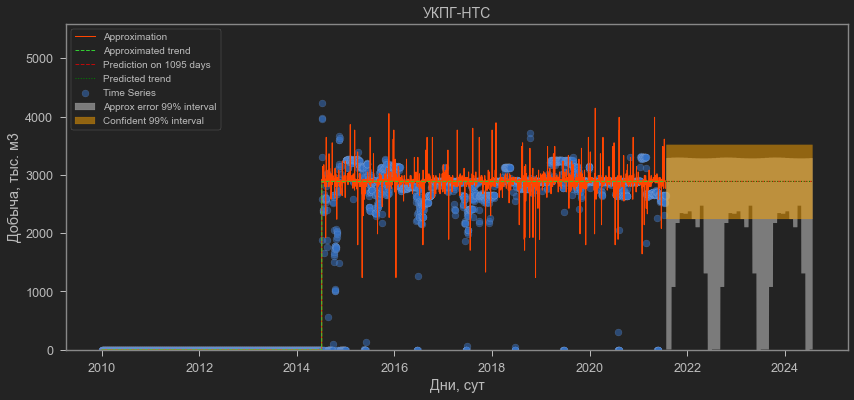

************************************************************************************************************************
The field "УКПГ-Ныда"
Change points: [2016.4]
Fourier function of 8-th order
R2=0.58; MAE=409.29 (mean_y=5257.23); RMSE=762.9


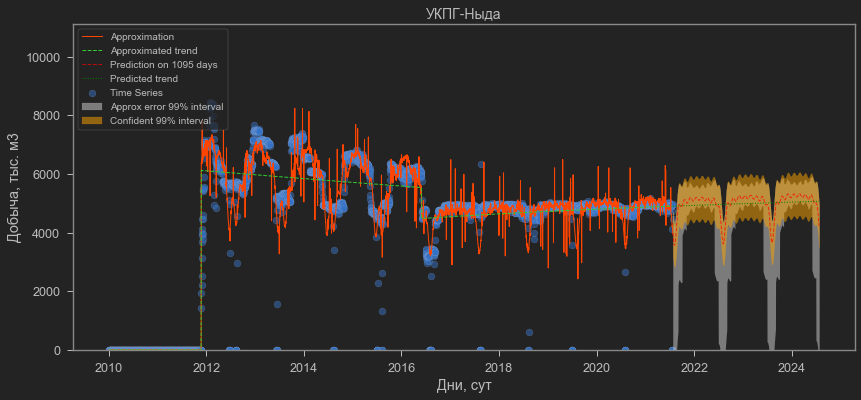

************************************************************************************************************************
The field "Харасавэйское"
Change points: [2018.3 2020.5]
Fourier function of 8-th order
R2=0.933; MAE=4.19 (mean_y=44.84); RMSE=11.35


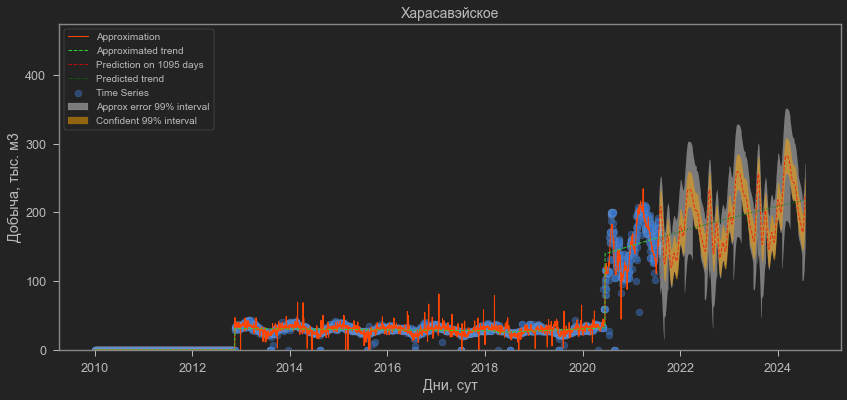

************************************************************************************************************************
The field "Юбилейное (сеном)"
Change points: [2014.  2016.7]
Fourier function of 8-th order
R2=0.816; MAE=4783.49 (mean_y=27738.2); RMSE=7465.2


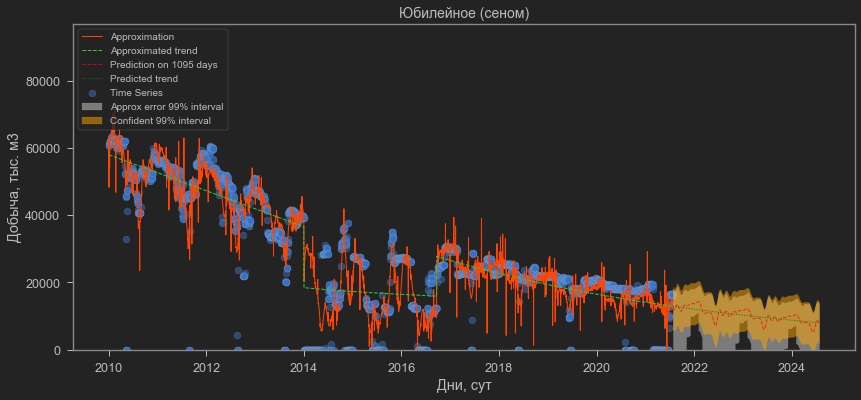

************************************************************************************************************************
The field "Ямсовейское"
Change points: [2012.3 2014.  2016.7 2018.8]
Fourier function of 8-th order
R2=0.714; MAE=6417.79 (mean_y=40990.22); RMSE=10055.39


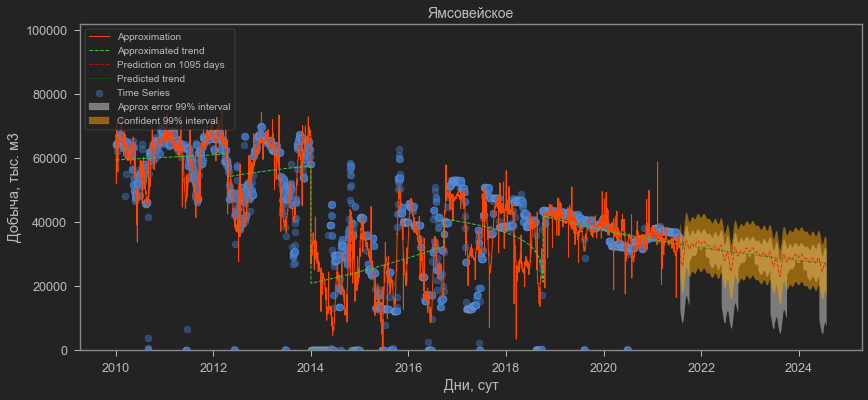

************************************************************************************************************************
The field "Вынгапуровское"
Change points: [2012.5 2014.4 2015.2 2016.4]
Fourier function of 8-th order
R2=0.871; MAE=241.95 (mean_y=1571.06); RMSE=448.68


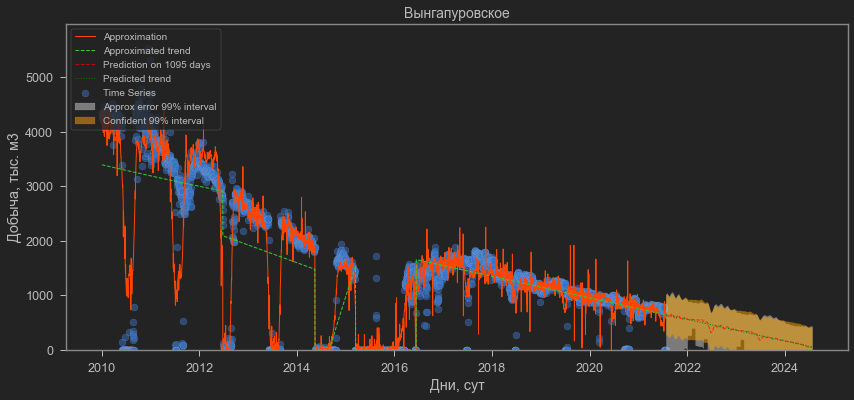

************************************************************************************************************************
The field "Вынгаяхинское"
Change points: [2013.4 2016.8 2019.7]
Fourier function of 8-th order
R2=0.74; MAE=835.01 (mean_y=13357.78); RMSE=1583.53


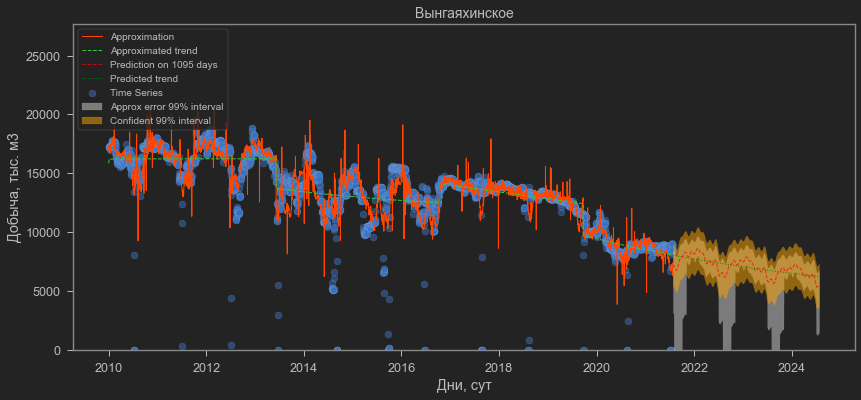

************************************************************************************************************************
The field "Еты-Пуровское"
Change points: [2016.8]
Fourier function of 8-th order
R2=0.697; MAE=2888.15 (mean_y=33218.36); RMSE=5054.8


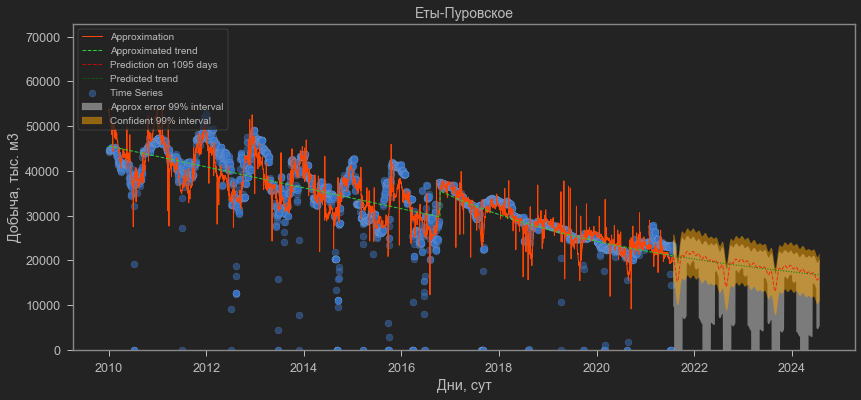

************************************************************************************************************************
The field "Зап.Таркосалинск."
Change points: [nan]
Fourier function of 8-th order
R2=0.938; MAE=1748.98 (mean_y=19770.39); RMSE=2802.36


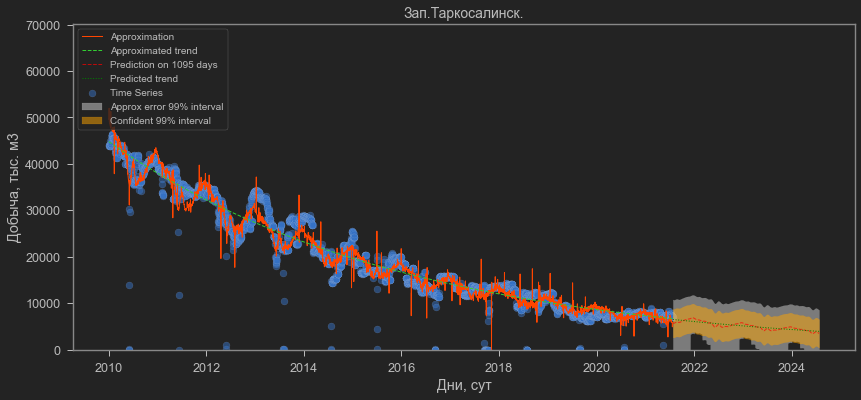

************************************************************************************************************************
The field "Комсомольское"
Change points: [2016.8]
Fourier function of 8-th order
R2=0.926; MAE=3030.1 (mean_y=31848.6); RMSE=5468.52


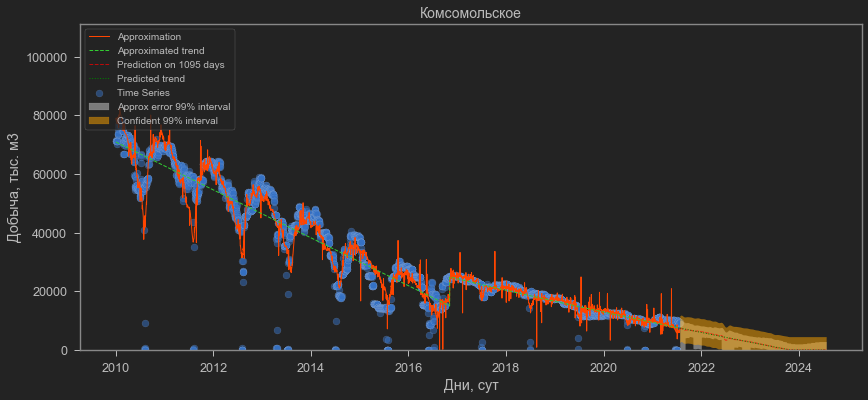

************************************************************************************************************************
The field "Астраханское ГКМ"
Change points: [2013.3]
Fourier function of 8-th order
R2=0.444; MAE=2299.32 (mean_y=30013.28); RMSE=3063.92


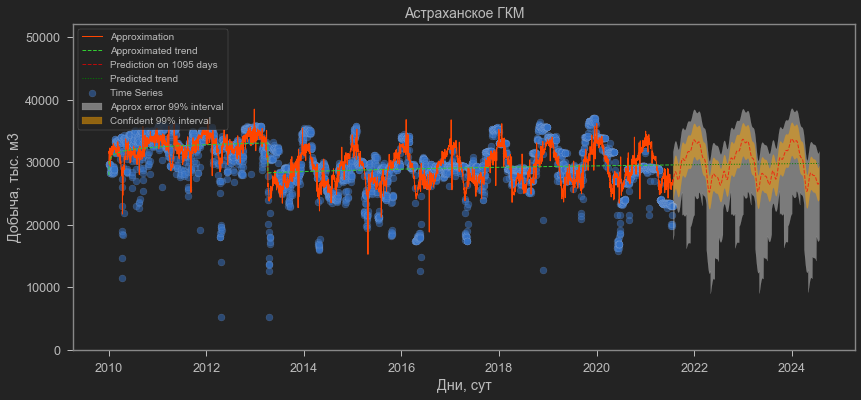

************************************************************************************************************************
The field "Болтное"
Change points: [2013.4 2015.6]
Fourier function of 8-th order
R2=0.445; MAE=3.77 (mean_y=15.08); RMSE=5.83


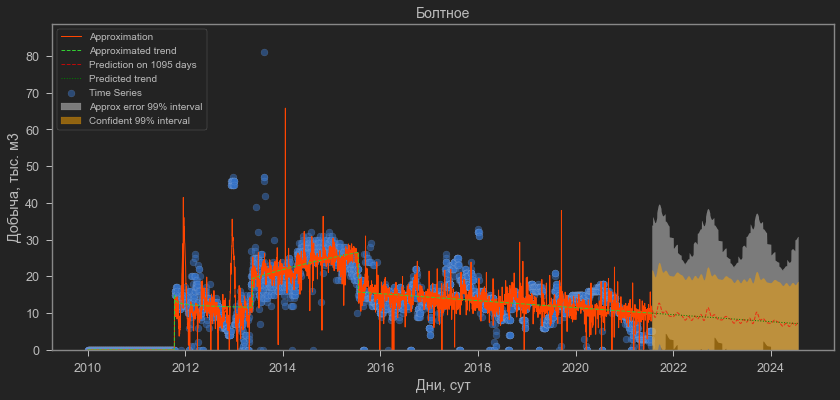

************************************************************************************************************************
The field "Казанское"
Change points: [2011.6 2014.7]
Fourier function of 8-th order
R2=0.865; MAE=211.53 (mean_y=2190.86); RMSE=379.33


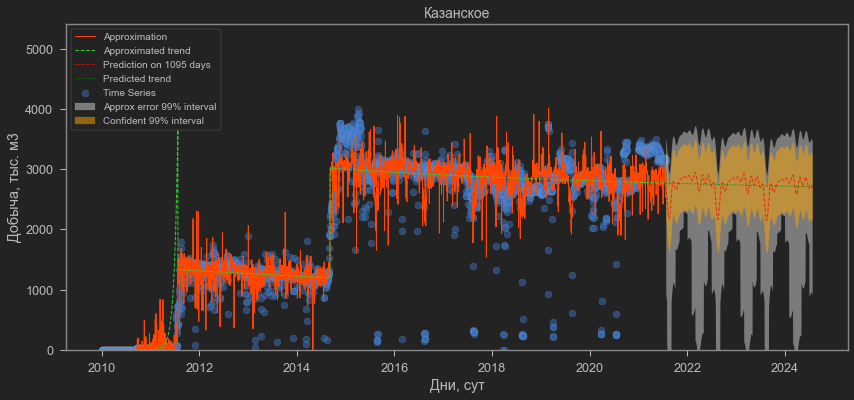

************************************************************************************************************************
The field "Мирное"
Change points: [2015.6 2018.6 2019.3]
Fourier function of 8-th order
R2=0.912; MAE=13.85 (mean_y=100.11); RMSE=27.97


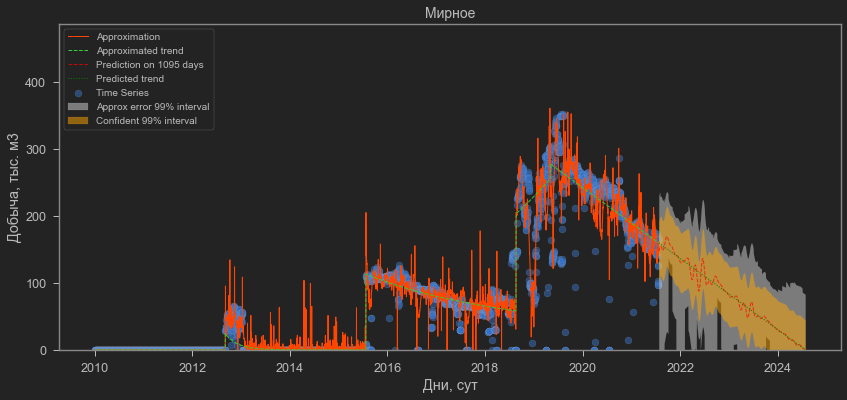

************************************************************************************************************************
The field "Мыльджинское"
Change points: [nan]
Fourier function of 8-th order
R2=0.671; MAE=458.94 (mean_y=4825.49); RMSE=745.19


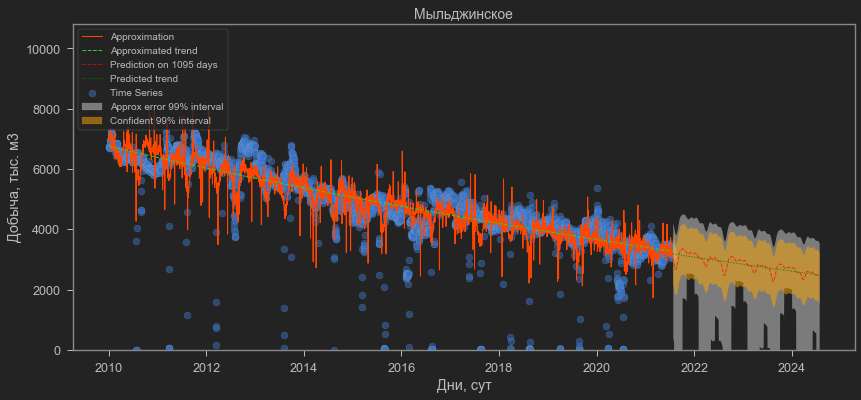

************************************************************************************************************************
The field "Останинское"
Change points: [2017.3 2020. ]
Fourier function of 8-th order
R2=0.857; MAE=119.32 (mean_y=856.38); RMSE=210.72


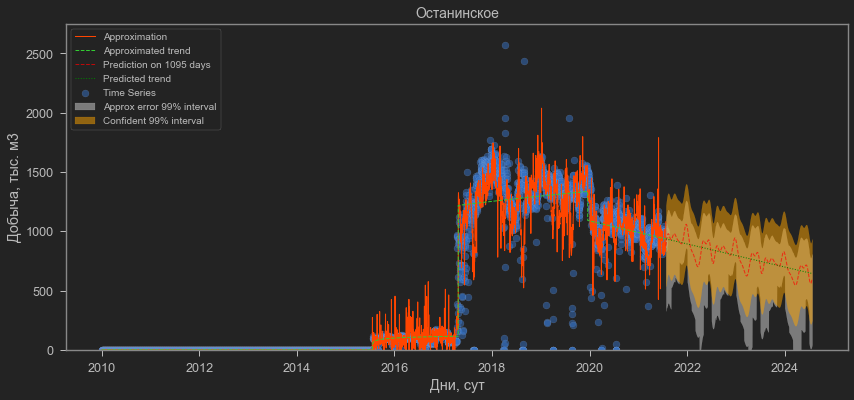

************************************************************************************************************************
The field "Пинджинское"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-1.77; MAE=2.83 (mean_y=1.37); RMSE=3.29


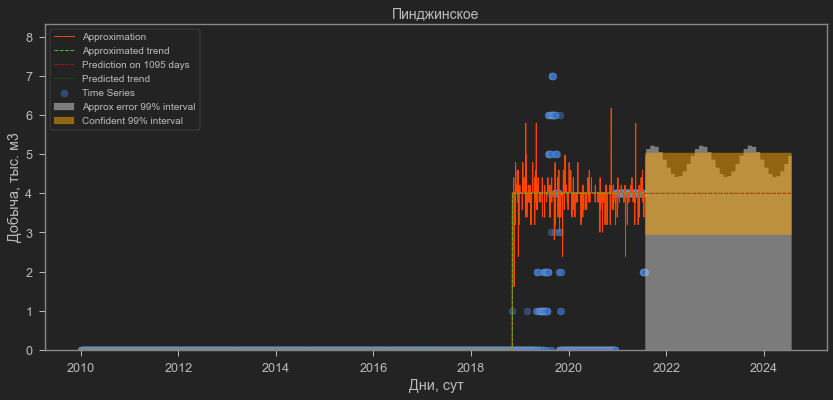

************************************************************************************************************************
The field "Рыбальное"
Change points: [2019.4 2021.4]
Fourier function of 8-th order
Use simple approximation median
R2=0.827; MAE=3.05 (mean_y=11.44); RMSE=6.02


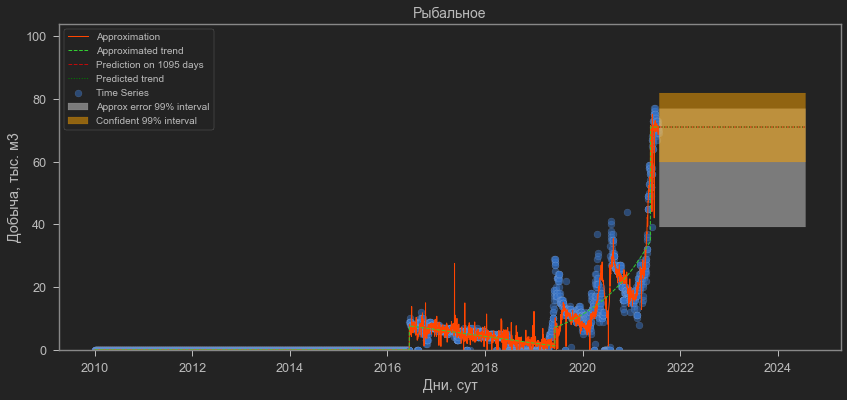

************************************************************************************************************************
The field "Северо-Васюганское"
Change points: [2012.8 2019.2]
Fourier function of 8-th order
R2=0.437; MAE=125.88 (mean_y=1570.94); RMSE=226.97


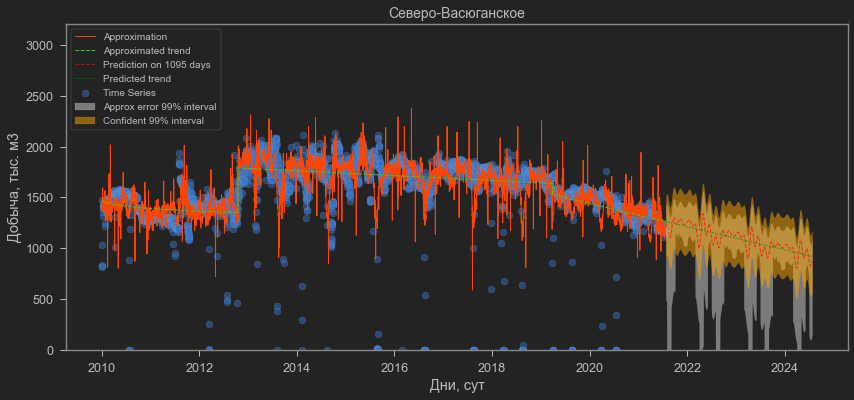

************************************************************************************************************************
The field "Северо-Останинское"
Change points: [2014.  2015.7 2017.7 2019.9]
Fourier function of 8-th order
R2=0.687; MAE=25.78 (mean_y=109.53); RMSE=40.8


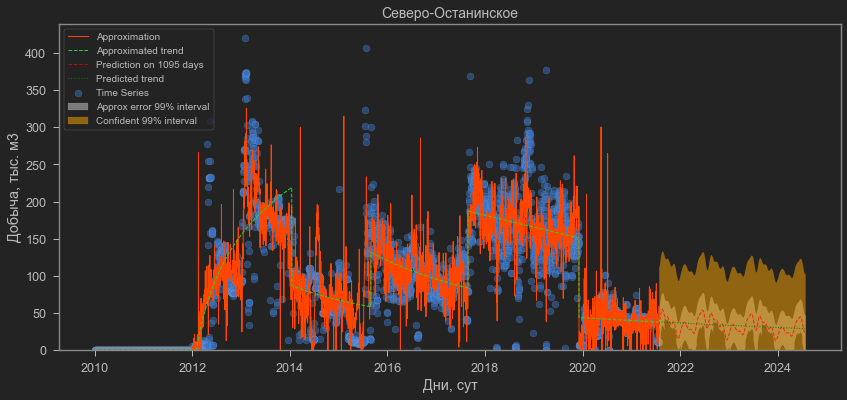

************************************************************************************************************************
The field "Ен.-Яхинское (В.)"
Change points: [2016.4 2019.6]
Fourier function of 8-th order
R2=0.715; MAE=520.03 (mean_y=11040.74); RMSE=1258.31


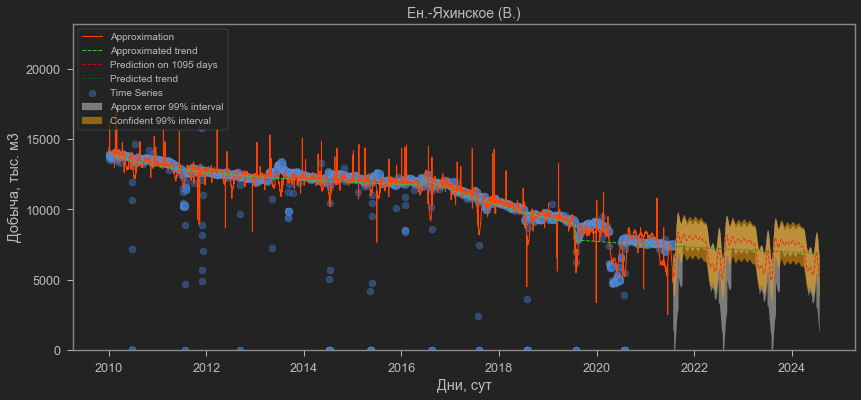

************************************************************************************************************************
The field "Ен.-Яхинское (ГПН-Зап)"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-0.339; MAE=112.23 (mean_y=666.69); RMSE=187.35


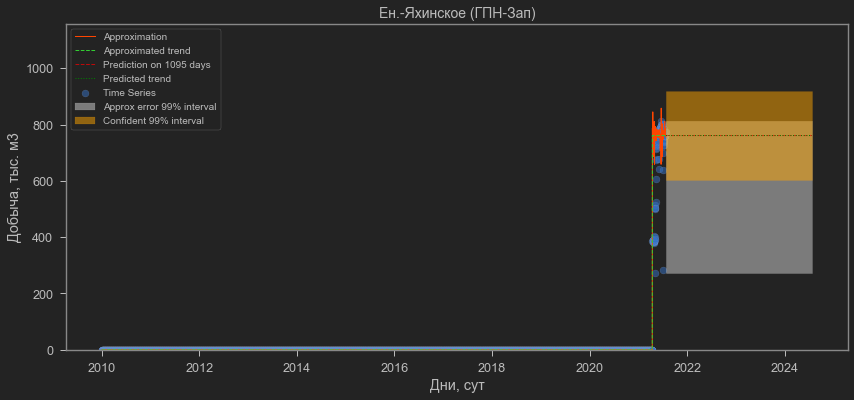

************************************************************************************************************************
The field "НГДУ (валанжин)"
Change points: [nan]
Fourier function of 8-th order
R2=0.504; MAE=250.09 (mean_y=2088.27); RMSE=418.87


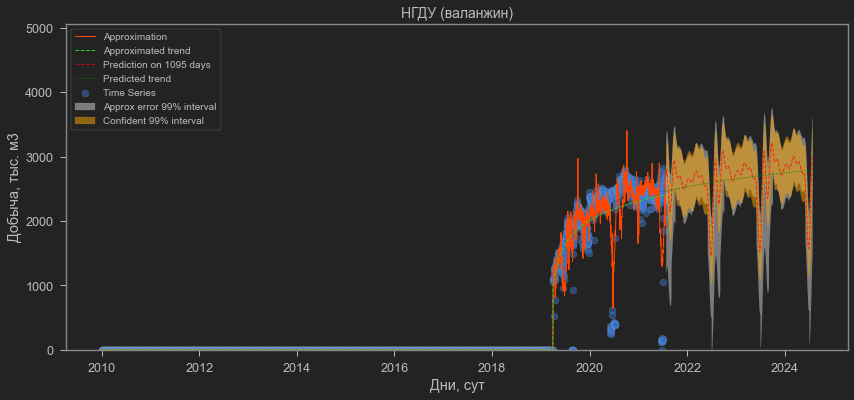

************************************************************************************************************************
The field "НГДУ (попутныйгаз)"
Change points: [nan]
Fourier function of 8-th order
R2=0.354; MAE=103.07 (mean_y=634.89); RMSE=132.1


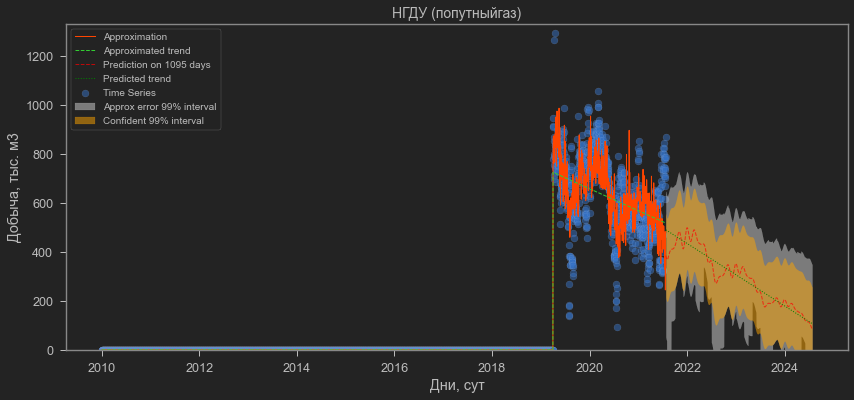

************************************************************************************************************************
The field "Песцовое"
Change points: [2014.2 2016.8]
Fourier function of 8-th order
R2=0.585; MAE=9223.84 (mean_y=62526.82); RMSE=12498.54


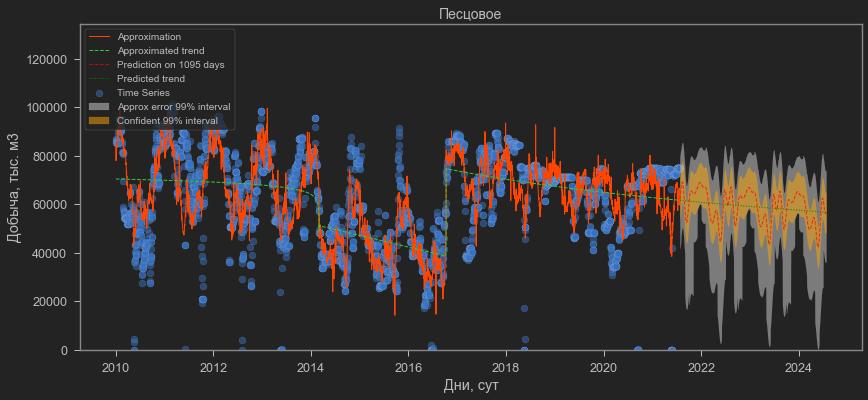

************************************************************************************************************************
The field "Песцовое (ГПН-Зап)"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


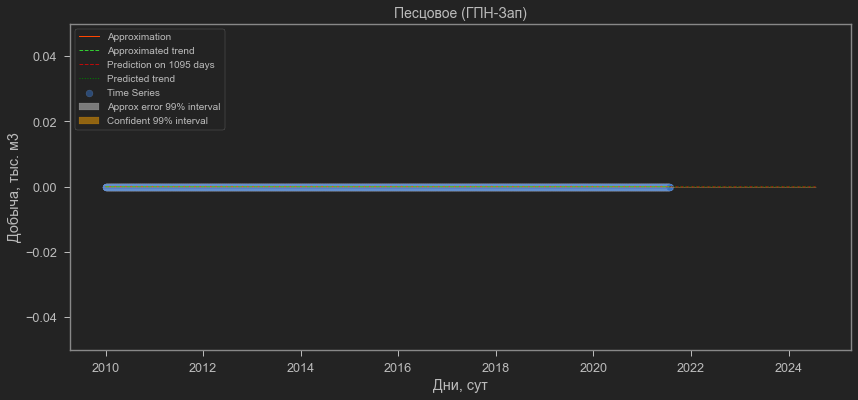

************************************************************************************************************************
The field "УКПГ-22 (Ачимовка)"
Change points: [2014.9 2020.5]
Fourier function of 8-th order
R2=0.848; MAE=806.13 (mean_y=6111.21); RMSE=1299.16


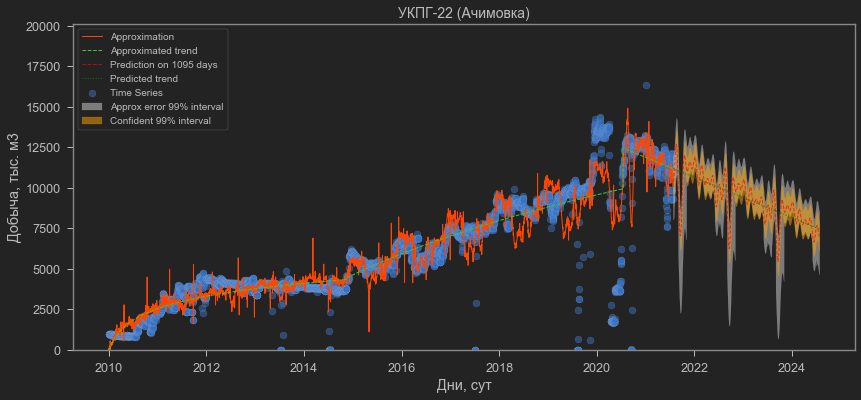

************************************************************************************************************************
The field "УКПГ-31 (Ачимгаз)"
Change points: [2012.9]
Fourier function of 8-th order
R2=0.915; MAE=1738.21 (mean_y=14461.96); RMSE=2862.34


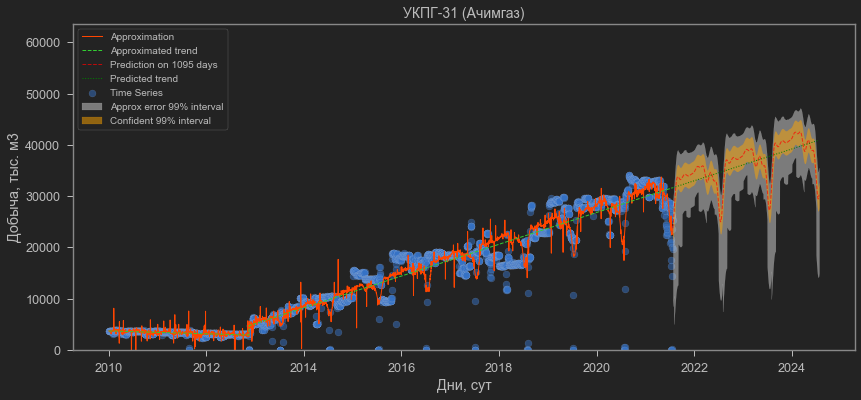

************************************************************************************************************************
The field "УКПГ-41 (АчимДевелопмент)"
Change points: [nan]
Fourier function of 8-th order
R2=0.694; MAE=401.93 (mean_y=5429.45); RMSE=674.17


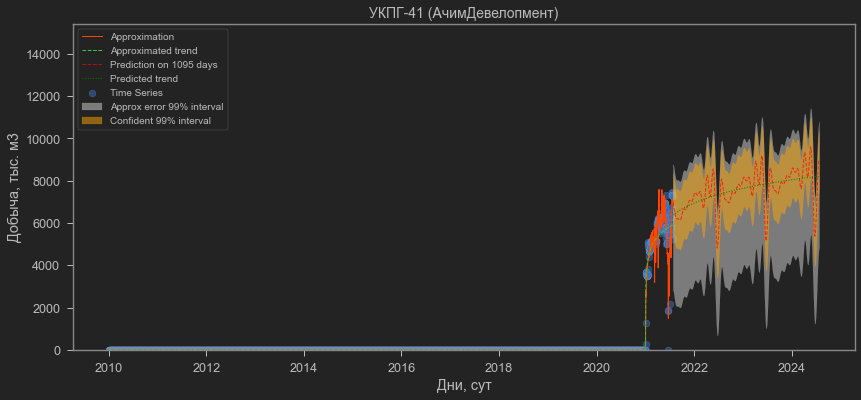

************************************************************************************************************************
The field "УКПГ-51 (АчимДевелопмент)"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-0.0182; MAE=457.81 (mean_y=3437.11); RMSE=635.46


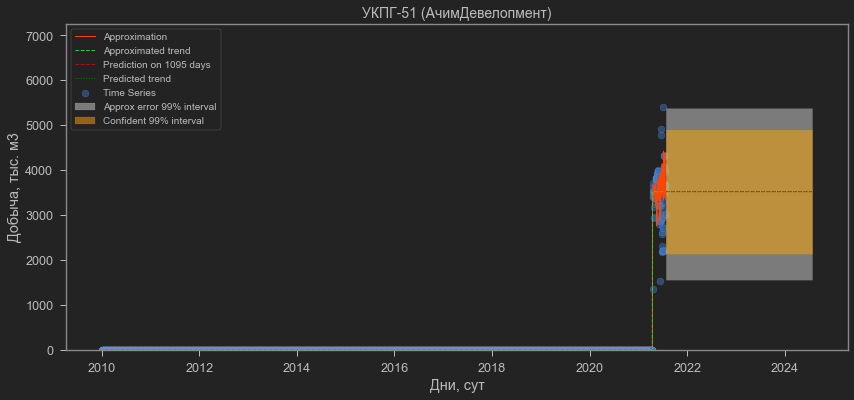

************************************************************************************************************************
The field "Уренгойское"
Change points: [2012.3 2014.4 2016.7 2019.4]
Fourier function of 8-th order
R2=0.928; MAE=8792.58 (mean_y=166060.29); RMSE=11877.54


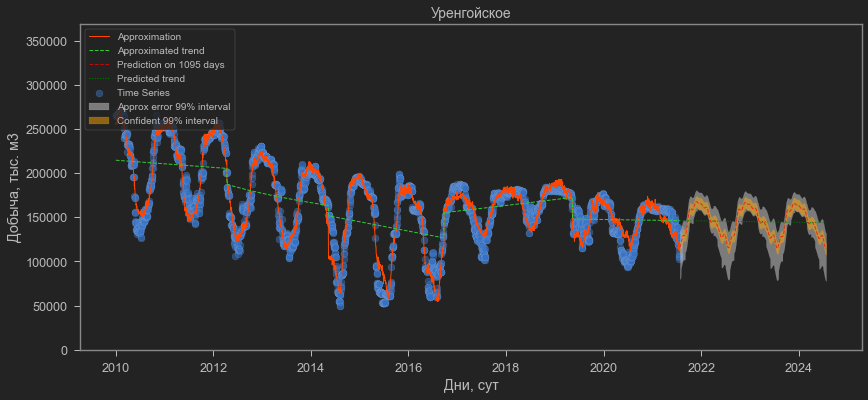

************************************************************************************************************************
The field "Губкинское (сеном)"
Change points: [2015.8]
Fourier function of 8-th order
R2=0.812; MAE=2044.65 (mean_y=32922.26); RMSE=3840.08


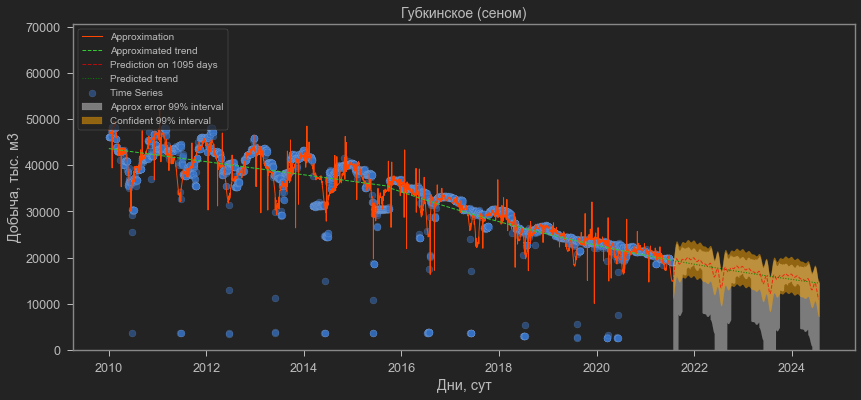

************************************************************************************************************************
The field "Южно-Русское НГКМ"
Change points: [2020.]
Fourier function of 8-th order
R2=0.463; MAE=2833.66 (mean_y=68486.97); RMSE=6758.1


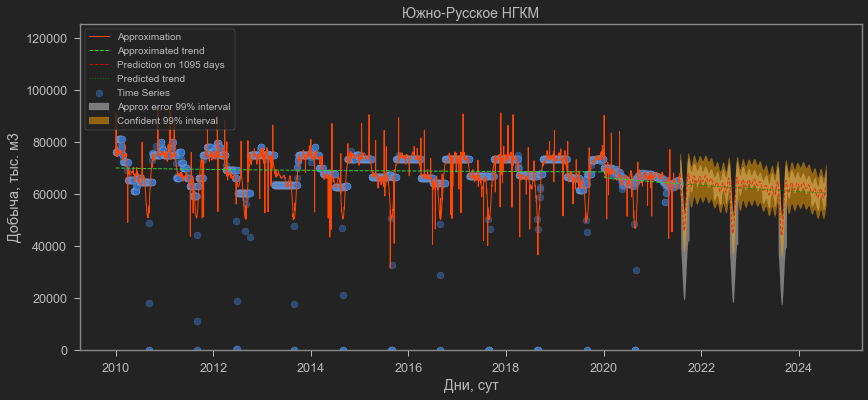

************************************************************************************************************************
The field "Оренбургское НГКМ и др"
Change points: [nan]
Fourier function of 8-th order
R2=0.808; MAE=1260.32 (mean_y=37742.88); RMSE=3249.27


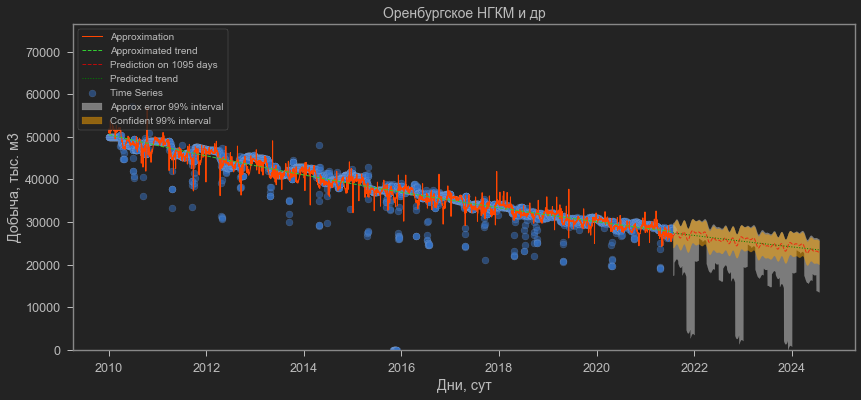

************************************************************************************************************************
The field "ООО Сервиснефтегаз"
Change points: [2015.]
Fourier function of 8-th order
R2=0.442; MAE=3.53 (mean_y=11.65); RMSE=5.12


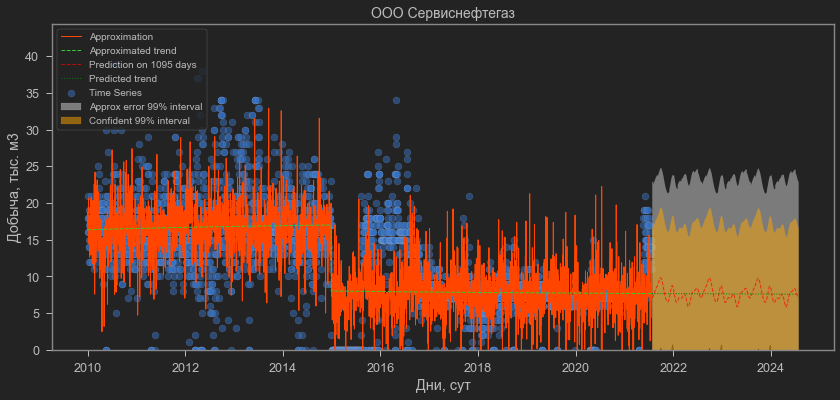

************************************************************************************************************************
The field "Kаневско-Лебяжье ГКМ"
Change points: [2017.3 2019.3]
Fourier function of 8-th order
R2=0.564; MAE=6.84 (mean_y=82.86); RMSE=10.24


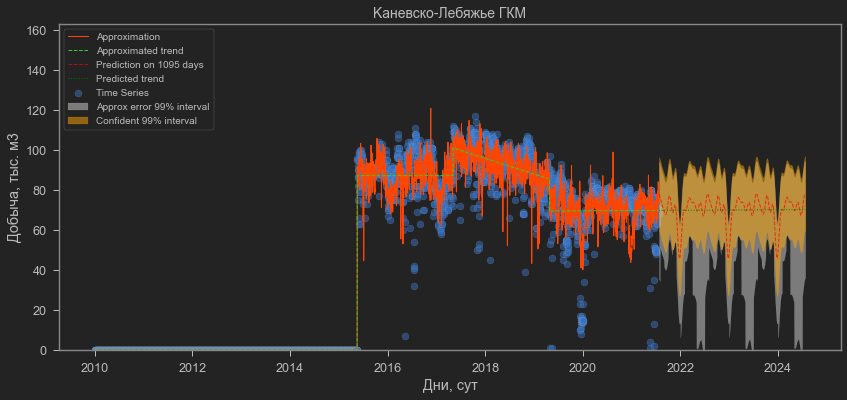

************************************************************************************************************************
The field "Челбасское ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.154; MAE=2.21 (mean_y=53.67); RMSE=4.99


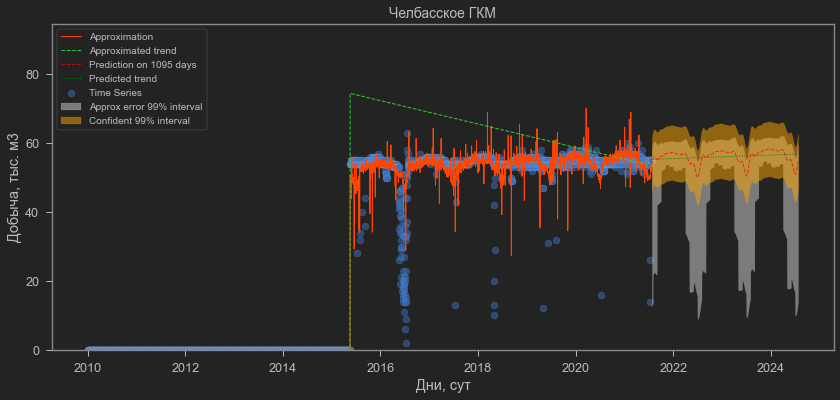

************************************************************************************************************************
The field "Бейсугское ГМ"
Change points: [2015.8 2018.8]
Fourier function of 8-th order
R2=0.91; MAE=4.24 (mean_y=87.52); RMSE=9.19


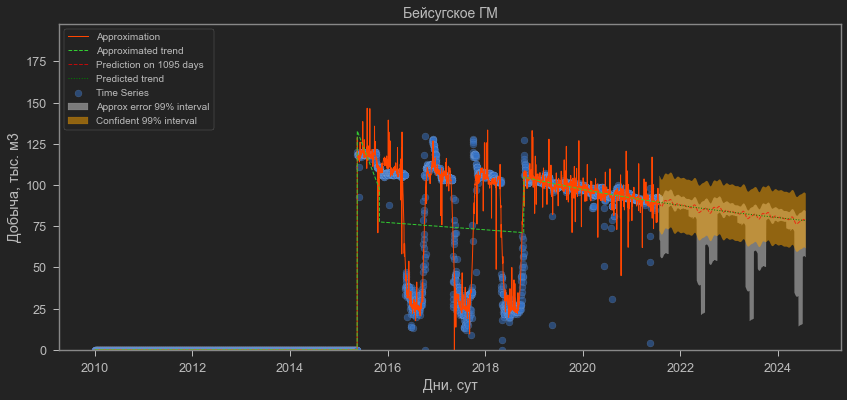

************************************************************************************************************************
The field "Роговское ГМ"
Change points: [2018.5]
Fourier function of 8-th order
R2=0.81; MAE=3.32 (mean_y=59.55); RMSE=4.13


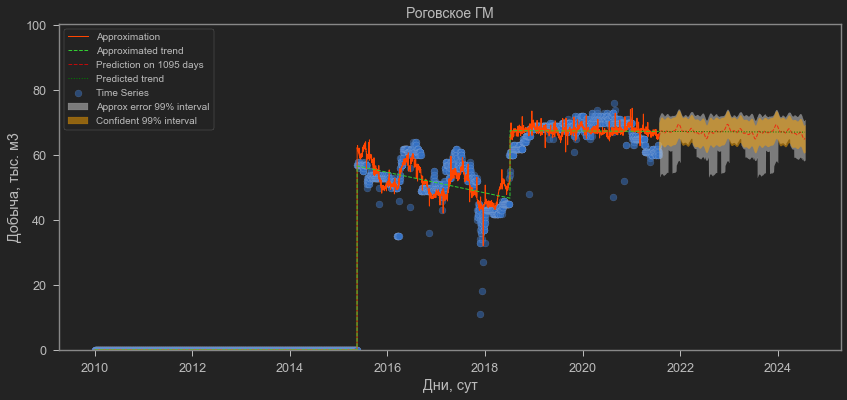

************************************************************************************************************************
The field "Днепровское ГМ"
Change points: [2018.8]
Fourier function of 8-th order
R2=0.979; MAE=1.28 (mean_y=14.83); RMSE=1.79


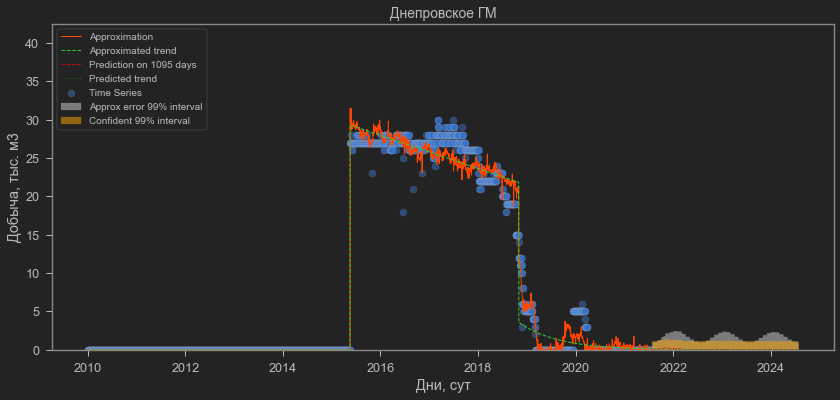

************************************************************************************************************************
The field "Гречаное ГМ"
Change points: [2016.3 2018.5 2020.8]
Fourier function of 8-th order
R2=0.931; MAE=1.6 (mean_y=11.35); RMSE=2.85


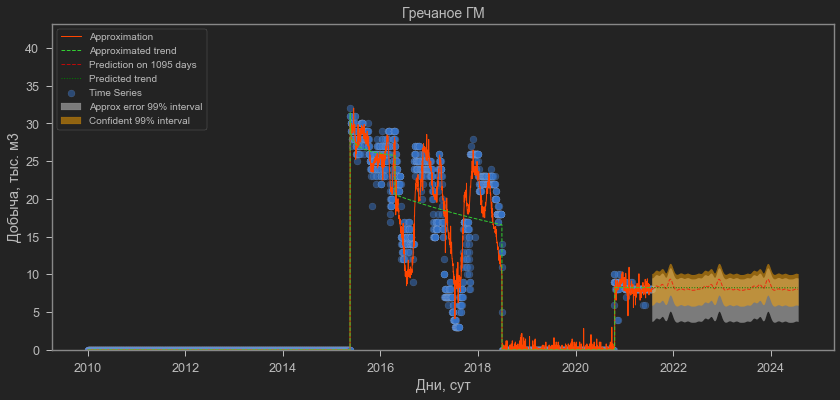

************************************************************************************************************************
The field "Граничное ГКМ"
Change points: [2016.9]
Fourier function of 8-th order
R2=0.905; MAE=1.7 (mean_y=8.35); RMSE=2.48


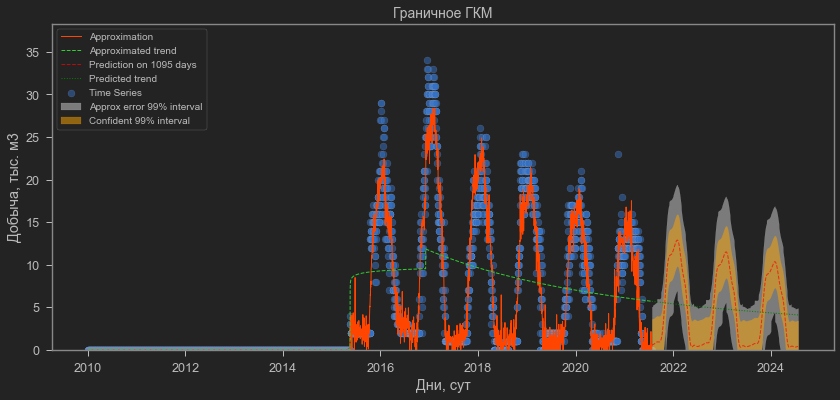

************************************************************************************************************************
The field "Синявское ГМ"
Change points: [2020.]
Fourier function of 8-th order
R2=0.547; MAE=2.26 (mean_y=50.61); RMSE=4.58


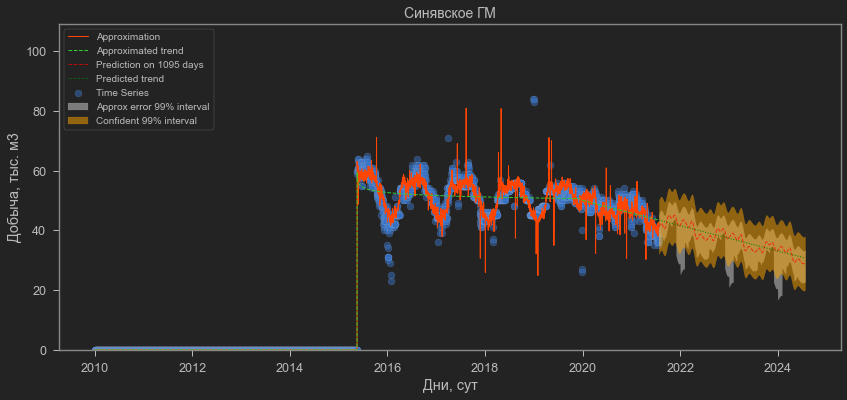

************************************************************************************************************************
The field "Азовское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.887; MAE=11.59 (mean_y=143.86); RMSE=16.55


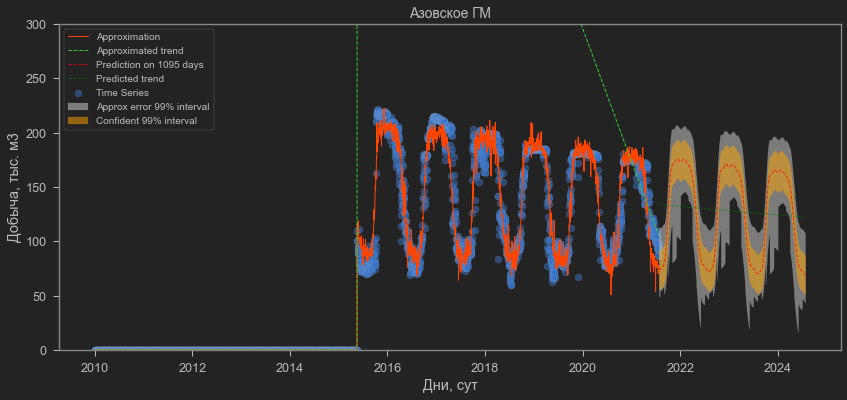

************************************************************************************************************************
The field "Патроновское ГКМ"
Change points: [2018.8 2019.3 2020.4]
Fourier function of 8-th order
R2=0.802; MAE=2.86 (mean_y=22.88); RMSE=4.09


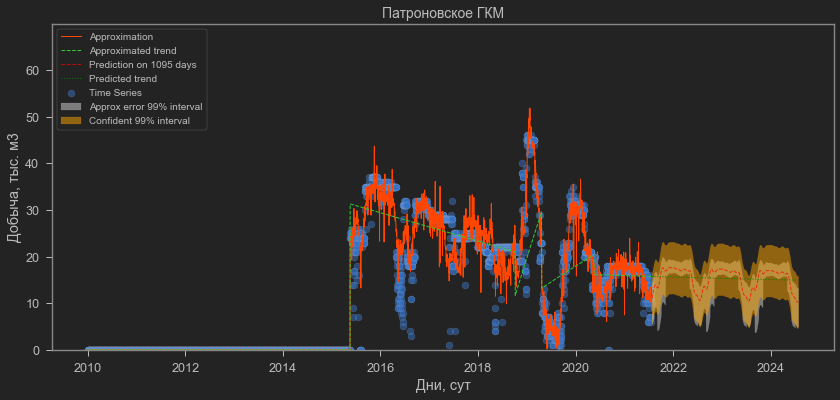

************************************************************************************************************************
The field "Марковское ГКМ"
Change points: [2018.3]
Fourier function of 8-th order
R2=0.872; MAE=22.02 (mean_y=417.02); RMSE=31.07


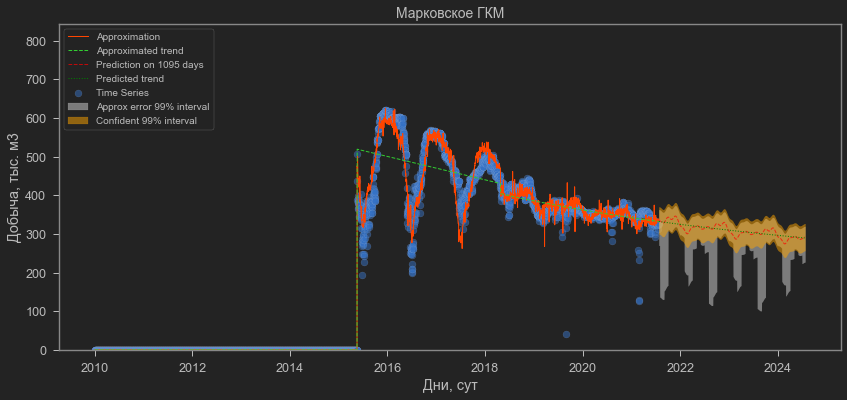

************************************************************************************************************************
The field "Элитное ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.148; MAE=3.05 (mean_y=8.35); RMSE=4.25


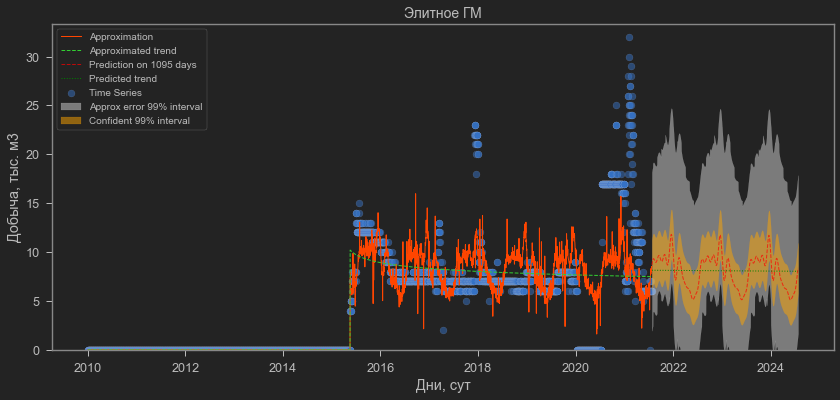

************************************************************************************************************************
The field "Зап.-Красноармейское ГМ"
Change points: [2017.3 2018.9 2020.5]
Fourier function of 8-th order
Use simple approximation median
R2=0.922; MAE=1.63 (mean_y=23.82); RMSE=2.13


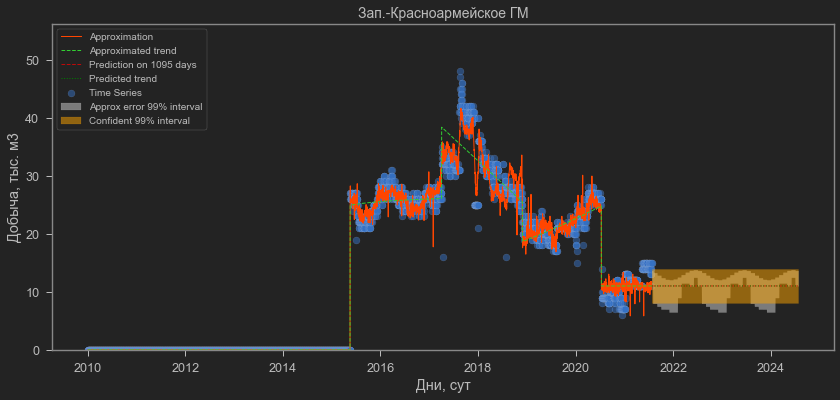

************************************************************************************************************************
The field "Красноармейское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.785; MAE=6.15 (mean_y=33.42); RMSE=7.64


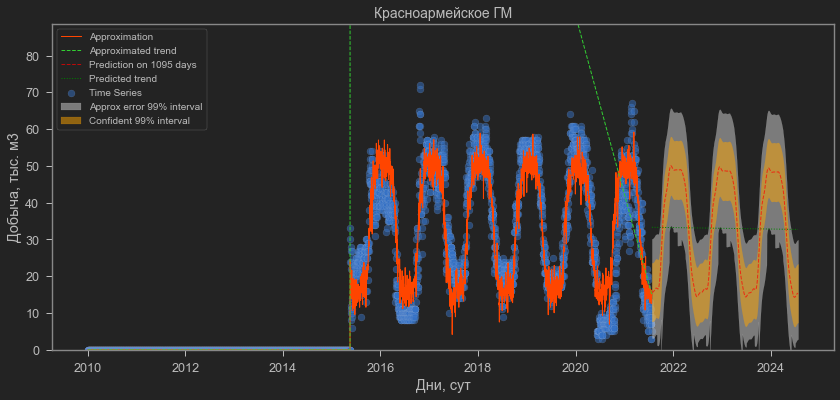

************************************************************************************************************************
The field "Лебединское ГМ"
Change points: [2017.3 2018.9]
Fourier function of 8-th order
R2=0.944; MAE=0.59 (mean_y=3.53); RMSE=1.12


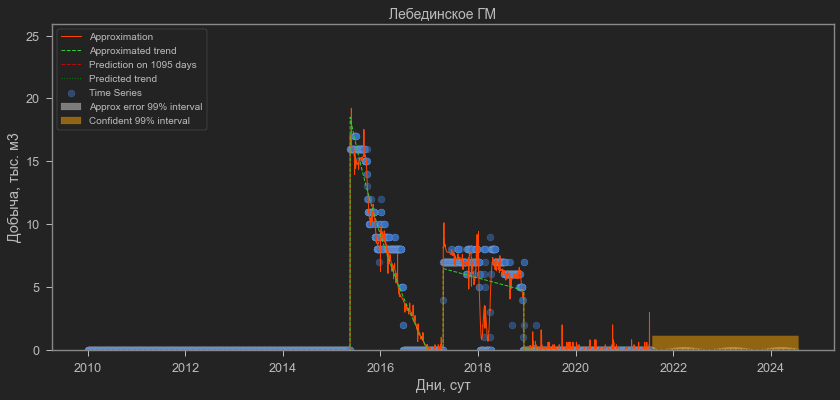

************************************************************************************************************************
The field "Сев.-Чебургольское ГМ"
Change points: [2017.3]
Fourier function of 8-th order
R2=0.232; MAE=0.85 (mean_y=12.6); RMSE=1.29


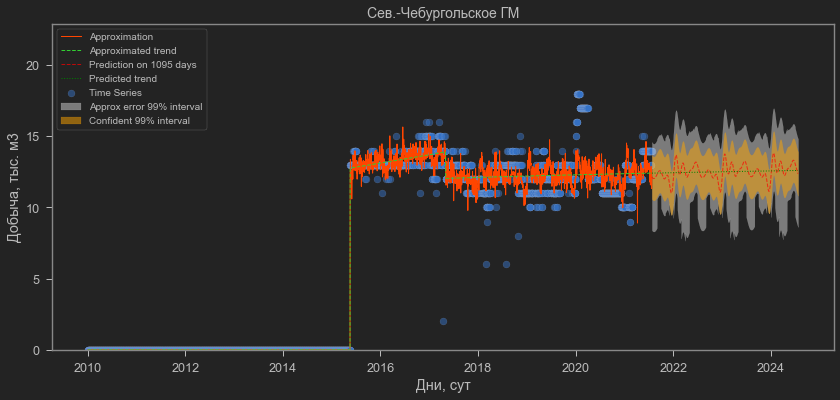

************************************************************************************************************************
The field "Пригибское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


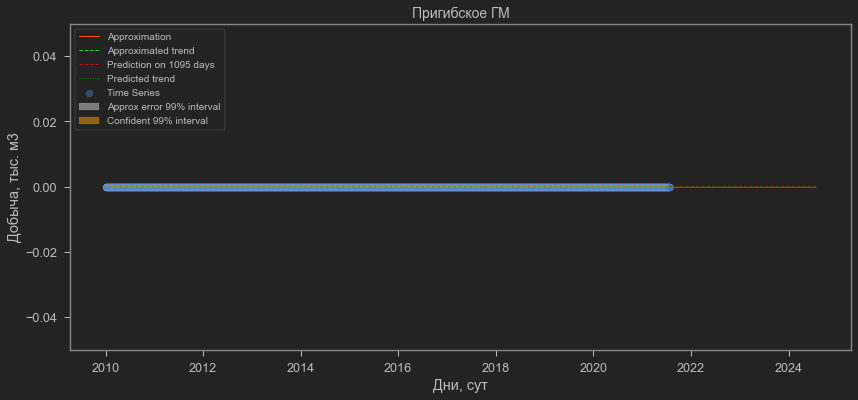

************************************************************************************************************************
The field "Гривенское ГМ"
Change points: [2017.  2019.3]
Fourier function of 8-th order
R2=0.972; MAE=2.56 (mean_y=66.12); RMSE=3.71


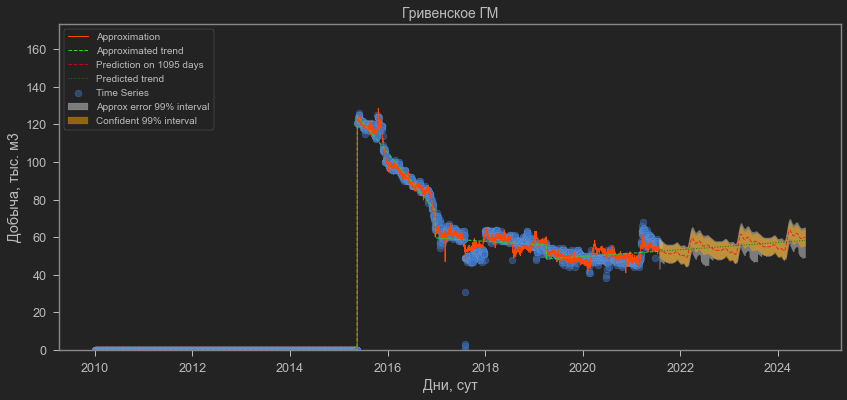

************************************************************************************************************************
The field "Южно-Гривенское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


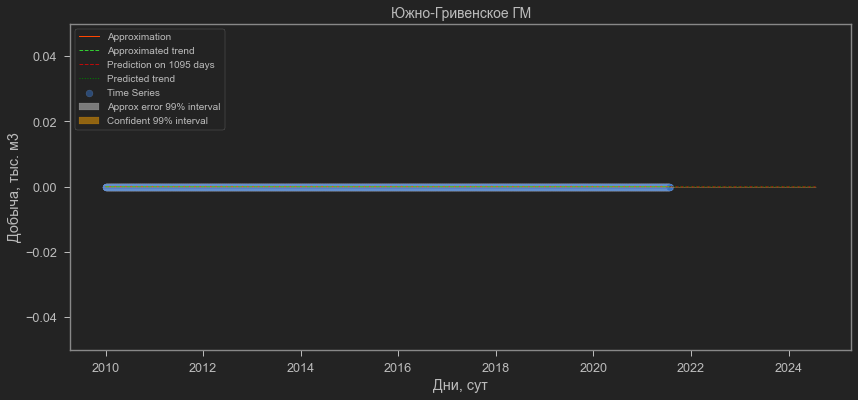

************************************************************************************************************************
The field "Петровское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.886; MAE=2.52 (mean_y=8.17); RMSE=9.76


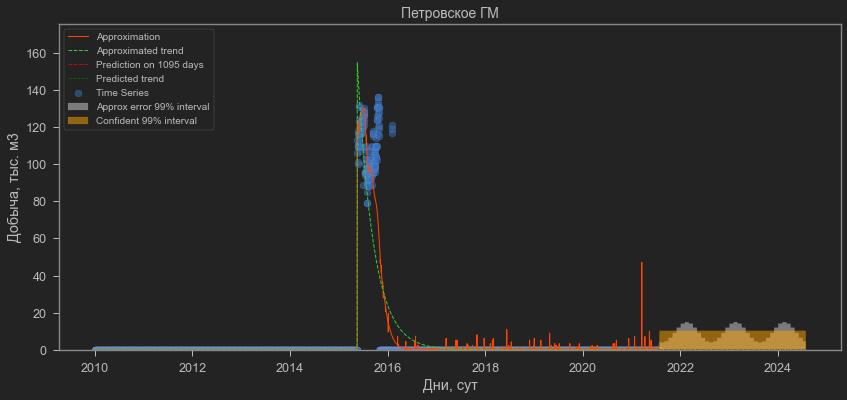

************************************************************************************************************************
The field "Сев.-Гривенское ГМ"
Change points: [2017.1]
Fourier function of 8-th order
R2=0.921; MAE=1.71 (mean_y=44.44); RMSE=2.66


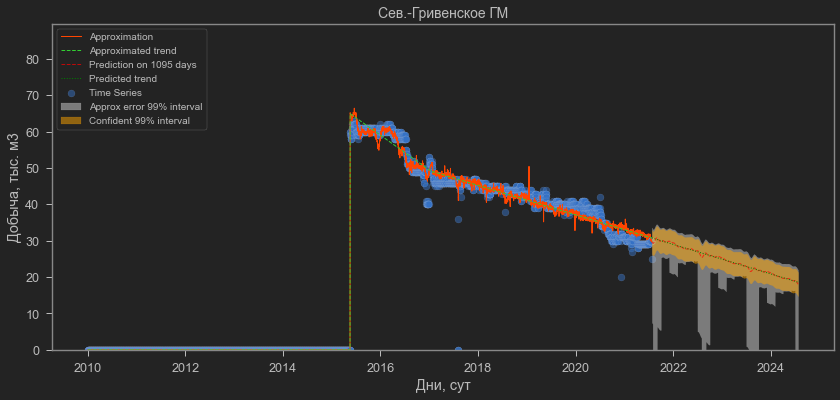

************************************************************************************************************************
The field "Мостовянское ГМ"
Change points: [2018.4]
Fourier function of 8-th order
R2=0.757; MAE=0.5 (mean_y=11.74); RMSE=0.8


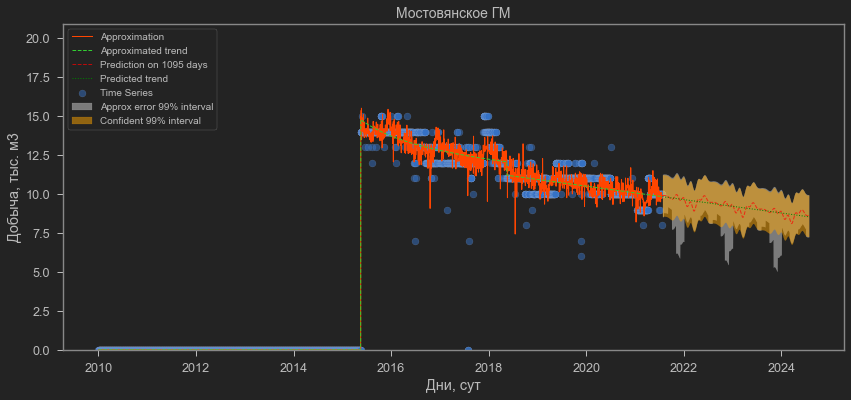

************************************************************************************************************************
The field "Мечетское ГМ"
Change points: [2017.4]
Fourier function of 8-th order
R2=0.94; MAE=3.67 (mean_y=50.22); RMSE=4.94


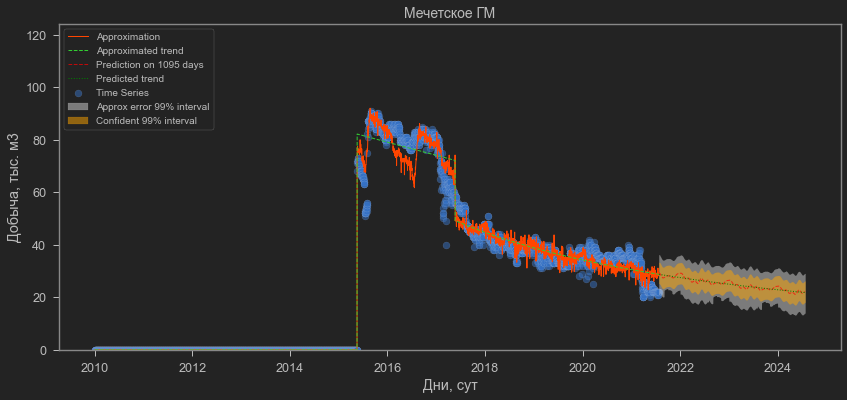

************************************************************************************************************************
The field "Некрасовское ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


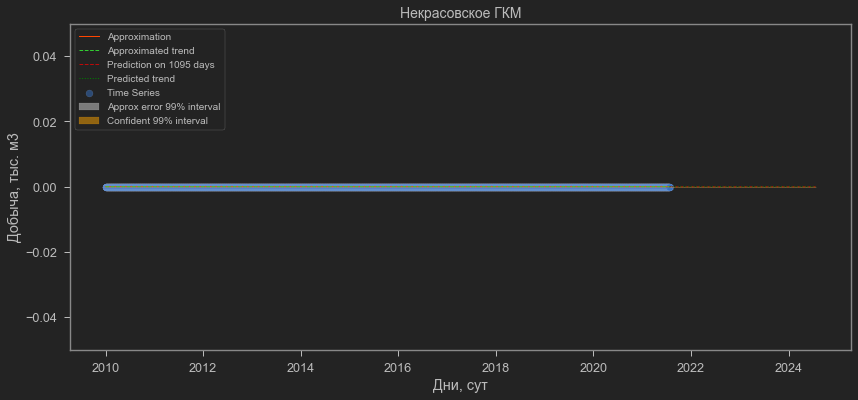

************************************************************************************************************************
The field "Ладожское ГКМ"
Change points: [2020.]
Fourier function of 8-th order
R2=0.951; MAE=0.56 (mean_y=6.03); RMSE=0.77


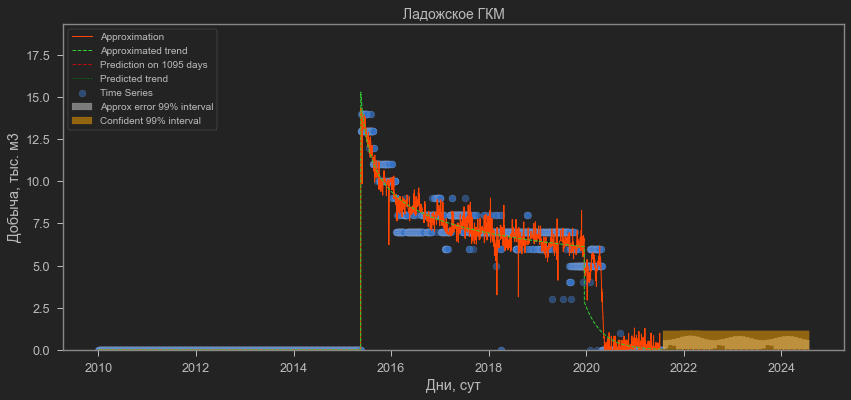

************************************************************************************************************************
The field "Юбилейное ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


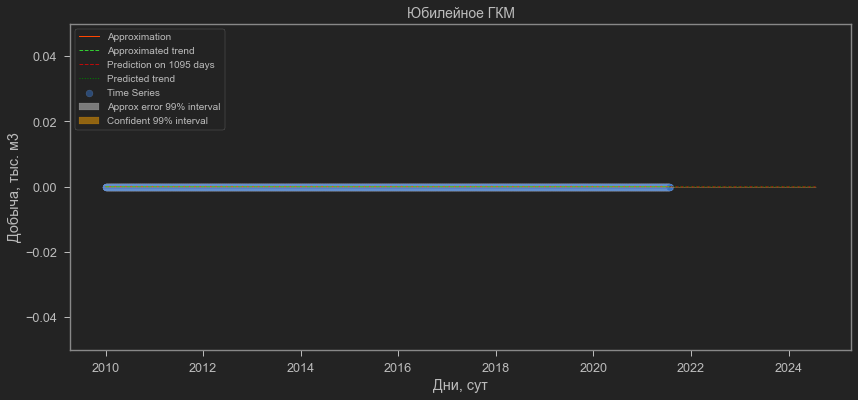

************************************************************************************************************************
The field "Майкопское ГКМ"
Change points: [2017.6]
Fourier function of 8-th order
R2=0.718; MAE=1.23 (mean_y=10.98); RMSE=1.97


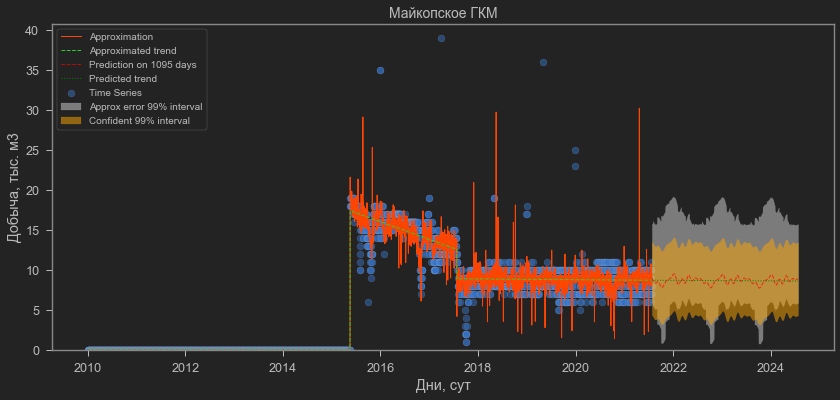

************************************************************************************************************************
The field "Прибрежное НГКМ"
Change points: [2017.  2019.4]
Fourier function of 8-th order
R2=0.958; MAE=3.12 (mean_y=31.15); RMSE=4.13


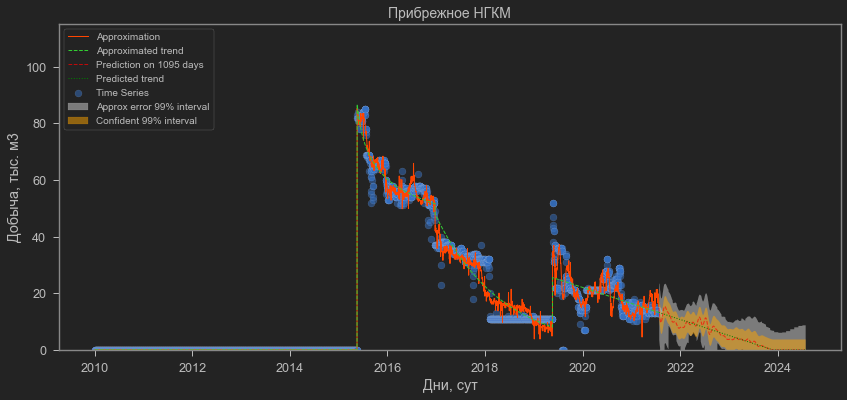

************************************************************************************************************************
The field "Вост.-Прибрежное НГКМ"
Change points: [2019.]
Fourier function of 8-th order
R2=0.916; MAE=5.6 (mean_y=109.32); RMSE=8.33


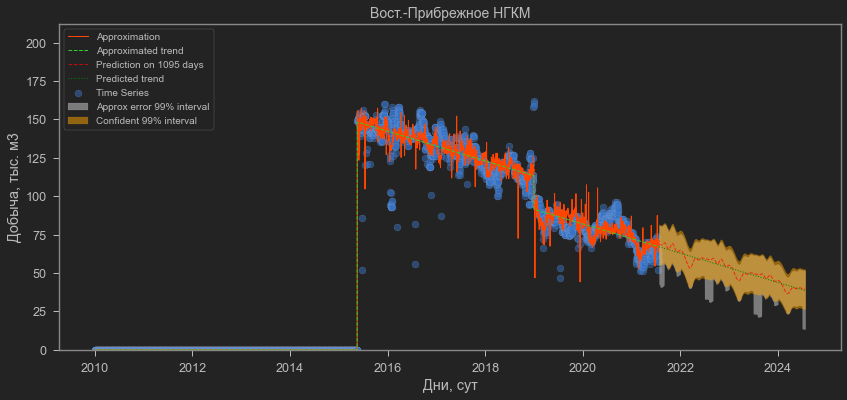

************************************************************************************************************************
The field "Сев.-Прибрежное НГКМ"
Change points: [2016.1 2019.3]
Fourier function of 8-th order
R2=0.77; MAE=0.48 (mean_y=2.9); RMSE=0.69


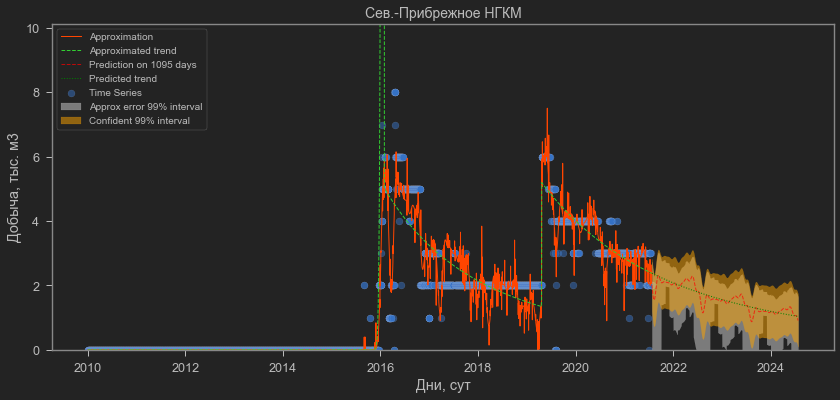

************************************************************************************************************************
The field "Ю.Черноерковск.НГКМ"
Change points: [2019.7]
Fourier function of 8-th order
R2=0.308; MAE=0.9 (mean_y=0.89); RMSE=1.59


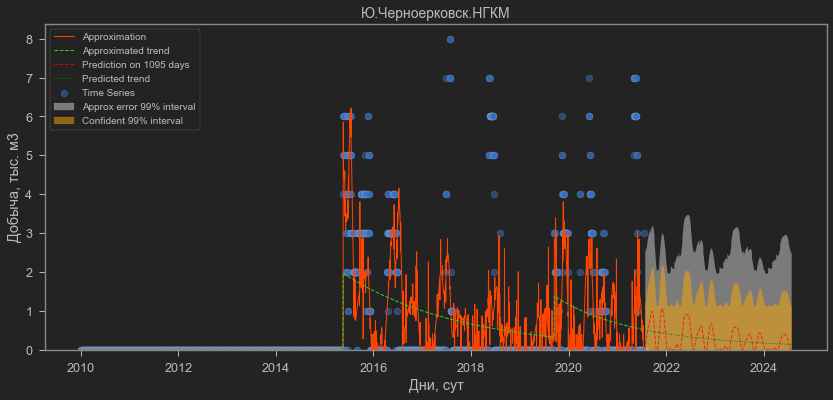

************************************************************************************************************************
The field "Мирненское ГКМ"
Change points: [2017.]
Fourier function of 8-th order
R2=0.324; MAE=4.71 (mean_y=66.56); RMSE=5.93


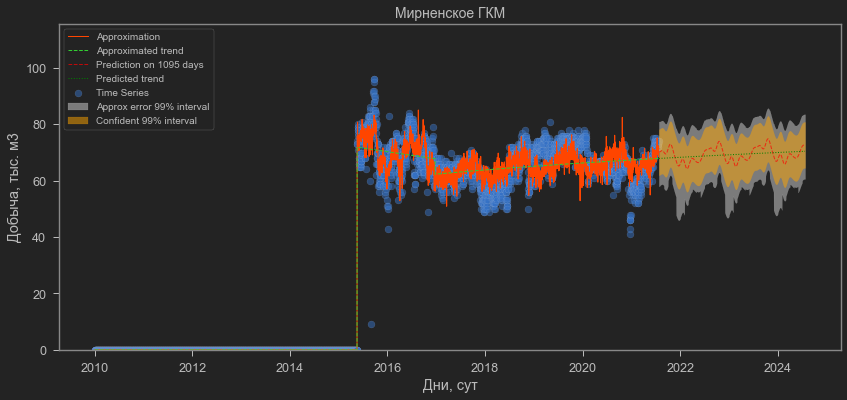

************************************************************************************************************************
The field "Журавское ГМ"
Change points: [2017.2 2019. ]
Fourier function of 8-th order
R2=0.593; MAE=0.57 (mean_y=2.99); RMSE=0.78


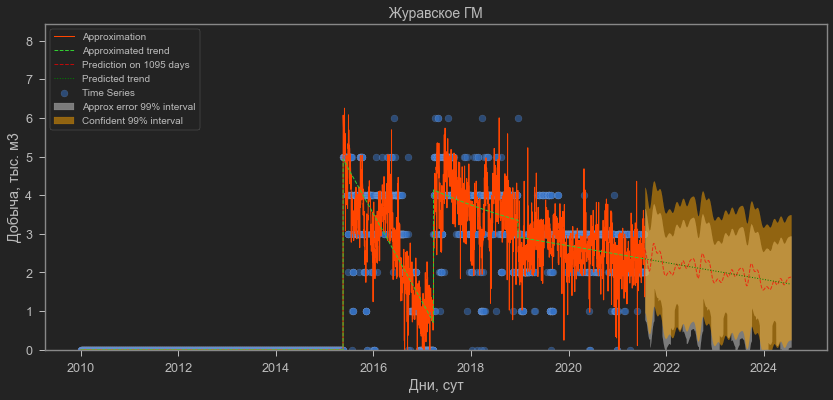

************************************************************************************************************************
The field "Каменно-Балковское ГМ"
Change points: [2018.3 2019.9]
Fourier function of 8-th order
R2=0.845; MAE=0.75 (mean_y=36.82); RMSE=1.48


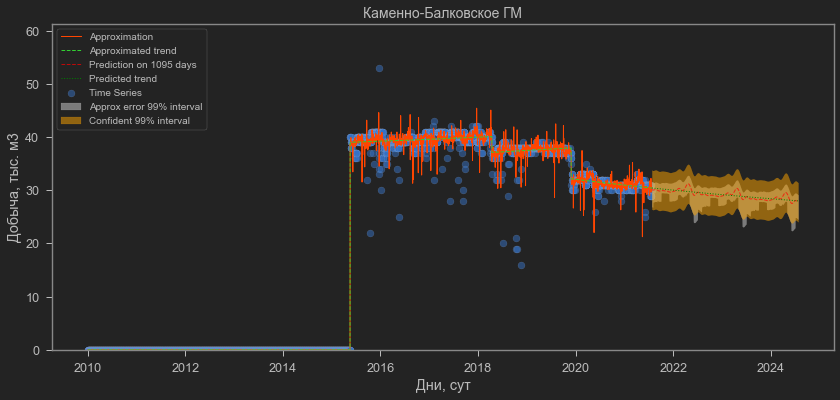

************************************************************************************************************************
The field "Петр.-Благодар.ГМ"
Change points: [2019.]
Fourier function of 8-th order
R2=0.358; MAE=7.83 (mean_y=115.37); RMSE=11.08


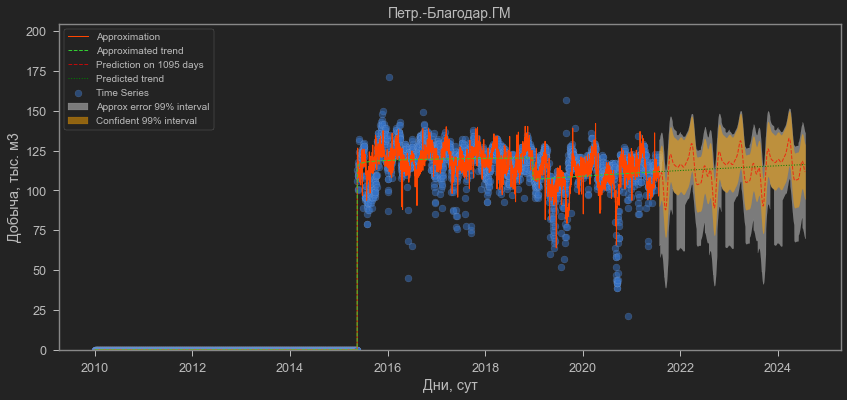

************************************************************************************************************************
The field "Кугутское ГМ"
Change points: [2019.3]
Fourier function of 8-th order
R2=0.59; MAE=4.29 (mean_y=36.64); RMSE=5.75


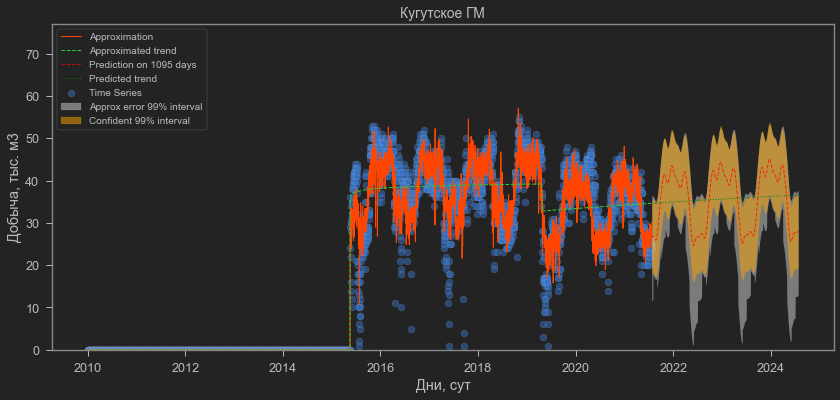

************************************************************************************************************************
The field "Казино - Грач. ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.0796; MAE=0.0 (mean_y=0.0); RMSE=0.07


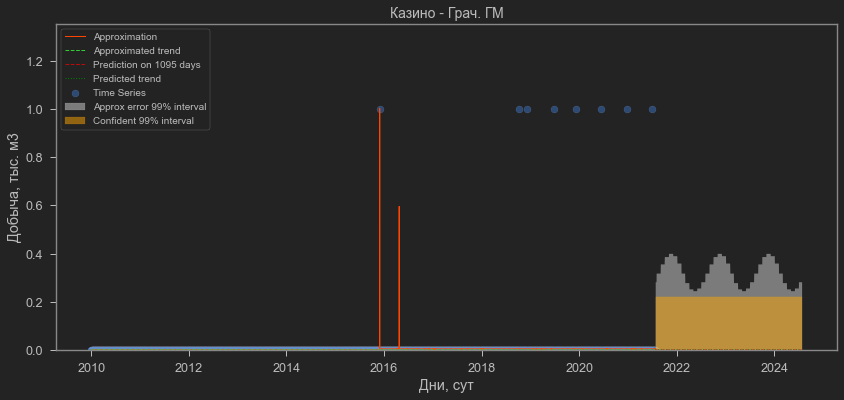

************************************************************************************************************************
The field "Вост.-Арзгирское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


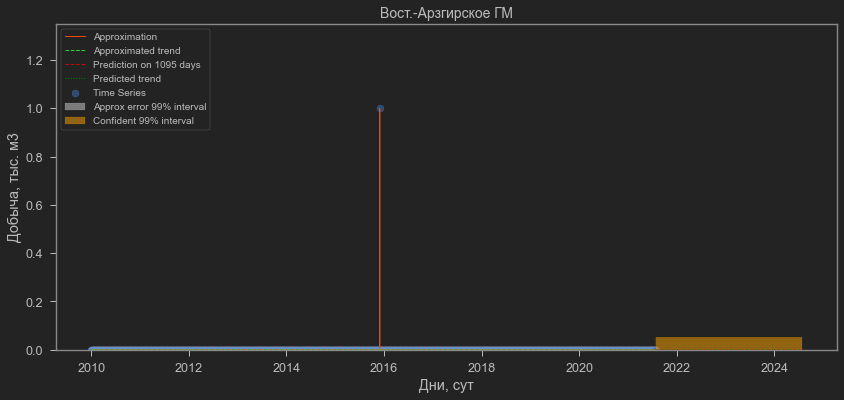

************************************************************************************************************************
The field "Безопасненское ГМ"
Change points: [2018.4]
Fourier function of 8-th order
R2=0.369; MAE=0.54 (mean_y=8.48); RMSE=0.91


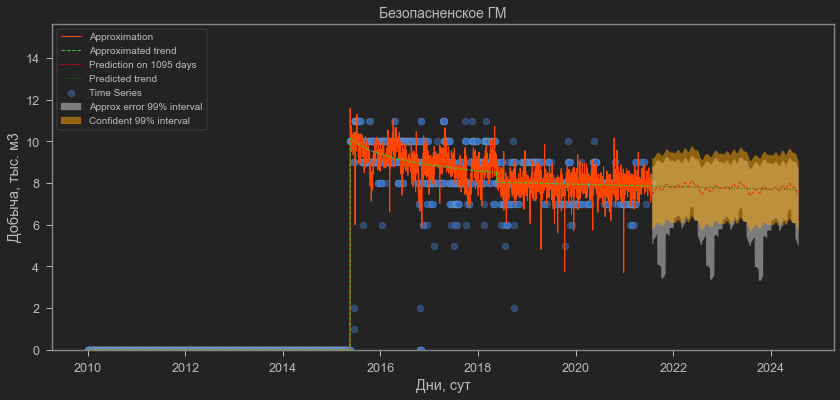

************************************************************************************************************************
The field "Тахта-Кугультинское ГМ"
Change points: [2019.4]
Fourier function of 8-th order
R2=0.454; MAE=6.13 (mean_y=180.85); RMSE=11.21


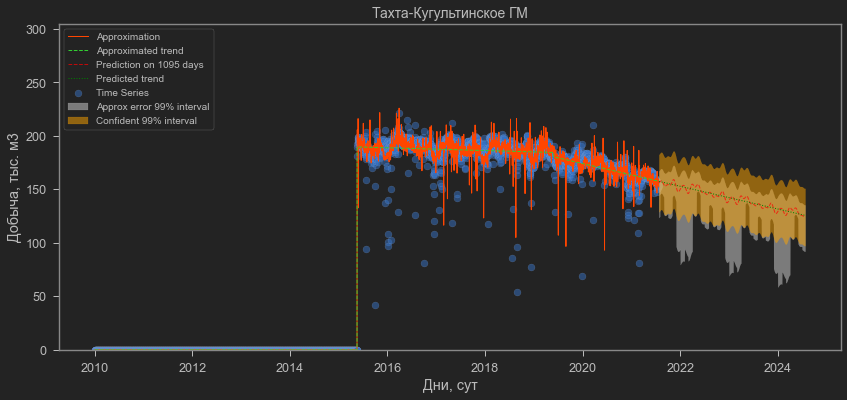

************************************************************************************************************************
The field "Радыковское ГМ"
Change points: [2017.1]
Fourier function of 8-th order
R2=0.516; MAE=0.75 (mean_y=13.74); RMSE=1.17


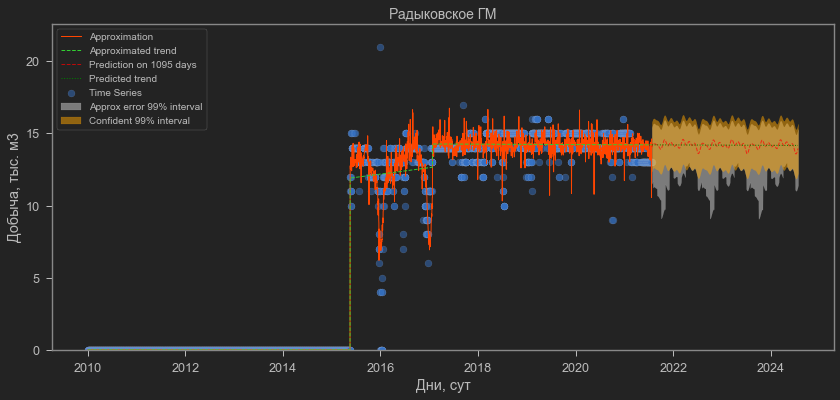

************************************************************************************************************************
The field "Южно-Радыковское ГМ"
Change points: [2019.8]
Fourier function of 8-th order
R2=0.517; MAE=0.61 (mean_y=7.69); RMSE=0.97


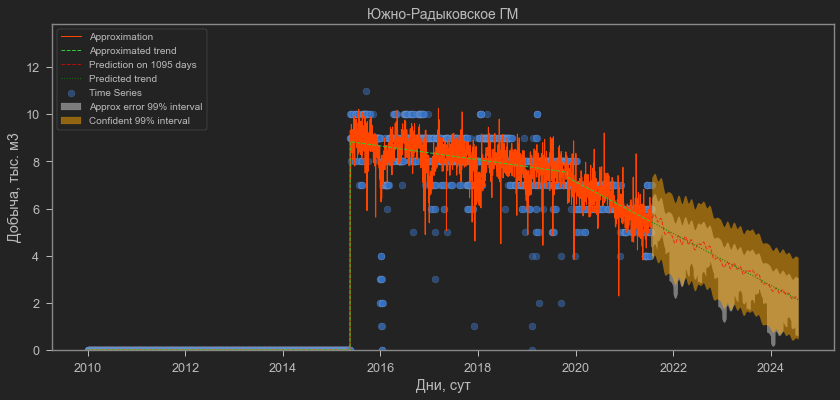

************************************************************************************************************************
The field "Сенгелеевское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.664; MAE=3.31 (mean_y=9.52); RMSE=5.46


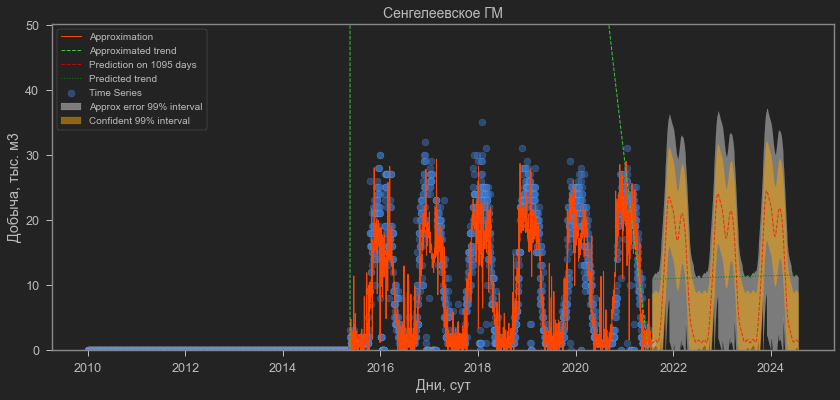

************************************************************************************************************************
The field "Расшеватское ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.419; MAE=3.53 (mean_y=46.98); RMSE=5.32


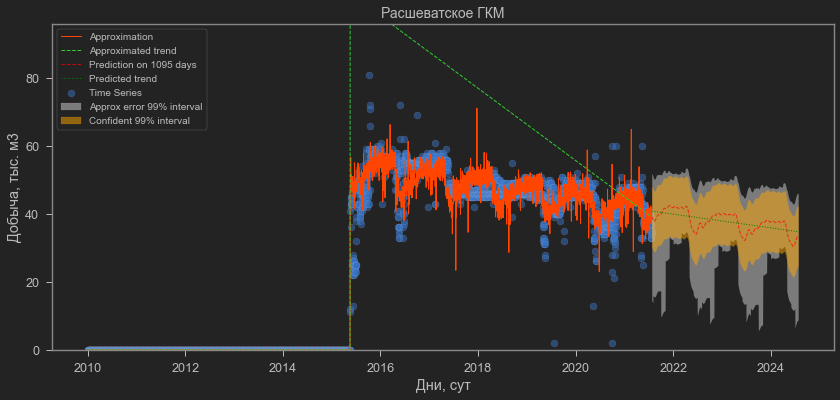

************************************************************************************************************************
The field "Николаевское ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.115; MAE=0.98 (mean_y=39.15); RMSE=1.52


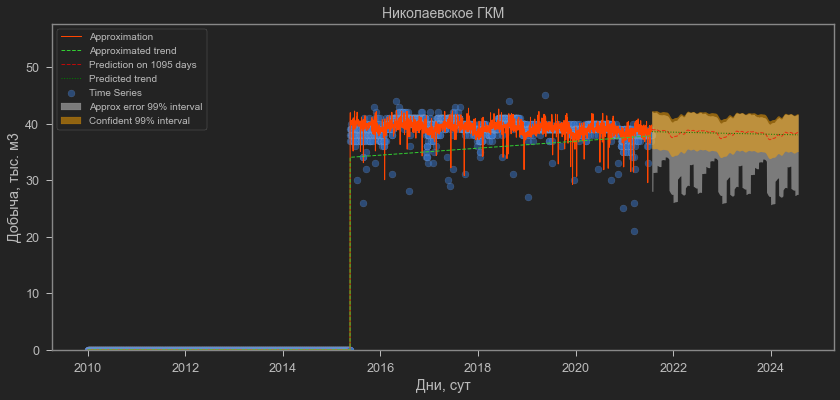

************************************************************************************************************************
The field "Ильинское ГКМ"
Change points: [2019.7]
Fourier function of 8-th order
R2=0.895; MAE=0.24 (mean_y=11.94); RMSE=0.44


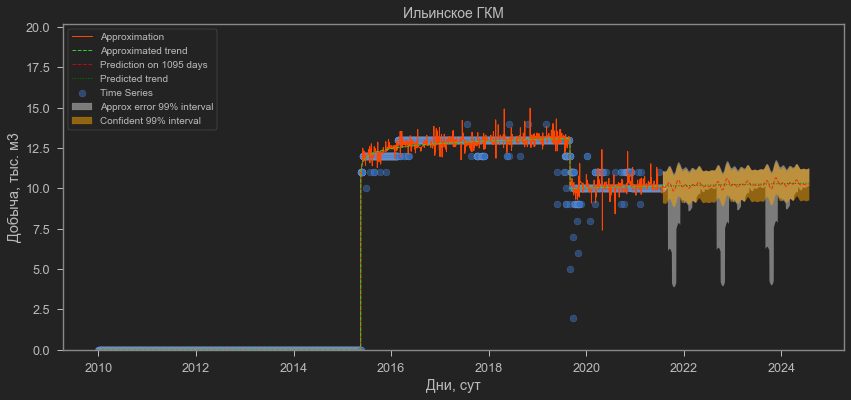

************************************************************************************************************************
The field "Вуктыльское"
Change points: [2019.9]
Fourier function of 8-th order
R2=0.808; MAE=142.8 (mean_y=5184.06); RMSE=208.87


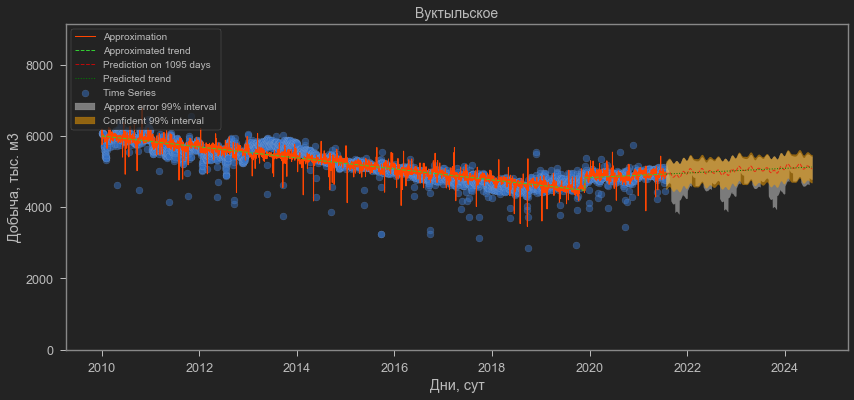

************************************************************************************************************************
The field "Зап.Соплесское"
Change points: [nan]
Fourier function of 8-th order
R2=0.706; MAE=14.9 (mean_y=227.13); RMSE=20.88


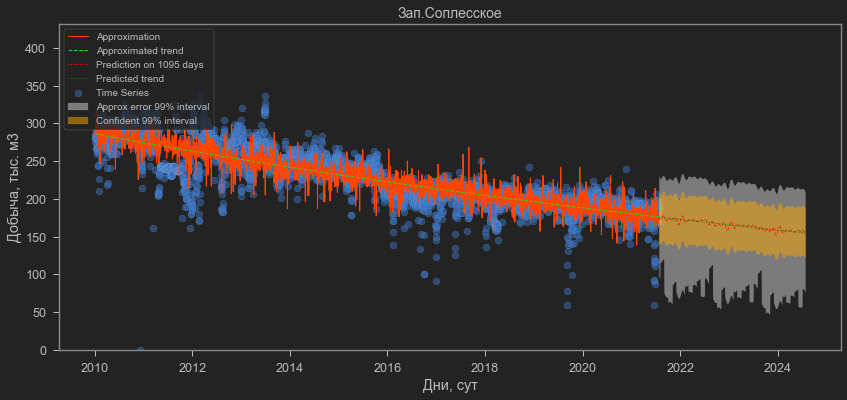

************************************************************************************************************************
The field "Югидское"
Change points: [2014.9 2017.2 2018.9]
Fourier function of 8-th order
R2=0.94; MAE=12.38 (mean_y=220.57); RMSE=16.57


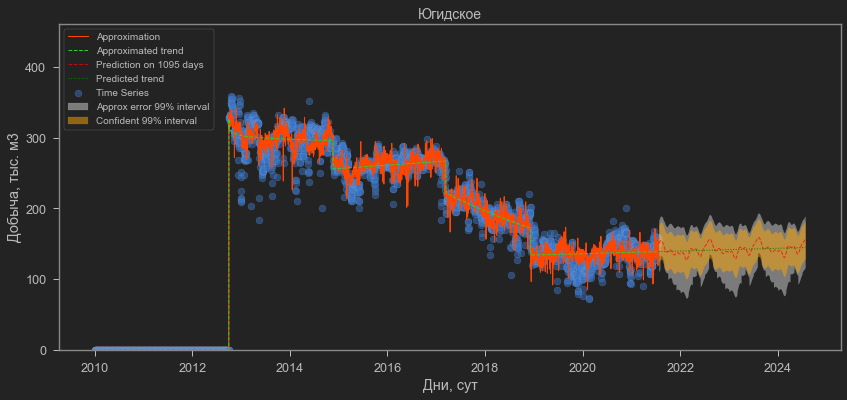

************************************************************************************************************************
The field "Печерокожвинское"
Change points: [nan]
Fourier function of 8-th order
R2=0.0543; MAE=16.6 (mean_y=240.32); RMSE=26.86


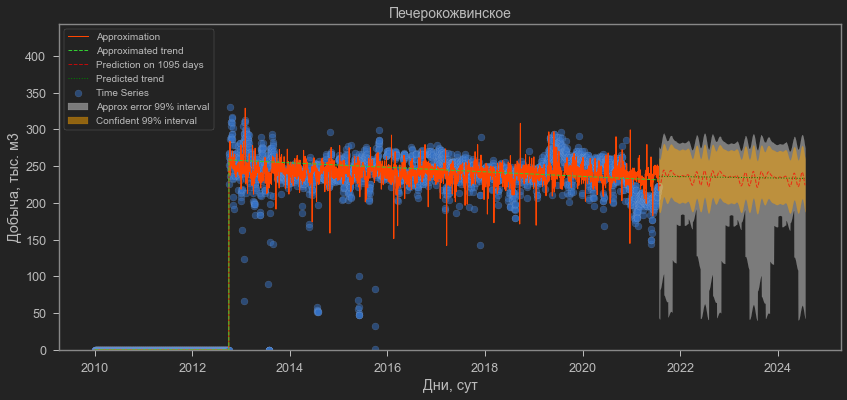

************************************************************************************************************************
The field "ЗАО ПечораНГП"
Change points: [2012.3 2015.  2015.1 2016.4 2016.8]
Fourier function of 8-th order
R2=0.917; MAE=27.19 (mean_y=324.49); RMSE=45.0


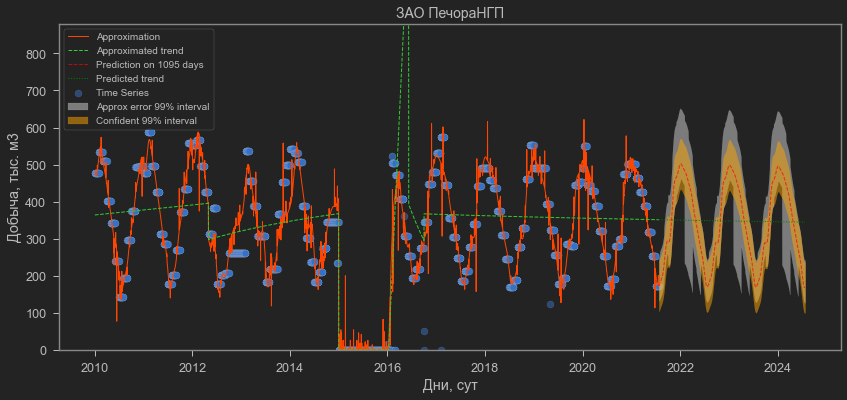

************************************************************************************************************************
The field "ПАО ГПН"
Change points: [2018.5]
Fourier function of 8-th order
R2=0.959; MAE=2466.58 (mean_y=37416.94); RMSE=3358.65


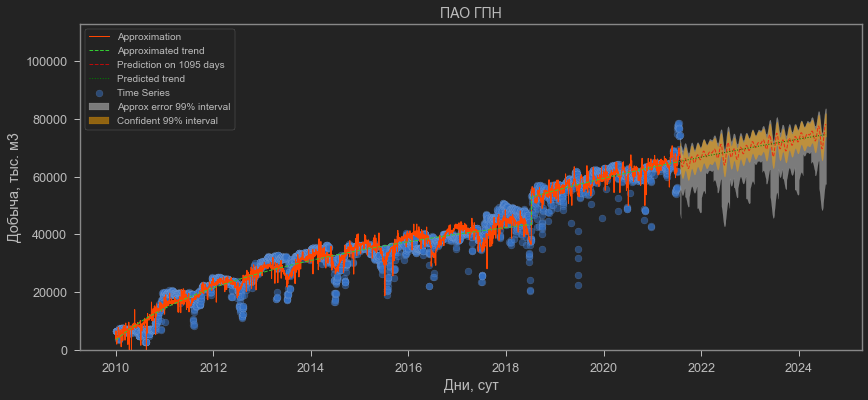

************************************************************************************************************************
The field "ГП ТГ Югорск"
Change points: [nan]
Fourier function of 8-th order
R2=0.902; MAE=11.31 (mean_y=82.64); RMSE=14.75


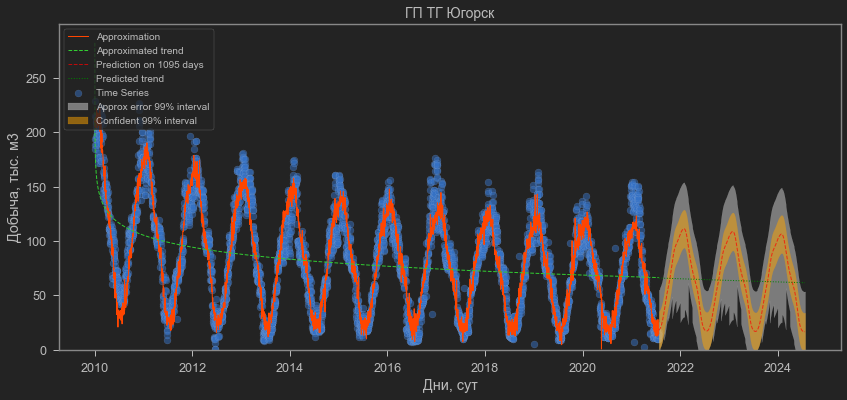

************************************************************************************************************************
The field "ОАО ГП ГР Элиста"
Change points: [2011.7]
Fourier function of 8-th order
R2=0.938; MAE=14.51 (mean_y=108.98); RMSE=20.6


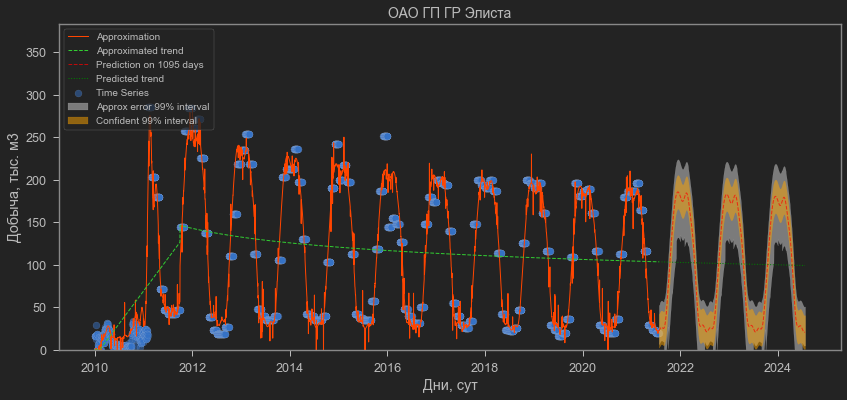

************************************************************************************************************************
The field "ЗАО Нортгаз (ГП 50%)"
Change points: [2011.7 2013.8 2015.5]
Fourier function of 8-th order
R2=0.936; MAE=936.87 (mean_y=18778.17); RMSE=1975.29


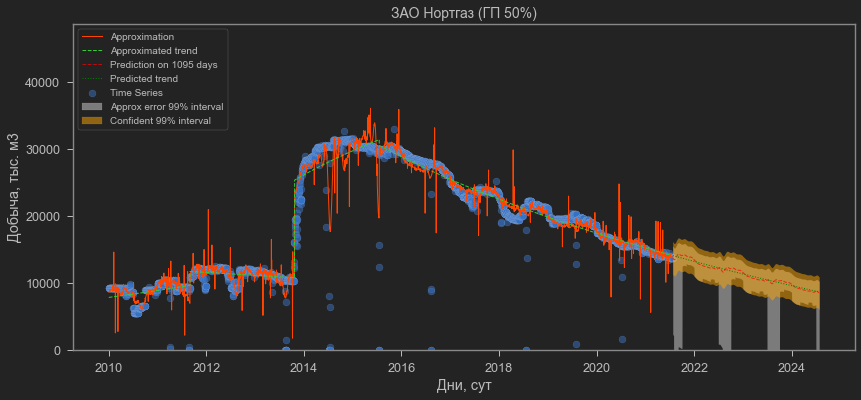

************************************************************************************************************************
The field "ОАО НГК Славнефть (ГП 50%)"
Change points: [2014.7 2020. ]
Fourier function of 8-th order
R2=0.734; MAE=149.95 (mean_y=2293.73); RMSE=255.54


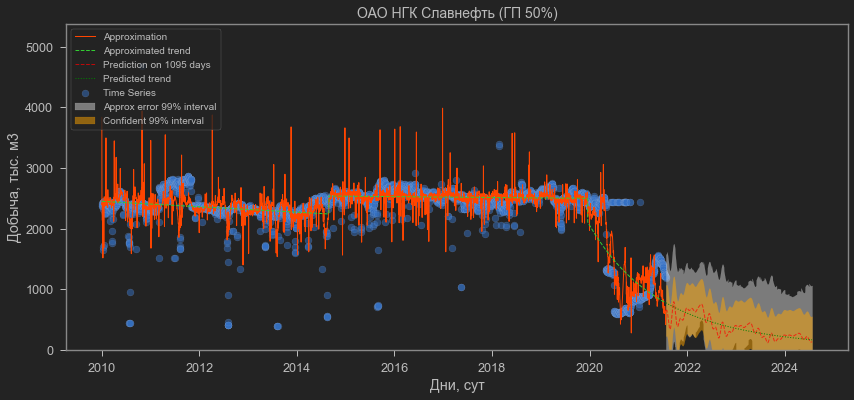

************************************************************************************************************************
The field "АО Арктикгаз (ГП 50%)"
Change points: [2015.  2015.5 2020. ]
Fourier function of 8-th order
R2=0.985; MAE=2122.95 (mean_y=56518.56); RMSE=3540.73


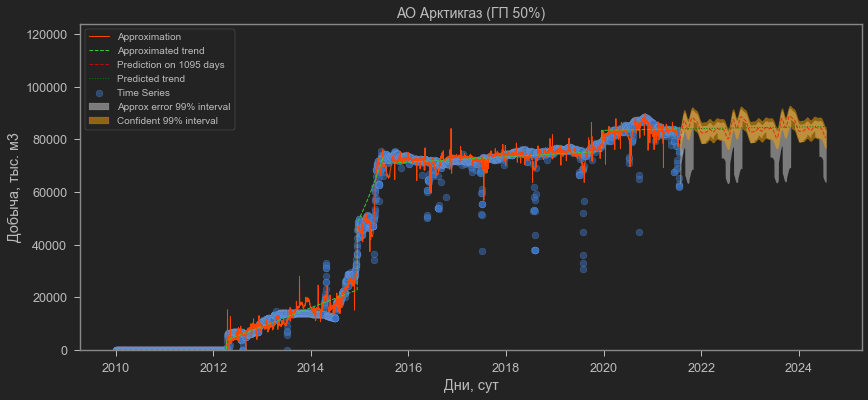

************************************************************************************************************************
The field "ЗАО УралНГП (ГП 37.7%)"
Change points: [nan]
Fourier function of 8-th order
R2=0.464; MAE=67.64 (mean_y=786.39); RMSE=121.56


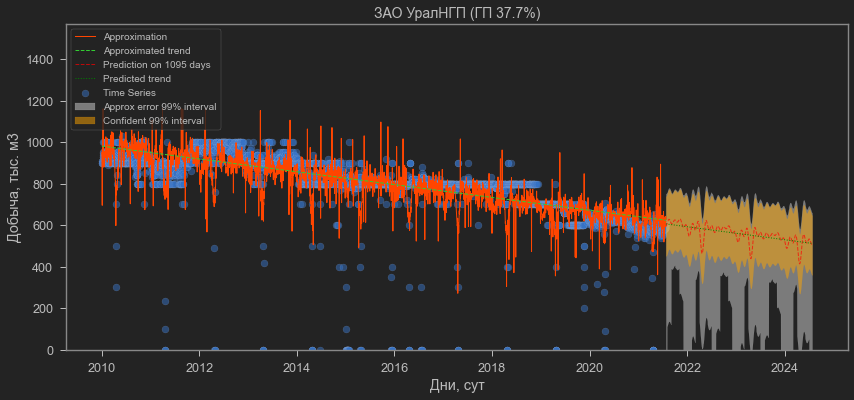

************************************************************************************************************************
The field "ОАО Томскнефть (ГП 50%)"
Change points: [2019.6]
Fourier function of 8-th order
R2=0.449; MAE=585.03 (mean_y=4683.51); RMSE=895.62


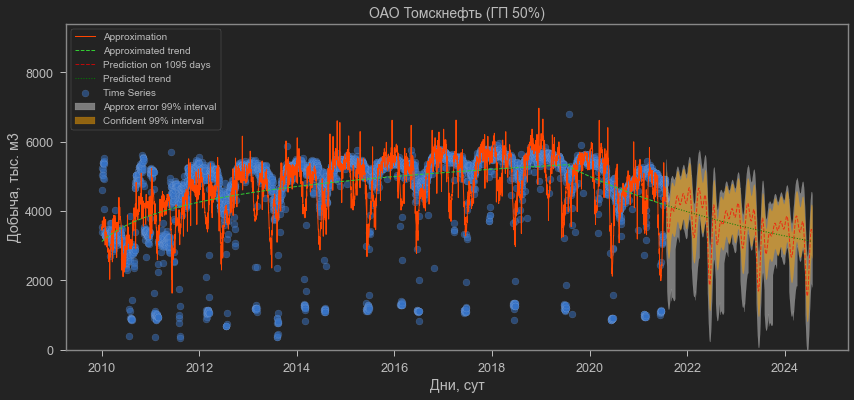

************************************************************************************************************************
The field "Нефтяные компании"
Change points: [2010.5 2014.3 2019.4]
Fourier function of 8-th order
R2=0.931; MAE=3342.51 (mean_y=76239.69); RMSE=4970.66


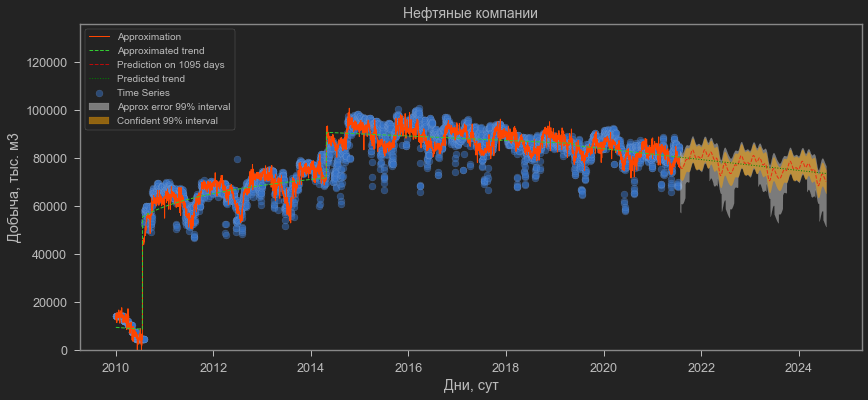

************************************************************************************************************************
The field "Независимые производители"
Change points: [2011.5 2017.5]
Fourier function of 8-th order
R2=0.967; MAE=6105.21 (mean_y=187540.93); RMSE=9035.16


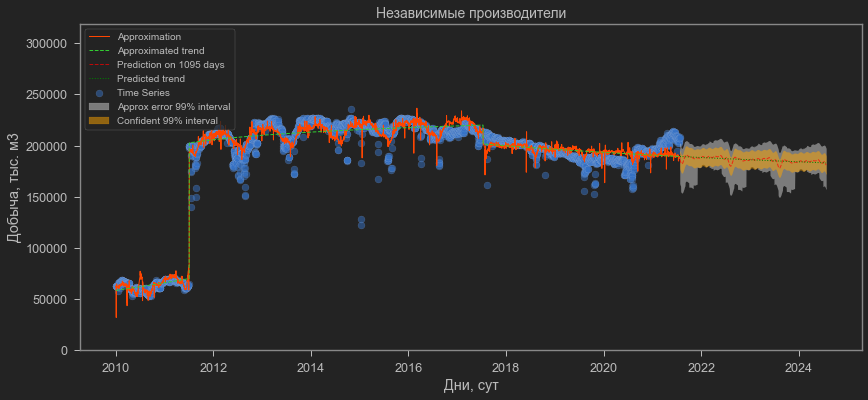

In [63]:
result = pd.DataFrame()
prediction = 365*3
fields = df['Месторождение'].unique()
# fields = ["Сев.-Прибрежное НГКМ"]

for field in fields:
    _result = time_series_approximation(df, field, fourier_order=8, noise_alpha=0.001, noise_window=5, changepoint_cutoff=0.965, prediction=prediction, exceptions=exceptions)
    _result['Месторождение'] = field
    _result['Месторождение'] = field
    _result['Предприятие'] = df.loc[df['Месторождение'] == field, 'Предприятие'].unique()[0]
    result = pd.concat((result, _result), axis=0)

In [83]:
full_result = pd.merge(result, df[['Дата', 'Месторождение', 'Добыча']], how='left', on=['Месторождение', 'Дата'])
full_result['Residuals'] = full_result['Approximation'] - full_result['Добыча']
full_result['Series_Var'] = full_result['Series_STD'] ** 2

# Save approximation result
full_result.to_csv("approximation_result.csv")

-----

In [15]:
exceptions = {'change_points': {# Improve the history matching by adding new change points
                                'Заполярное': [2735, 3450, 3855],
                                'Ямсовейское': [3200],
                                'Вынгапуровское': [1900],
                                'Еты-Пуровское': [2480],
                                'Комсомольское': [2500],
                                'ЗАО Пургаз (СП)': [2100],
                                'Южно-Русское НГКМ': [3660],
                                'Одесское': [2640, 2870],
                                'Западно-Салымское': [3775],
                                'Бейсугское ГМ': [2130],
                                'Платформа ПА-А': [1300, 2700],
                                'Ямбургское': [2000, 2760],
                                'Медвежье (сеном)': [3540],
                                'Вынгаяхинское': [2490],
                                'Мирное': [3410],
                                'УКПГ-22 (Ачимовка)': [1780, 3850],
                                'УКПГ-31 (Ачимгаз)': [1050],
                                "ОАО МегионНГ": [3750],
                                "ОАО МегионНГГеология": [2785],
                                "Патроновское ГКМ": [3200, 3790],
                                "Зап.-Красноармейское ГМ": [3845],
                                "Казанское": [570],
                                "ОАО НГК Славнефть (Ачим.)": [2900],
                                "Граничное ГКМ": [2530],
                                "ОАО ОбьНГГеология": [1800],
                                "УНГП": [2020],
                                "ООО Сервиснефтегаз": [2020],
                                
                                # Correction of not fitted fields
                                'Харасавэйское': [3820],
                                'Урмано-Арчинская гр.': [3800],
                                'Гречаное ГМ': [2300, 3945],
                                'Ю.Черноерковск.НГКМ': [3545],
                                "Чаяндинское": [4010],
                                "Тазовское (МНГ)": [4159],
                                "Рыбальное": [3445, 4160],
                                "Фонтановское": [3950],
                                "Киринское ГКМ": [1830],
                                "Северо-Булганакское": [3290],
                                },
              'simple_approximation': {# Use simple approximation for series with lack of data
                                       "Тазовское (МНГ)": np.median, 
                                       "Рыбальное": np.median,
                                       "Ен.-Яхинское (ГПН-Зап)": np.median, 
                                       "УКПГ-51 (АчимДевелопмент)": np.median,
                                       "Чаяндинское": np.median,
                                       "УКПГ-НТС": np.median,
                                       "Фонтановское": np.median,
                                       "Киринское ГКМ": np.mean,
                                       "ГПД Шельф": np.median,
                                       "Зап.-Красноармейское ГМ": np.median,
                                      },
              'own_trend': pd.DataFrame(columns=['Дата', 'Собственные нужды', 'Месторождение']),
             }

************************************************************************************************************************
The field "Заполярное"
Change points: [2013.4 2017.5 2018.7]
Fourier function of 8-th order
R2=0.896; MAE=183.43 (mean_y=2279.76); RMSE=240.51


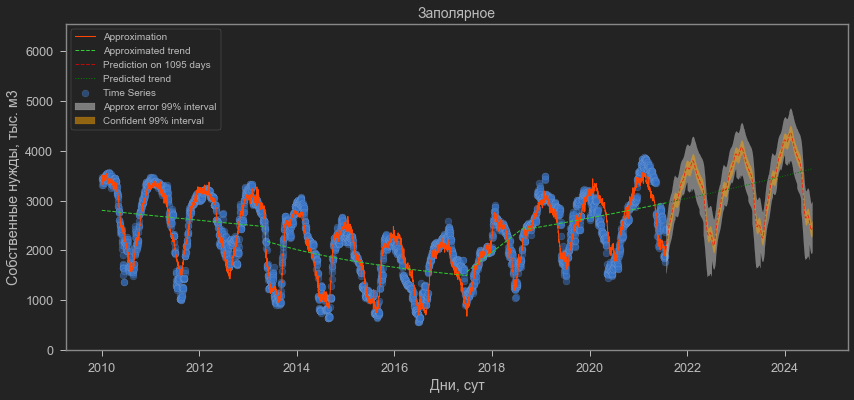

************************************************************************************************************************
The field "Ямбургское"
Change points: [2015.5 2017.6 2018.7]
Fourier function of 8-th order
R2=0.896; MAE=149.74 (mean_y=1685.62); RMSE=215.2


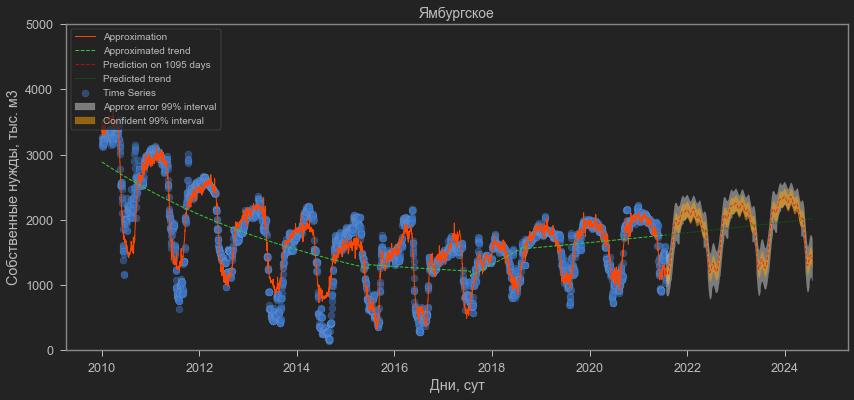

************************************************************************************************************************
The field "Бованенковское"
Change points: [2015.3]
Fourier function of 8-th order
R2=0.929; MAE=257.49 (mean_y=2268.97); RMSE=342.2


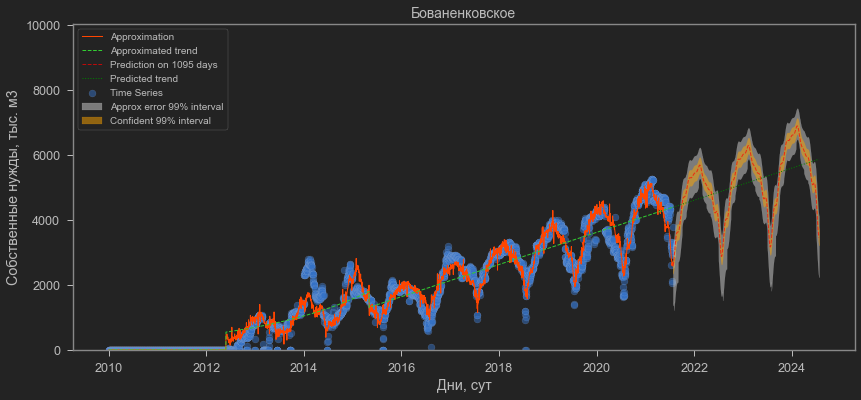

************************************************************************************************************************
The field "Медвежье (сеном)"
Change points: [2012.2 2014.4 2016.8 2019.4 2019.7]
Fourier function of 8-th order
R2=0.916; MAE=29.98 (mean_y=289.34); RMSE=45.82


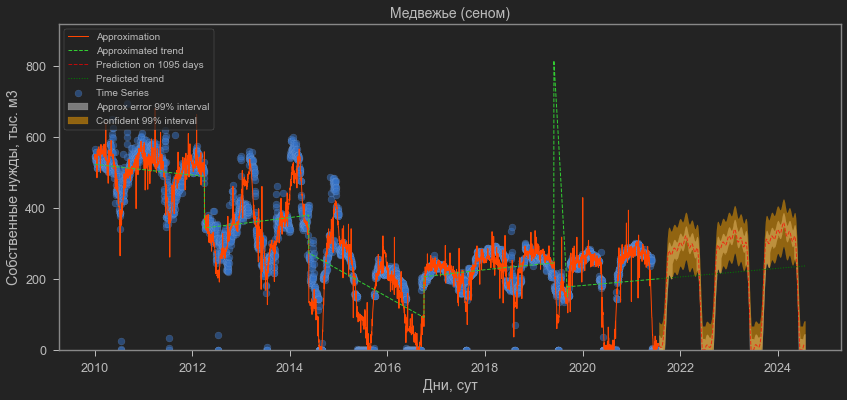

************************************************************************************************************************
The field "УКПГ-НТС"
Change points: [2017.8]
Fourier function of 8-th order
Use simple approximation median
R2=0.493; MAE=4.68 (mean_y=31.12); RMSE=7.38


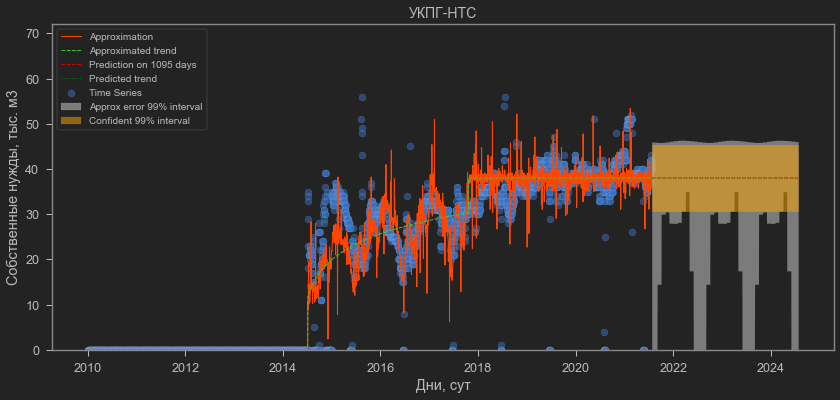

************************************************************************************************************************
The field "УКПГ-Ныда"
Change points: [2014.4 2016.3]
Fourier function of 8-th order
R2=0.745; MAE=6.78 (mean_y=64.69); RMSE=10.95


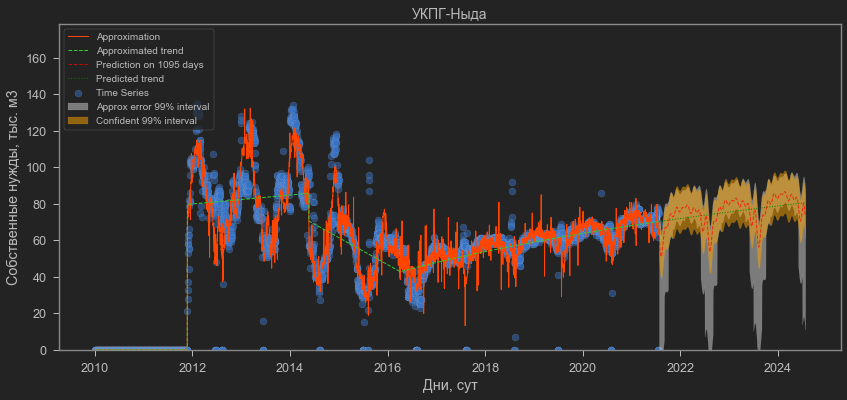

************************************************************************************************************************
The field "Харасавэйское"
Change points: [2015.  2020.5]
Fourier function of 8-th order
R2=0.92; MAE=0.08 (mean_y=0.34); RMSE=0.22


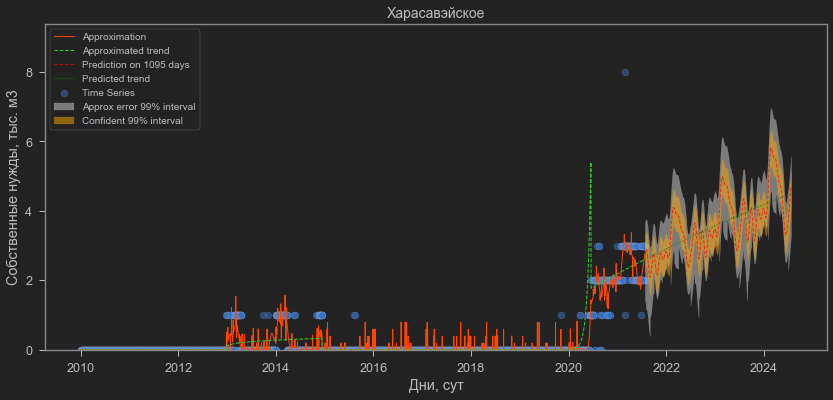

************************************************************************************************************************
The field "Юбилейное (сеном)"
Change points: [2013.3 2016.7]
Fourier function of 8-th order
R2=0.838; MAE=74.2 (mean_y=355.33); RMSE=101.47


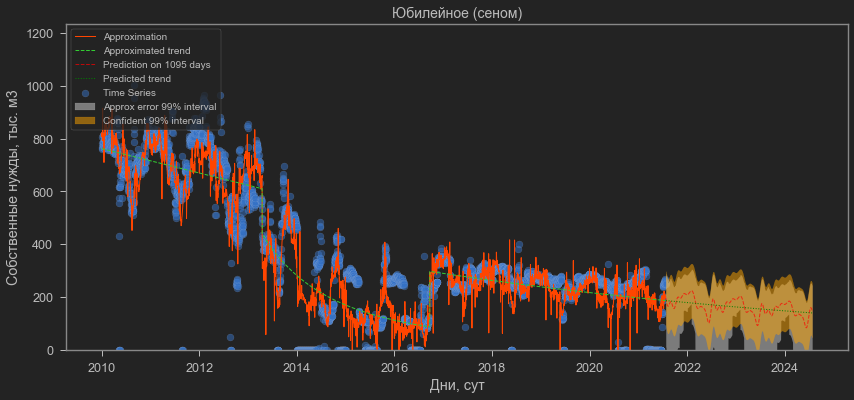

************************************************************************************************************************
The field "Ямсовейское"
Change points: [2012.3 2014.  2016.7 2018.7 2018.8]
Fourier function of 8-th order
R2=0.792; MAE=83.09 (mean_y=520.38); RMSE=125.15


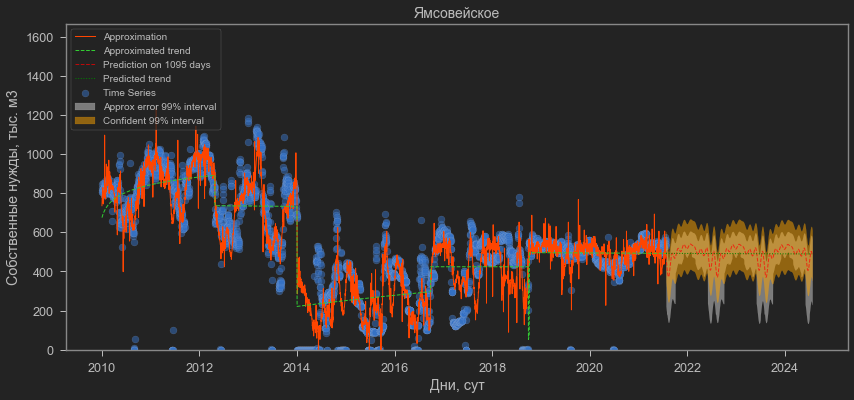

************************************************************************************************************************
The field "Вынгапуровское"
Change points: [2013.4 2015.2 2016.5]
Fourier function of 8-th order
R2=0.767; MAE=5.92 (mean_y=31.77); RMSE=9.48


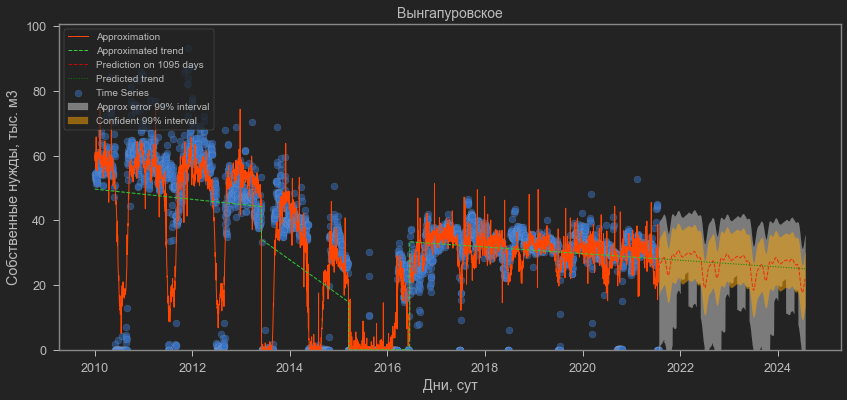

************************************************************************************************************************
The field "Вынгаяхинское"
Change points: [2011.7 2014.3 2016.8 2016.8 2018.6]
Fourier function of 8-th order
R2=0.68; MAE=25.04 (mean_y=280.3); RMSE=38.85


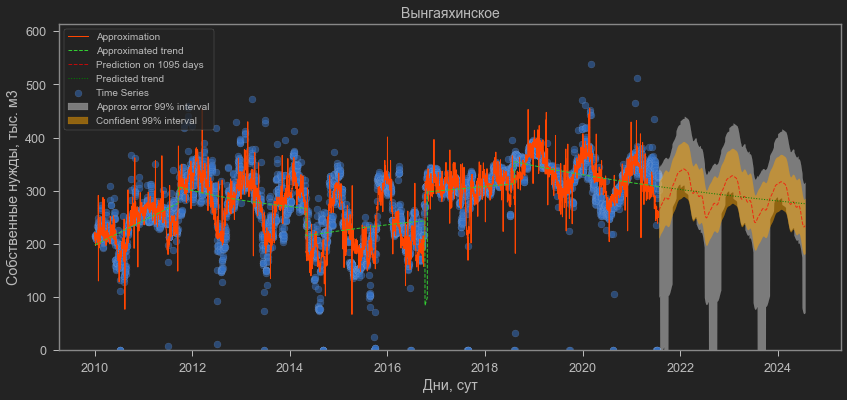

************************************************************************************************************************
The field "Еты-Пуровское"
Change points: [2014.2 2016.8]
Fourier function of 8-th order
R2=0.566; MAE=80.32 (mean_y=692.22); RMSE=121.2


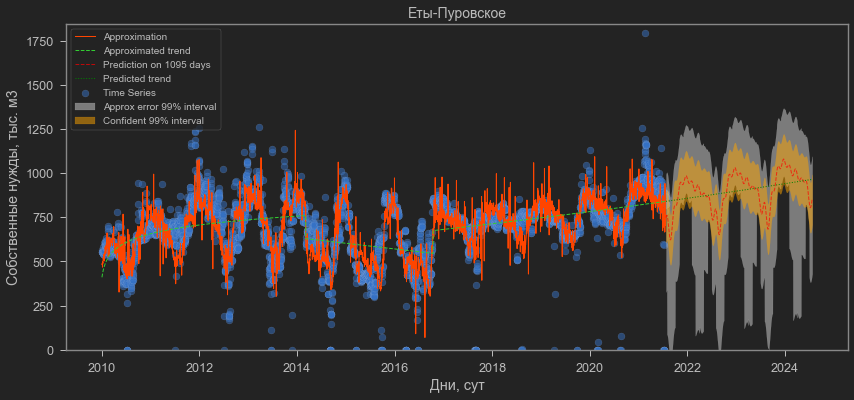

************************************************************************************************************************
The field "Зап.Таркосалинск."
Change points: [2012.4 2014.4 2016.1]
Fourier function of 8-th order
R2=0.821; MAE=45.07 (mean_y=378.41); RMSE=65.18


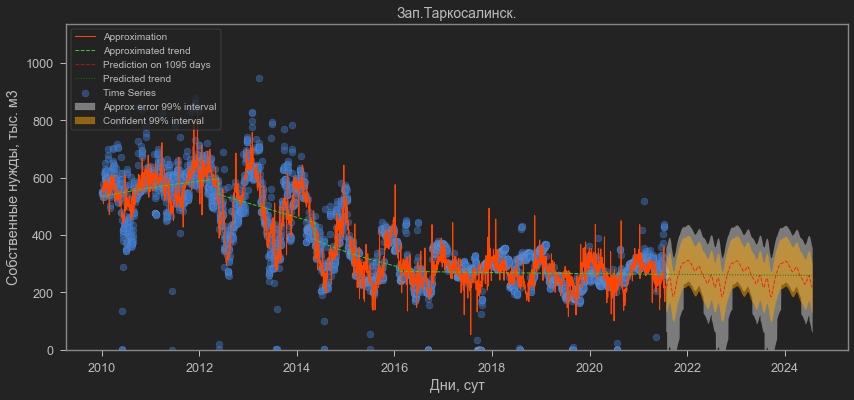

************************************************************************************************************************
The field "Комсомольское"
Change points: [2012.4 2014.4 2016.8 2019.4]
Fourier function of 8-th order
R2=0.856; MAE=69.52 (mean_y=610.79); RMSE=109.85


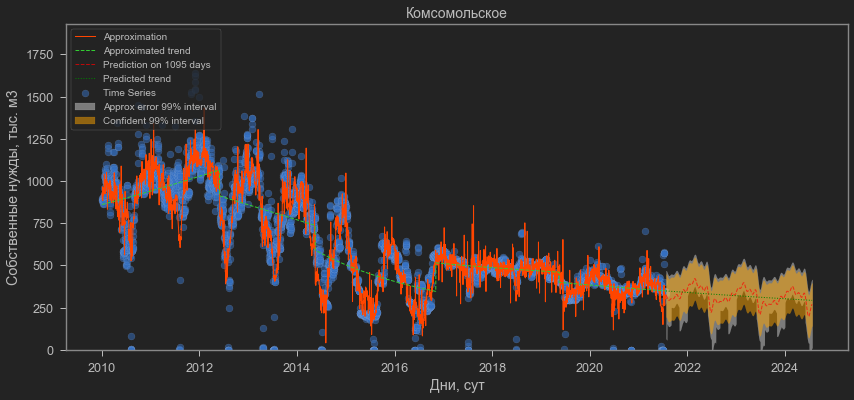

************************************************************************************************************************
The field "Астраханское ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.548; MAE=29.37 (mean_y=409.76); RMSE=42.61


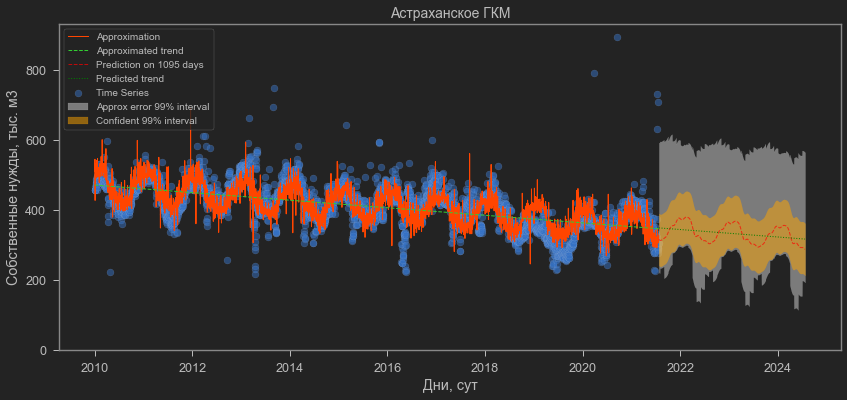

************************************************************************************************************************
The field "Болтное"
Change points: [2013.4 2015.6]
Fourier function of 8-th order
R2=0.328; MAE=0.21 (mean_y=0.75); RMSE=0.31


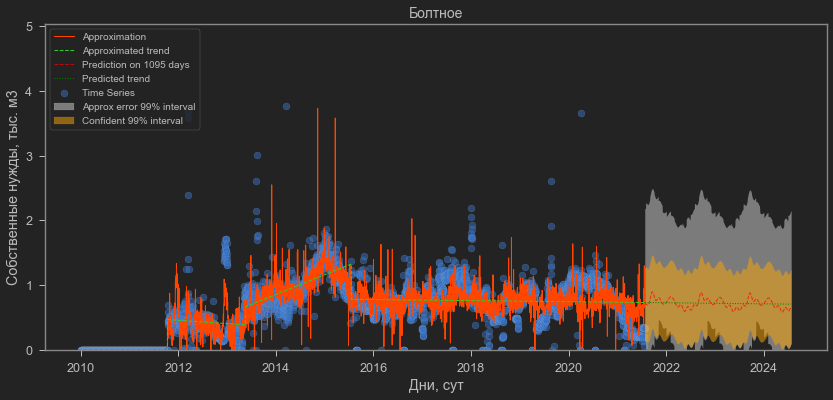

************************************************************************************************************************
The field "Казанское"
Change points: [2011.6 2014.7 2019.8]
Fourier function of 8-th order
R2=0.897; MAE=13.16 (mean_y=122.41); RMSE=23.58


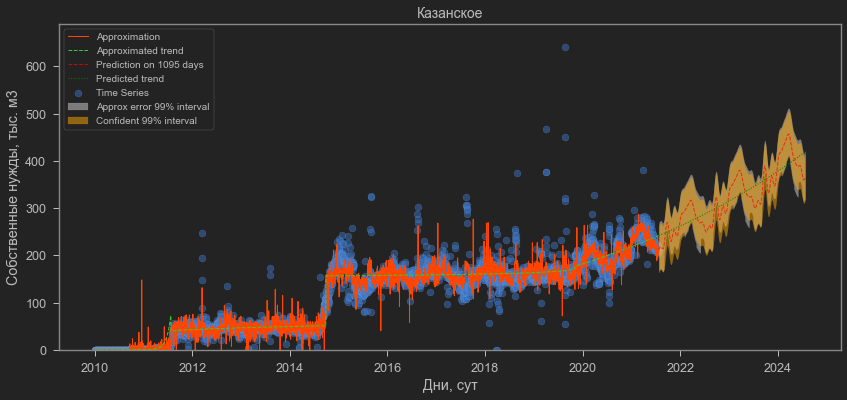

************************************************************************************************************************
The field "Мирное"
Change points: [2015.6 2018.6 2019.3]
Fourier function of 8-th order
R2=0.882; MAE=0.99 (mean_y=6.14); RMSE=2.15


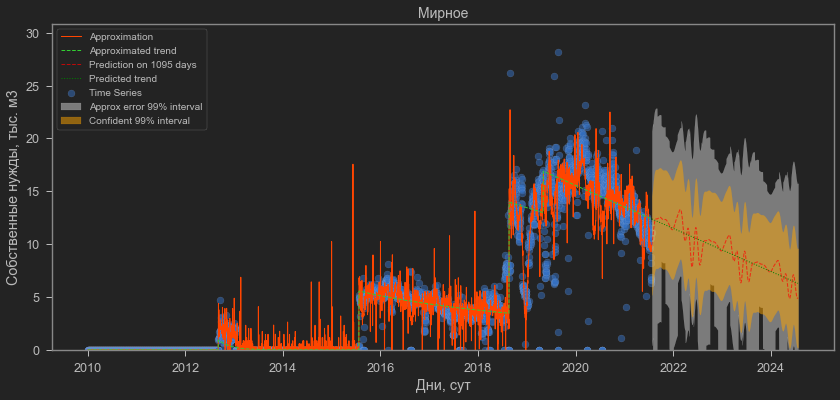

************************************************************************************************************************
The field "Мыльджинское"
Change points: [nan]
Fourier function of 8-th order
R2=0.318; MAE=27.95 (mean_y=217.99); RMSE=42.35


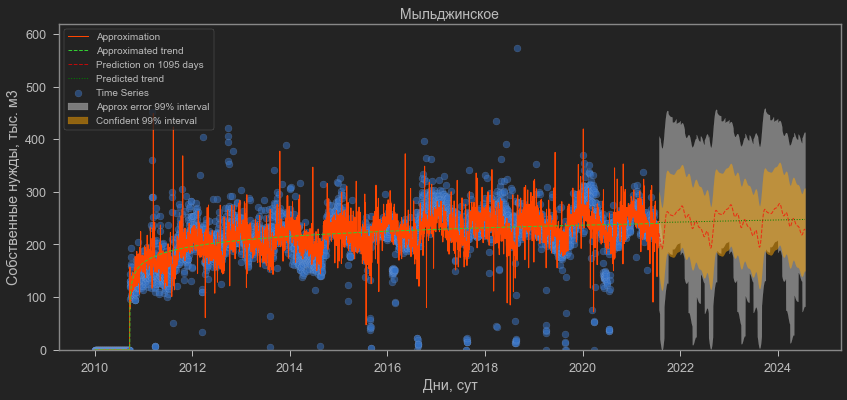

************************************************************************************************************************
The field "Останинское"
Change points: [2017.4]
Fourier function of 8-th order
R2=0.826; MAE=8.23 (mean_y=52.49); RMSE=14.46


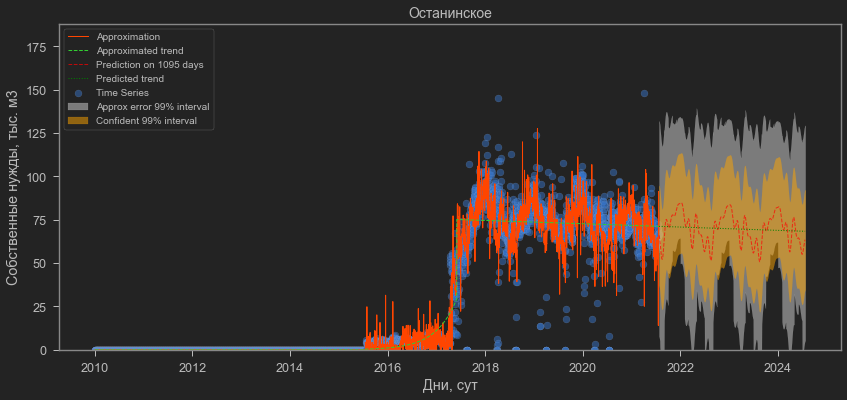

************************************************************************************************************************
The field "Пинджинское"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-1.98; MAE=0.2 (mean_y=0.09); RMSE=0.24


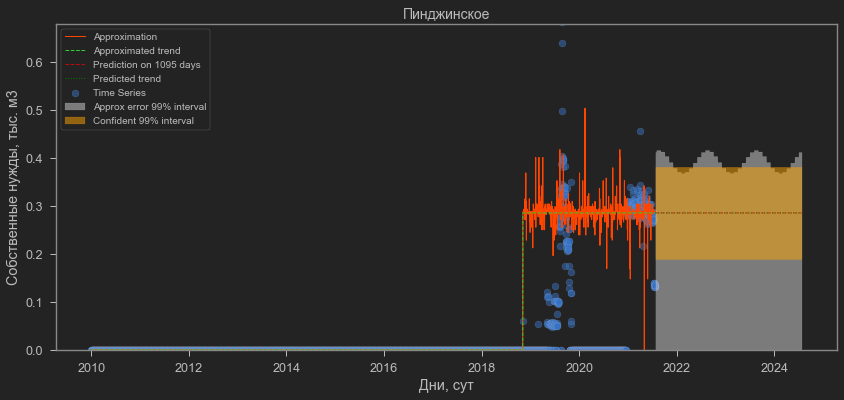

************************************************************************************************************************
The field "Рыбальное"
Change points: [2019.4 2021.4]
Fourier function of 8-th order
Use simple approximation median
R2=0.851; MAE=0.2 (mean_y=0.75); RMSE=0.4


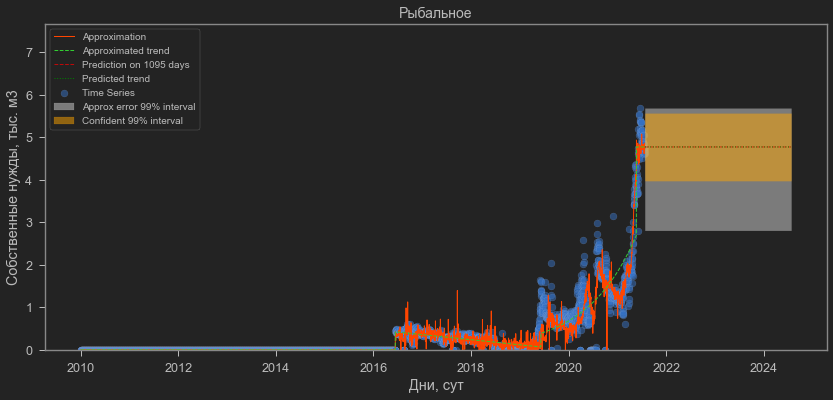

************************************************************************************************************************
The field "Северо-Васюганское"
Change points: [nan]
Fourier function of 8-th order
R2=0.632; MAE=10.46 (mean_y=77.23); RMSE=16.06


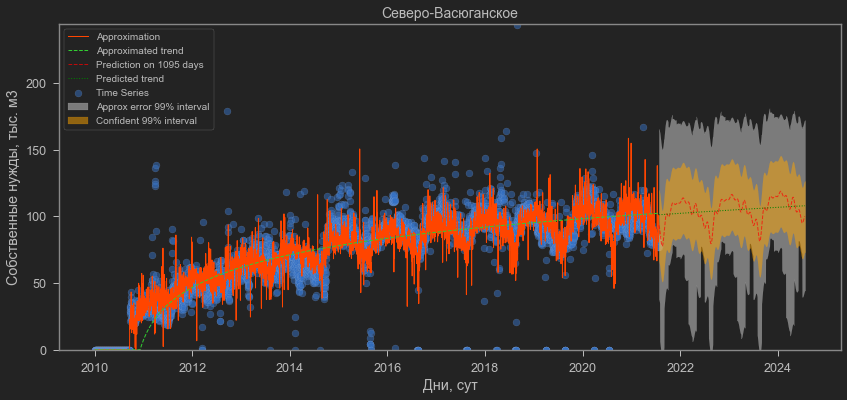

************************************************************************************************************************
The field "Северо-Останинское"
Change points: [2013.9 2015.5 2017.6 2019.9]
Fourier function of 8-th order
R2=0.581; MAE=1.48 (mean_y=5.75); RMSE=2.91


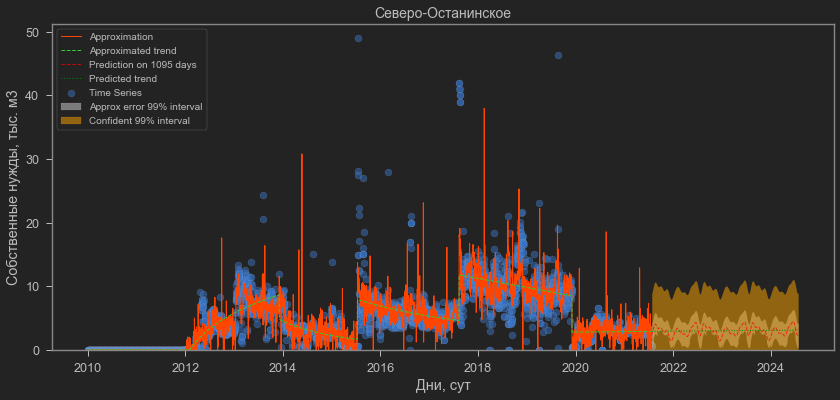

************************************************************************************************************************
The field "Ен.-Яхинское (В.)"
Change points: [2016.4 2019.6]
Fourier function of 8-th order
R2=0.322; MAE=19.08 (mean_y=207.16); RMSE=30.57


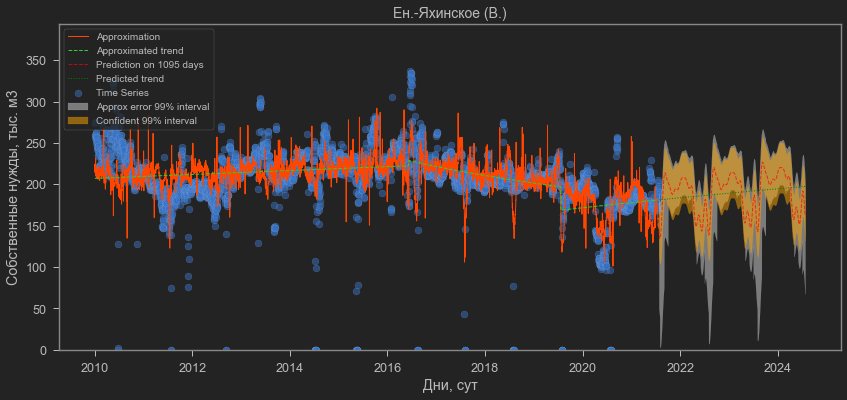

************************************************************************************************************************
The field "Ен.-Яхинское (ГПН-Зап)"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-0.129; MAE=3.34 (mean_y=16.3); RMSE=4.74


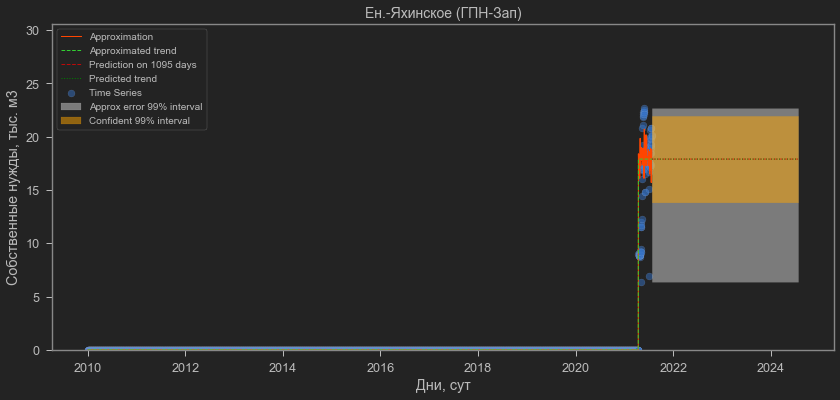

************************************************************************************************************************
The field "НГДУ (валанжин)"
Change points: [nan]
Fourier function of 8-th order
R2=0.549; MAE=6.2 (mean_y=48.25); RMSE=9.97


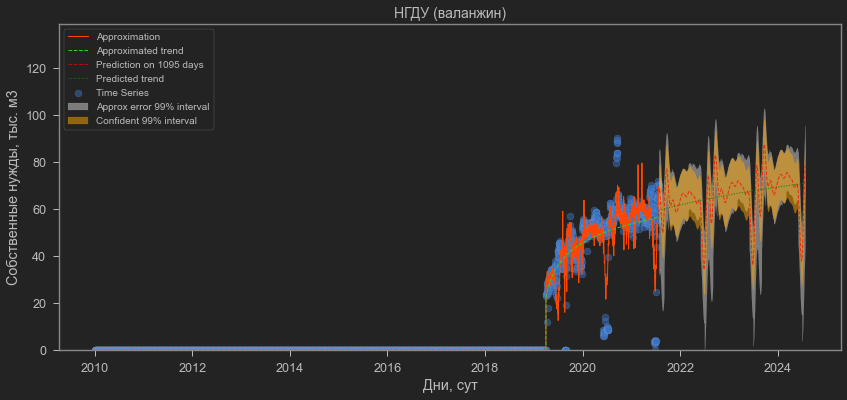

************************************************************************************************************************
The field "НГДУ (попутныйгаз)"
Change points: [nan]
Fourier function of 8-th order
R2=0.243; MAE=2.56 (mean_y=14.58); RMSE=3.32


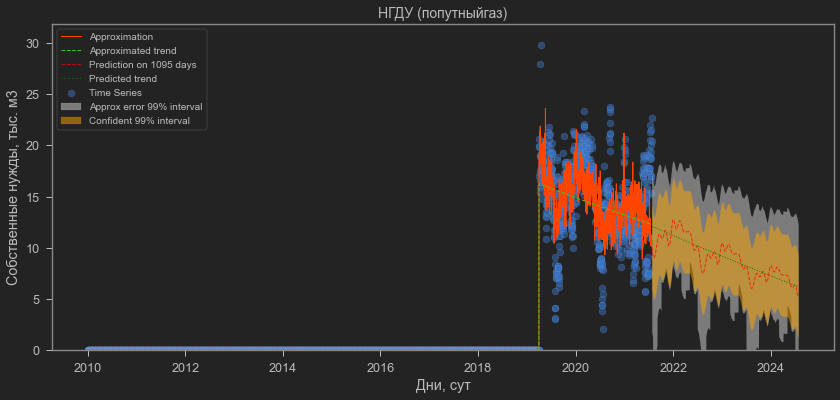

************************************************************************************************************************
The field "Песцовое"
Change points: [2014.2 2016.8]
Fourier function of 8-th order
R2=0.654; MAE=159.8 (mean_y=1181.34); RMSE=224.27


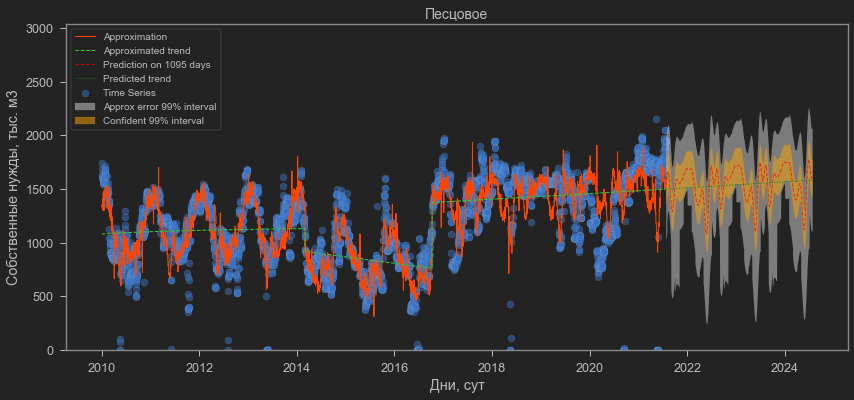

************************************************************************************************************************
The field "Песцовое (ГПН-Зап)"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


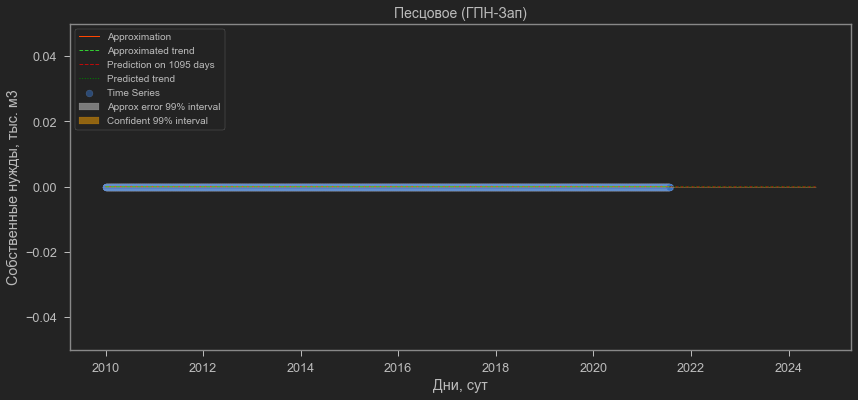

************************************************************************************************************************
The field "УКПГ-22 (Ачимовка)"
Change points: [2014.9 2020.5]
Fourier function of 8-th order
R2=0.869; MAE=17.53 (mean_y=123.87); RMSE=29.79


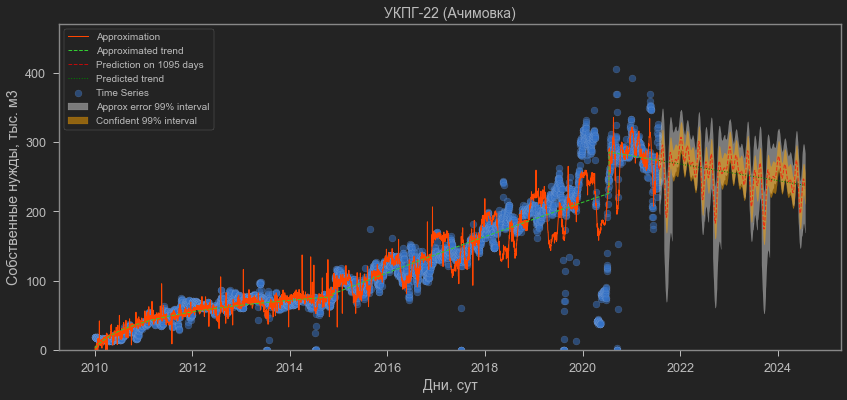

************************************************************************************************************************
The field "УКПГ-31 (Ачимгаз)"
Change points: [2012.9 2013.8]
Fourier function of 8-th order
R2=0.926; MAE=36.69 (mean_y=299.47); RMSE=63.25


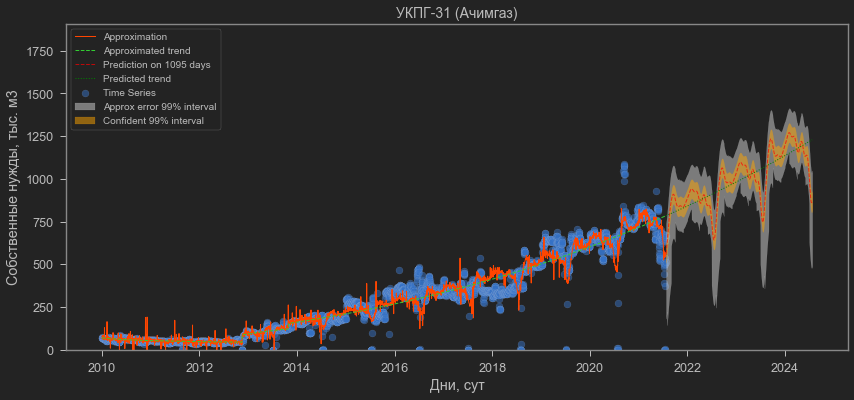

************************************************************************************************************************
The field "УКПГ-41 (АчимДевелопмент)"
Change points: [nan]
Fourier function of 8-th order
R2=0.67; MAE=12.97 (mean_y=132.37); RMSE=18.85


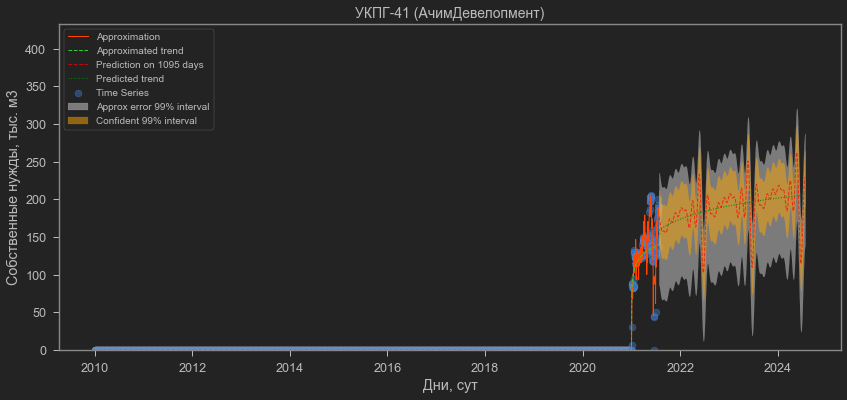

************************************************************************************************************************
The field "УКПГ-51 (АчимДевелопмент)"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-0.0183; MAE=14.61 (mean_y=84.04); RMSE=19.26


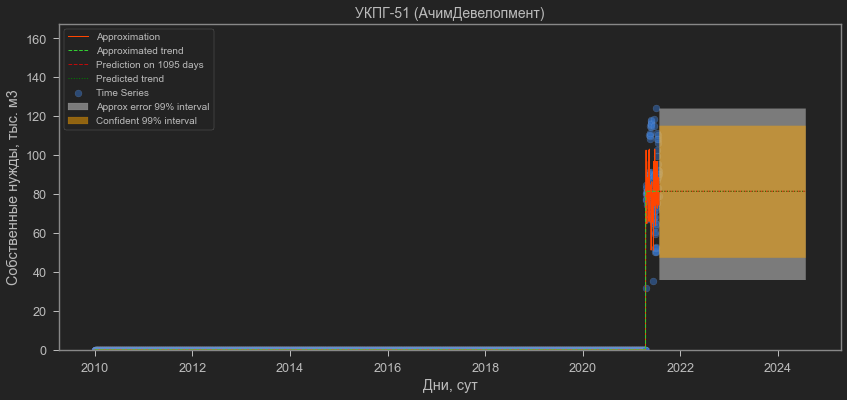

************************************************************************************************************************
The field "Уренгойское"
Change points: [2017.7]
Fourier function of 8-th order
R2=0.748; MAE=285.75 (mean_y=3140.7); RMSE=390.13


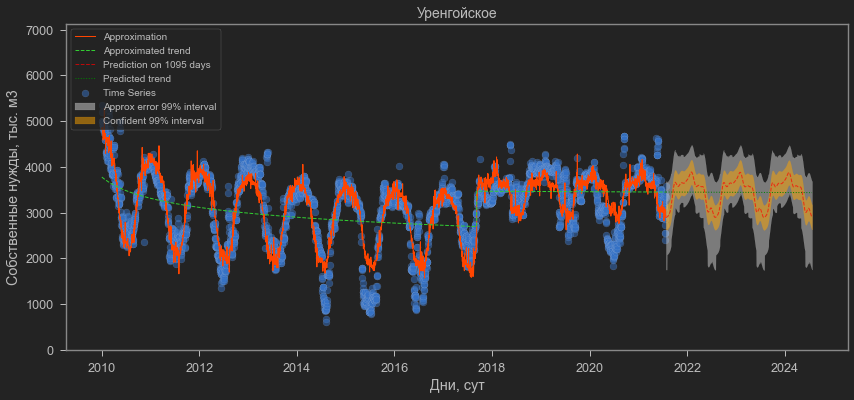

************************************************************************************************************************
The field "Губкинское (сеном)"
Change points: [2015.8]
Fourier function of 8-th order
R2=0.245; MAE=36.7 (mean_y=562.2); RMSE=75.03


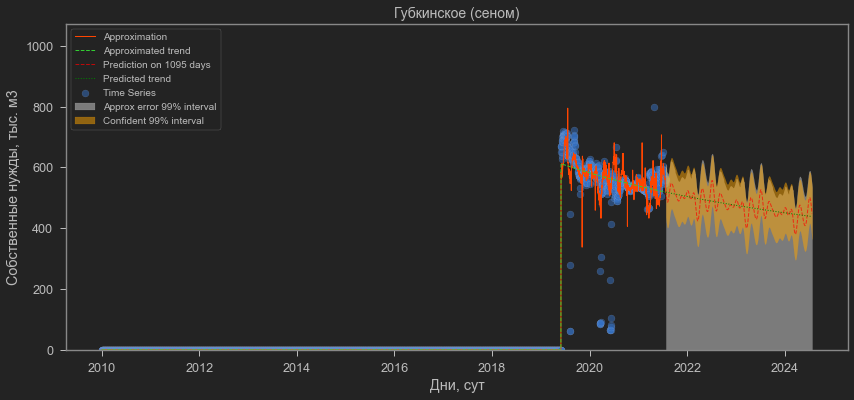

************************************************************************************************************************
The field "Южно-Русское НГКМ"
Change points: [2020.]
Fourier function of 8-th order
R2=0.872; MAE=37.91 (mean_y=377.01); RMSE=85.12


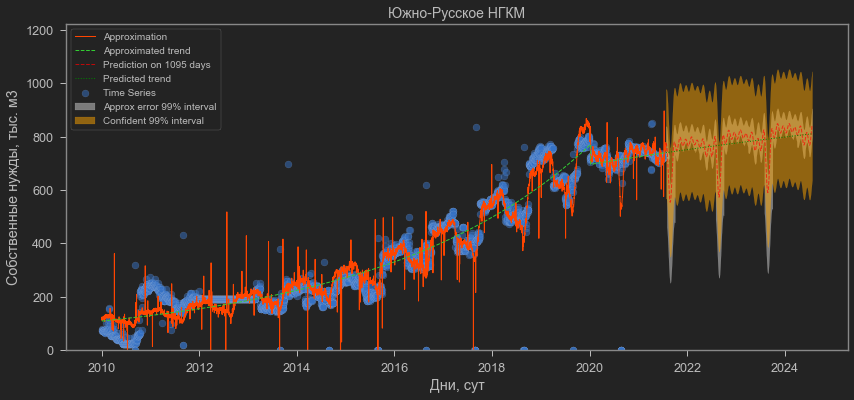

************************************************************************************************************************
The field "Оренбургское НГКМ и др"
Change points: [2018.4 2020. ]
Fourier function of 8-th order
R2=0.925; MAE=117.66 (mean_y=1536.26); RMSE=186.93


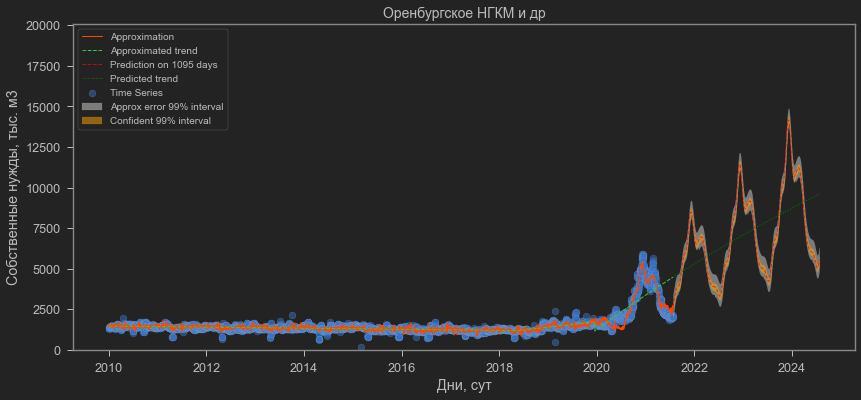

************************************************************************************************************************
The field "ООО Сервиснефтегаз"
Change points: [nan]
Fourier function of 8-th order
R2=0.0299; MAE=0.27 (mean_y=0.49); RMSE=1.05


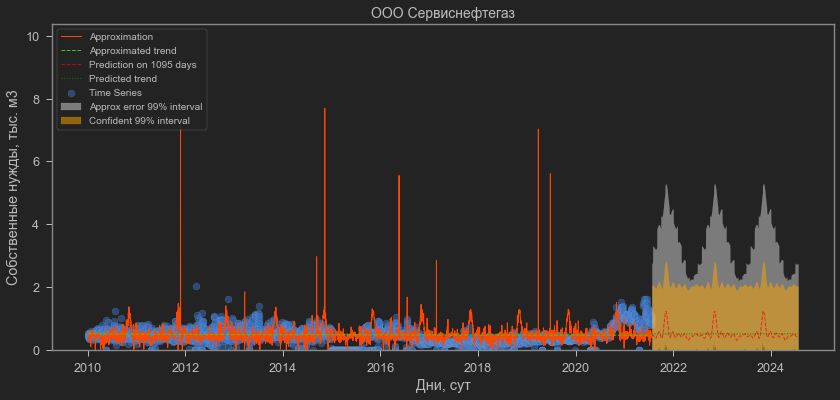

************************************************************************************************************************
The field "Kаневско-Лебяжье ГКМ"
Change points: [2017.1 2019.5]
Fourier function of 8-th order
R2=0.636; MAE=1.25 (mean_y=7.6); RMSE=1.69


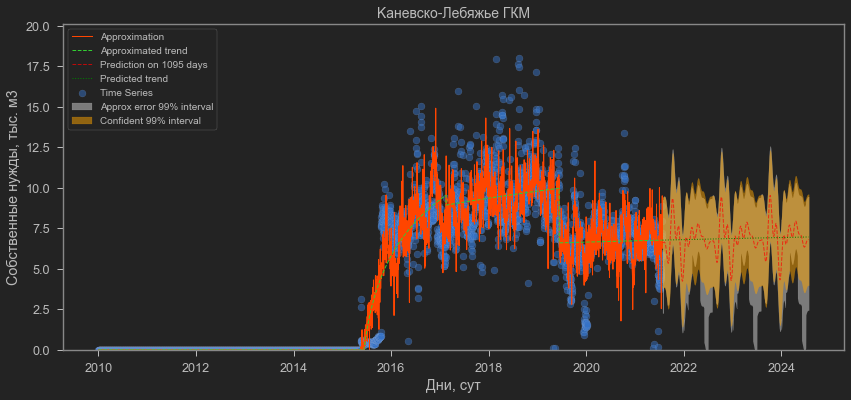

************************************************************************************************************************
The field "Челбасское ГКМ"
Change points: [2017.]
Fourier function of 8-th order
R2=0.661; MAE=0.68 (mean_y=4.95); RMSE=0.95


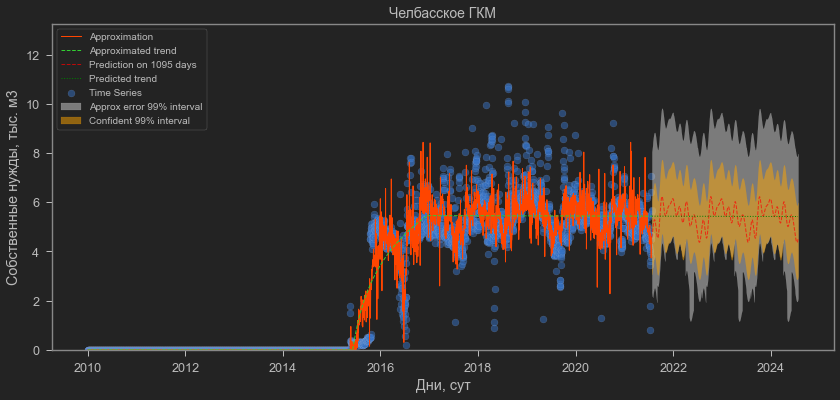

************************************************************************************************************************
The field "Бейсугское ГМ"
Change points: [2015.8 2018.8]
Fourier function of 8-th order
R2=0.853; MAE=0.99 (mean_y=7.91); RMSE=1.47


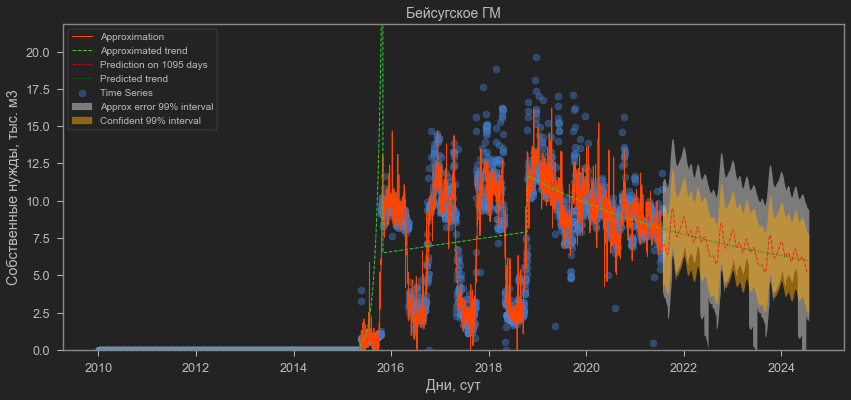

************************************************************************************************************************
The field "Роговское ГМ"
Change points: [2018.6]
Fourier function of 8-th order
R2=0.681; MAE=0.86 (mean_y=5.52); RMSE=1.13


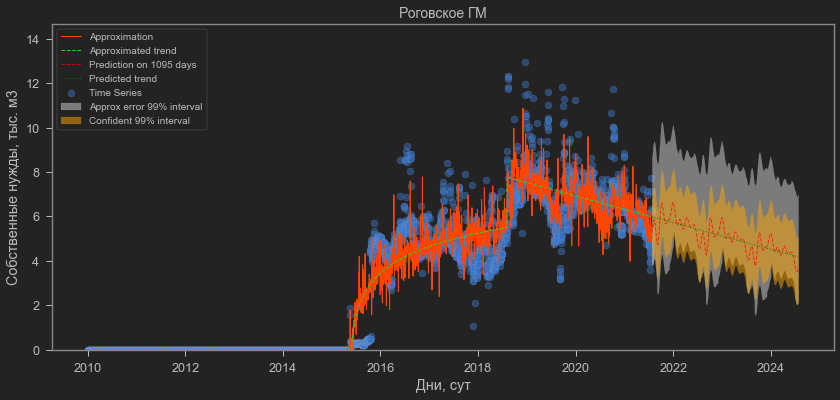

************************************************************************************************************************
The field "Днепровское ГМ"
Change points: [2018.9]
Fourier function of 8-th order
R2=0.85; MAE=0.31 (mean_y=1.26); RMSE=0.46


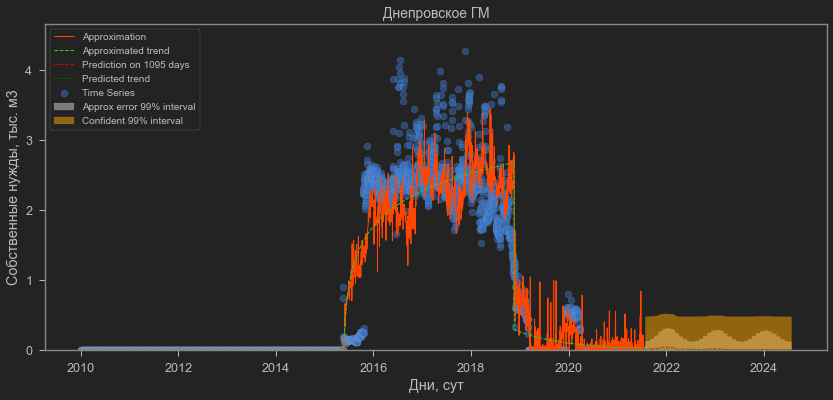

************************************************************************************************************************
The field "Гречаное ГМ"
Change points: [2016.3 2018.5 2020.8]
Fourier function of 8-th order
R2=0.881; MAE=0.19 (mean_y=0.91); RMSE=0.34


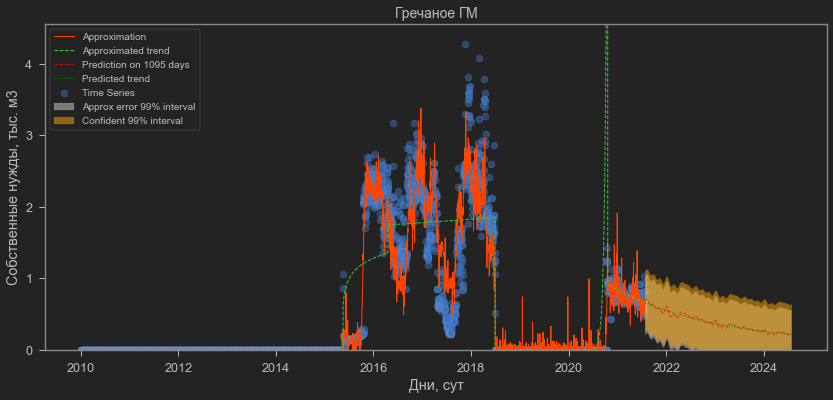

************************************************************************************************************************
The field "Граничное ГКМ"
Change points: [2016.9 2019.3]
Fourier function of 8-th order
R2=0.9; MAE=0.17 (mean_y=0.82); RMSE=0.27


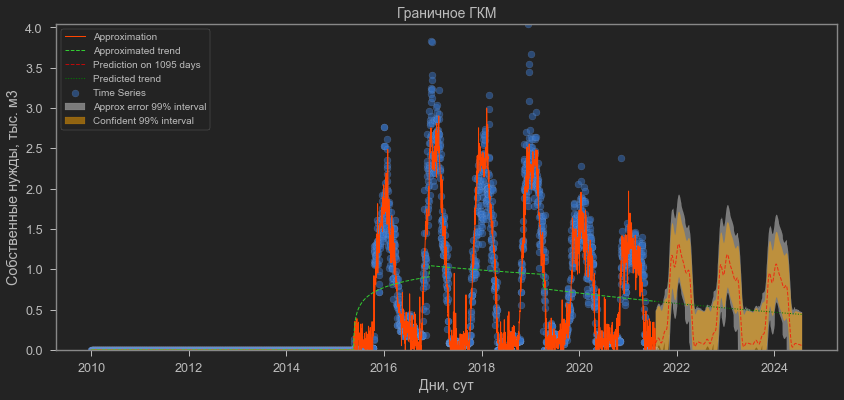

************************************************************************************************************************
The field "Синявское ГМ"
Change points: [2017.2 2019.5]
Fourier function of 8-th order
R2=0.671; MAE=0.62 (mean_y=4.6); RMSE=0.88


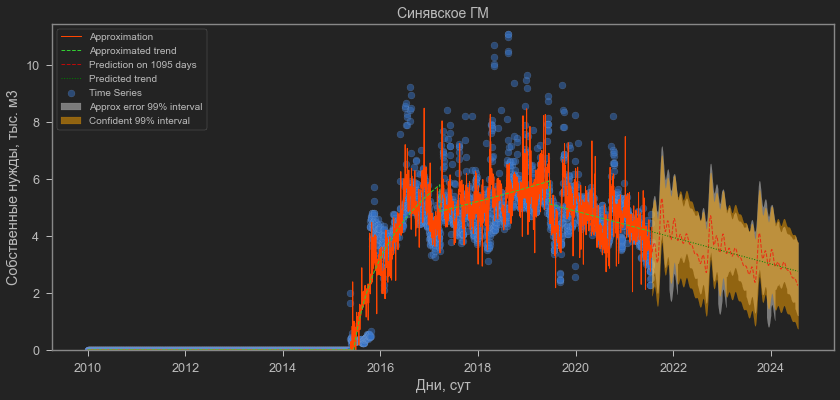

************************************************************************************************************************
The field "Азовское ГМ"
Change points: [2017.  2019.3]
Fourier function of 8-th order
R2=0.835; MAE=1.9 (mean_y=13.68); RMSE=2.59


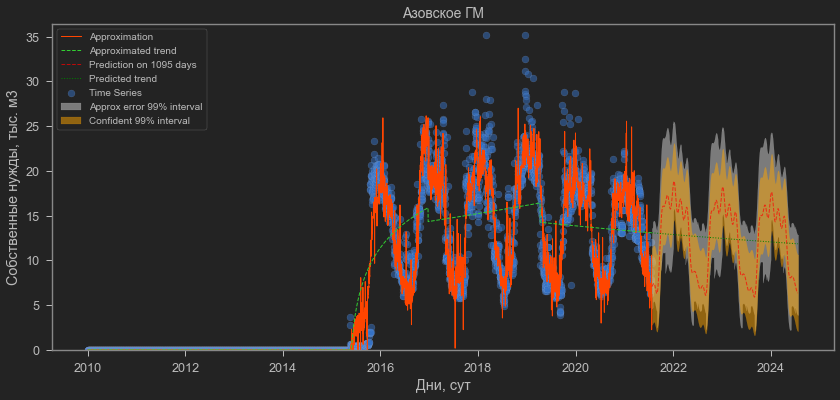

************************************************************************************************************************
The field "Патроновское ГКМ"
Change points: [2018.8 2019.3 2020.4]
Fourier function of 8-th order
R2=0.713; MAE=0.44 (mean_y=2.11); RMSE=0.6


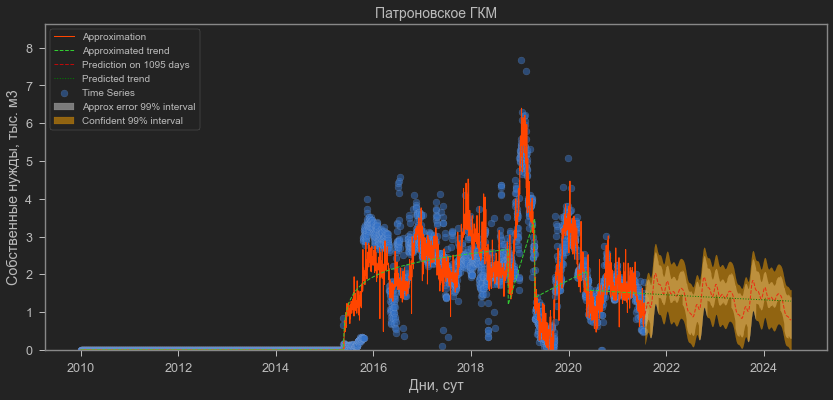

************************************************************************************************************************
The field "Марковское ГКМ"
Change points: [2019.5]
Fourier function of 8-th order
R2=0.544; MAE=6.86 (mean_y=38.49); RMSE=9.25


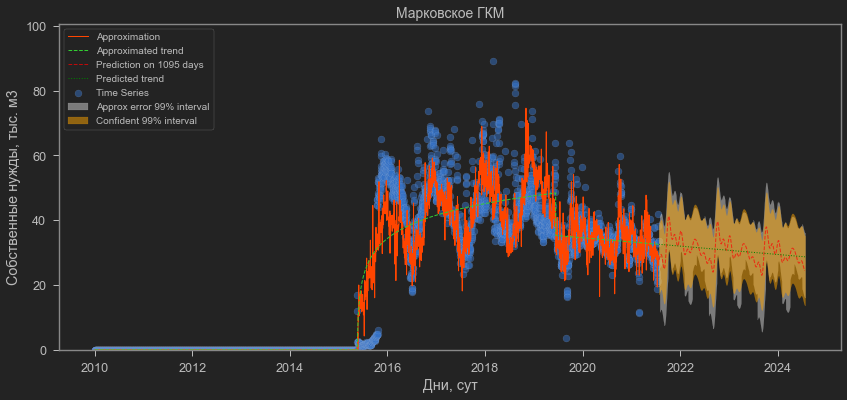

************************************************************************************************************************
The field "Элитное ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.265; MAE=0.32 (mean_y=0.75); RMSE=0.43


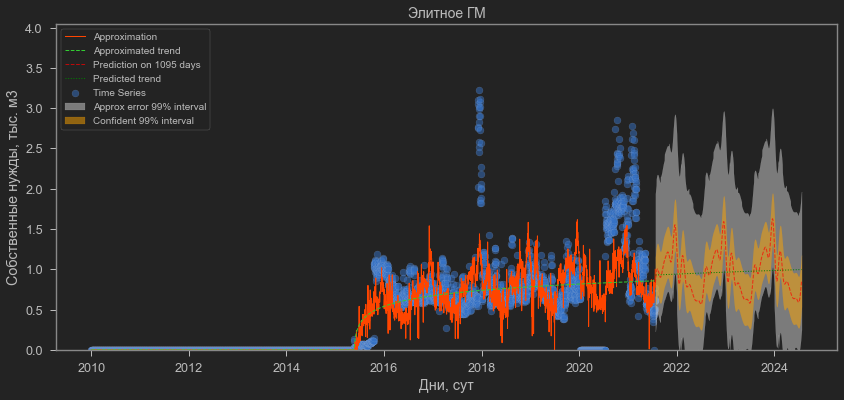

************************************************************************************************************************
The field "Зап.-Красноармейское ГМ"
Change points: [2019.5 2020.5]
Fourier function of 8-th order
Use simple approximation median
R2=0.685; MAE=0.41 (mean_y=2.19); RMSE=0.55


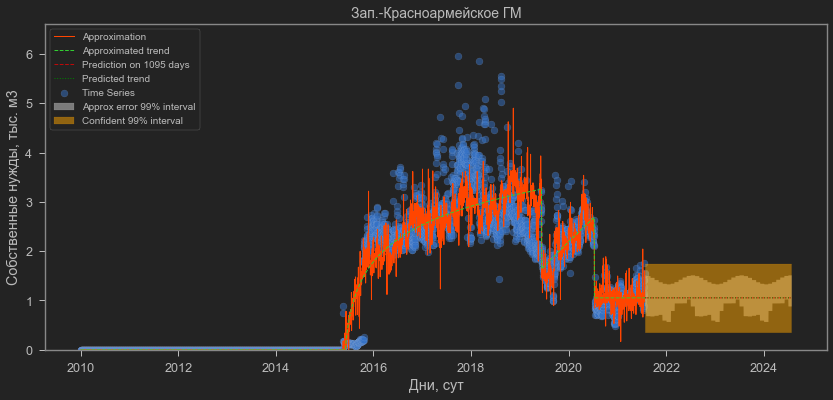

************************************************************************************************************************
The field "Красноармейское ГМ"
Change points: [2017.  2019.3]
Fourier function of 8-th order
R2=0.879; MAE=0.5 (mean_y=3.19); RMSE=0.69


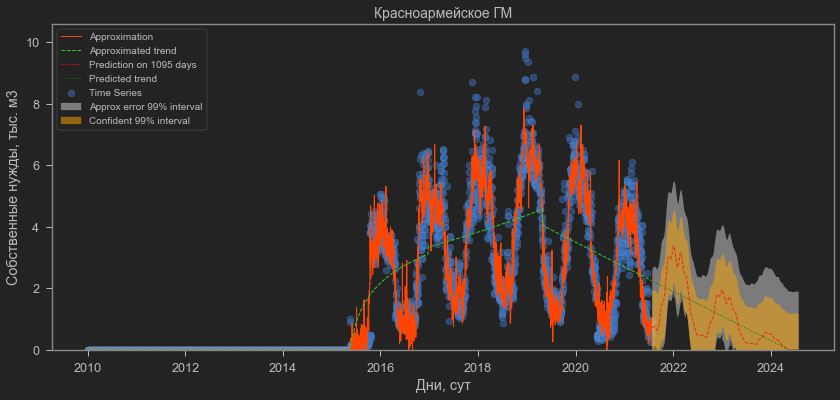

************************************************************************************************************************
The field "Лебединское ГМ"
Change points: [2017.3 2018.9]
Fourier function of 8-th order
R2=0.864; MAE=0.06 (mean_y=0.24); RMSE=0.12


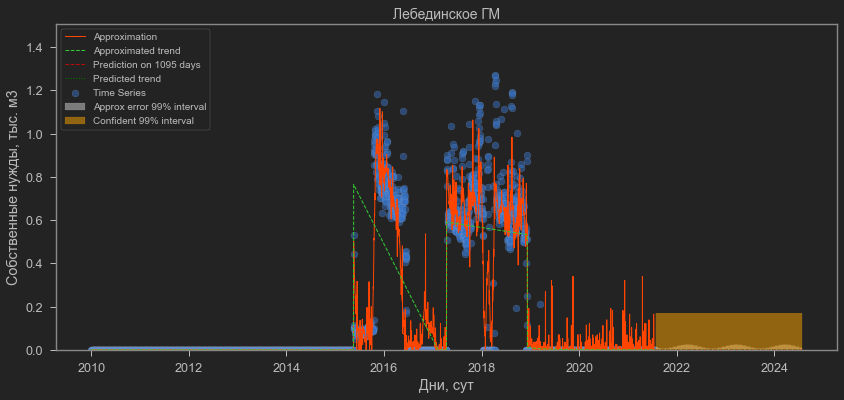

************************************************************************************************************************
The field "Сев.-Чебургольское ГМ"
Change points: [2017.]
Fourier function of 8-th order
R2=0.585; MAE=0.18 (mean_y=1.15); RMSE=0.24


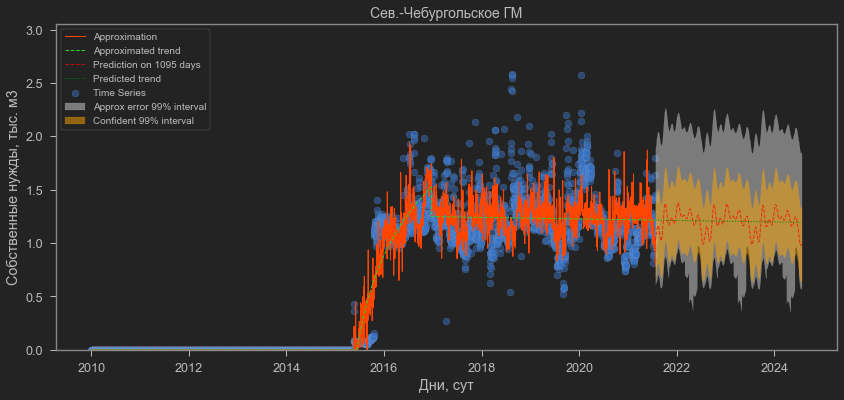

************************************************************************************************************************
The field "Пригибское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


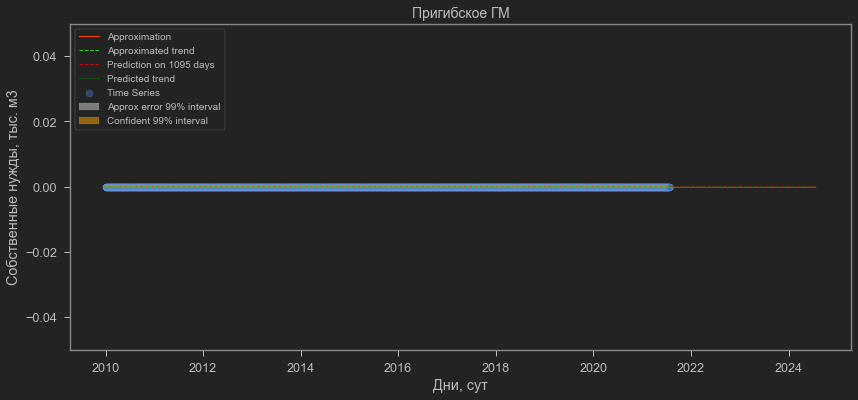

************************************************************************************************************************
The field "Гривенское ГМ"
Change points: [2019.5]
Fourier function of 8-th order
R2=0.283; MAE=1.3 (mean_y=5.71); RMSE=1.8


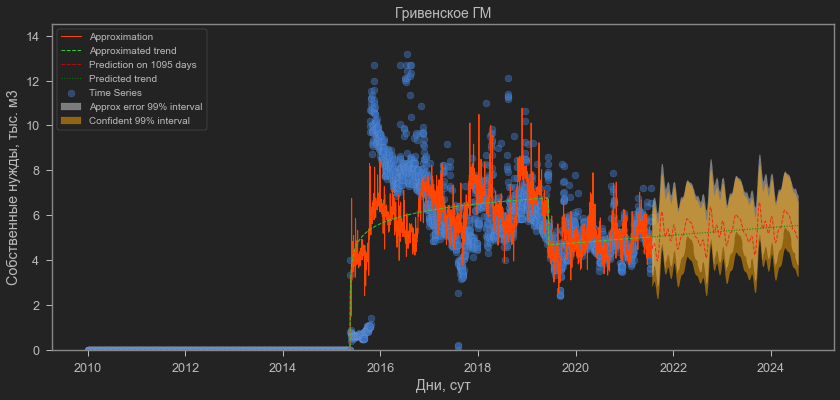

************************************************************************************************************************
The field "Южно-Гривенское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


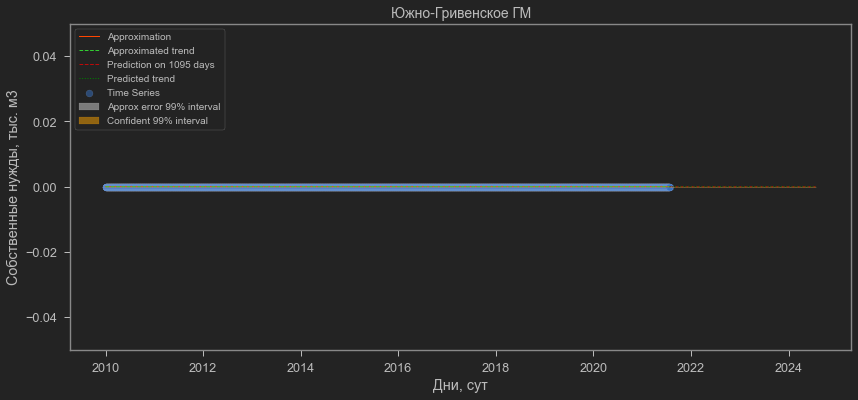

************************************************************************************************************************
The field "Петровское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.308; MAE=0.16 (mean_y=0.13); RMSE=0.82


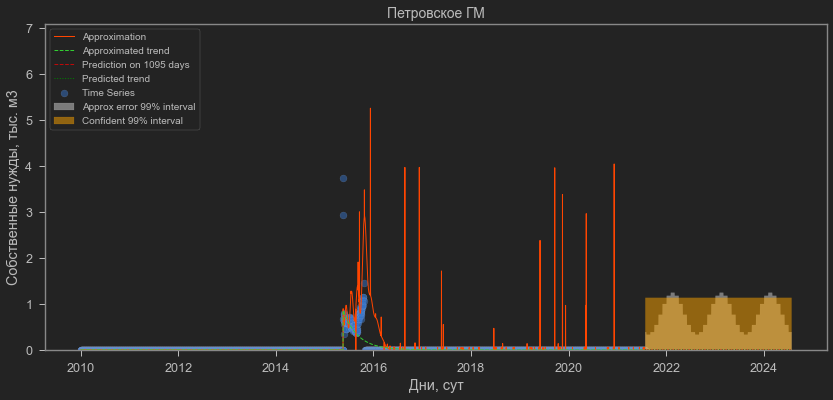

************************************************************************************************************************
The field "Сев.-Гривенское ГМ"
Change points: [2019.5]
Fourier function of 8-th order
R2=0.491; MAE=0.72 (mean_y=3.98); RMSE=0.98


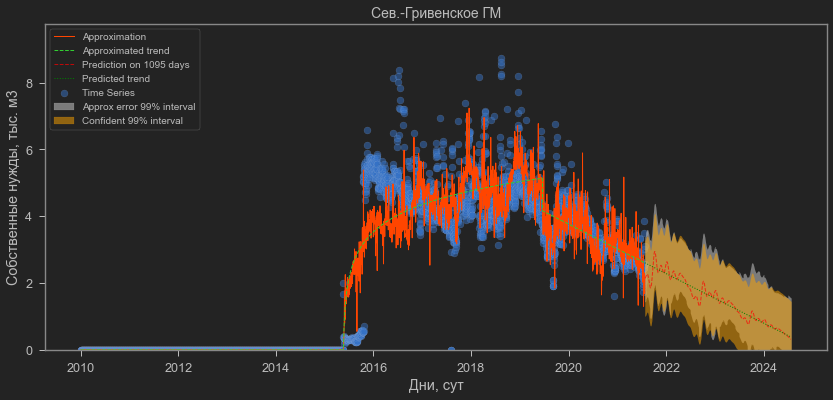

************************************************************************************************************************
The field "Мостовянское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.239; MAE=0.22 (mean_y=1.06); RMSE=0.3


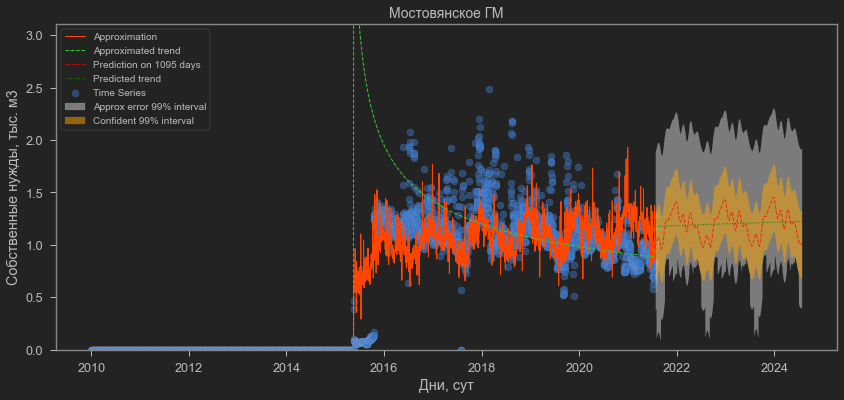

************************************************************************************************************************
The field "Мечетское ГМ"
Change points: [2017.5]
Fourier function of 8-th order
R2=0.683; MAE=0.85 (mean_y=4.41); RMSE=1.16


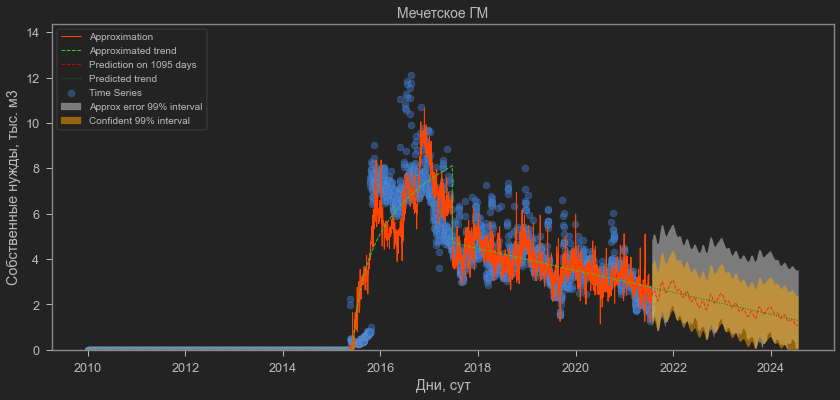

************************************************************************************************************************
The field "Некрасовское ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


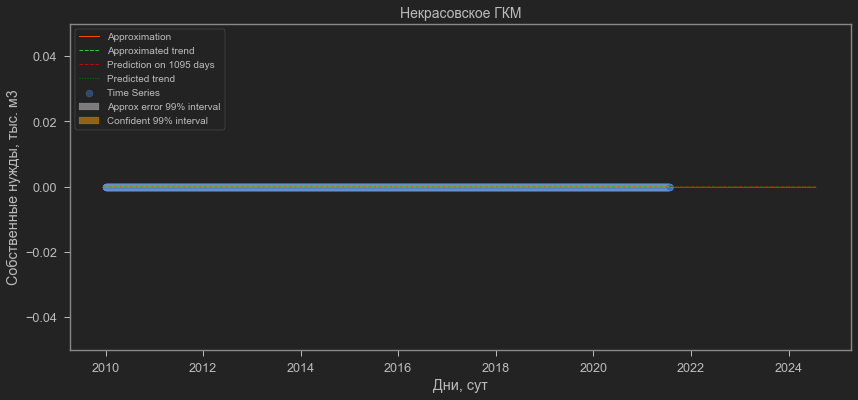

************************************************************************************************************************
The field "Ладожское ГКМ"
Change points: [2020.]
Fourier function of 8-th order
R2=0.747; MAE=0.11 (mean_y=0.52); RMSE=0.17


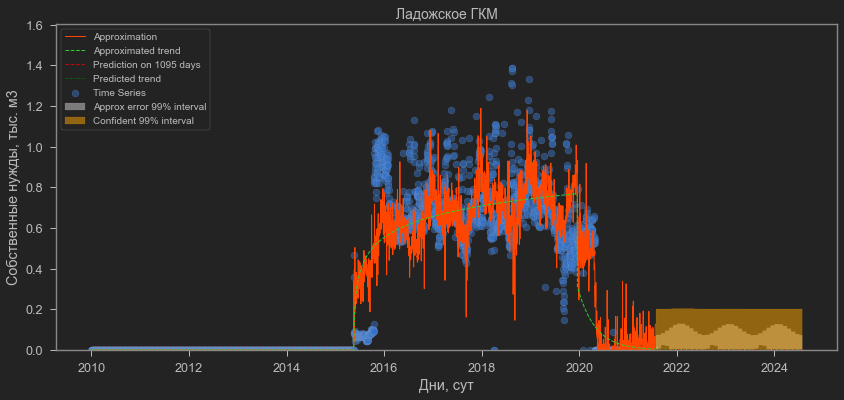

************************************************************************************************************************
The field "Юбилейное ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


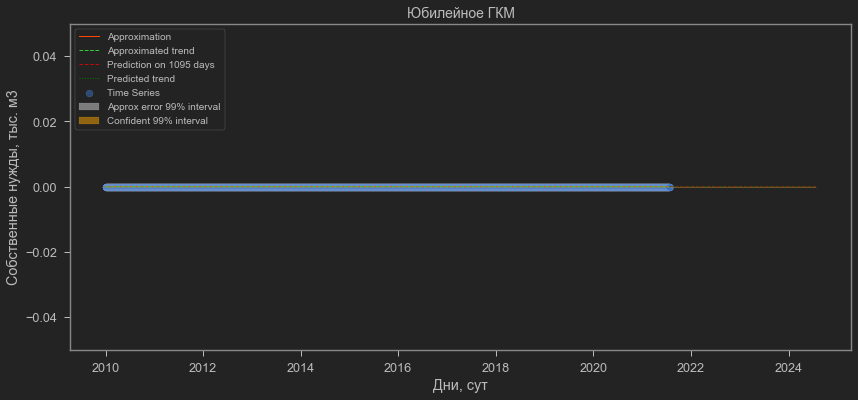

************************************************************************************************************************
The field "Майкопское ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.145; MAE=0.26 (mean_y=0.97); RMSE=0.38


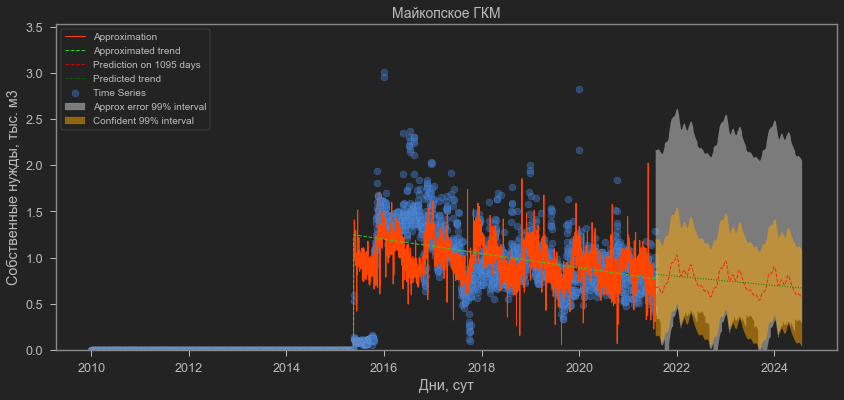

************************************************************************************************************************
The field "Прибрежное НГКМ"
Change points: [2018.1]
Fourier function of 8-th order
R2=0.523; MAE=0.83 (mean_y=2.53); RMSE=1.12


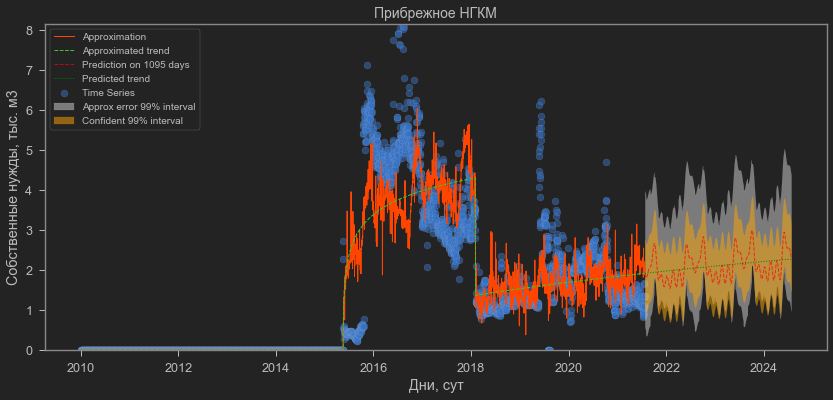

************************************************************************************************************************
The field "Вост.-Прибрежное НГКМ"
Change points: [2019.5]
Fourier function of 8-th order
R2=0.54; MAE=1.94 (mean_y=9.8); RMSE=2.58


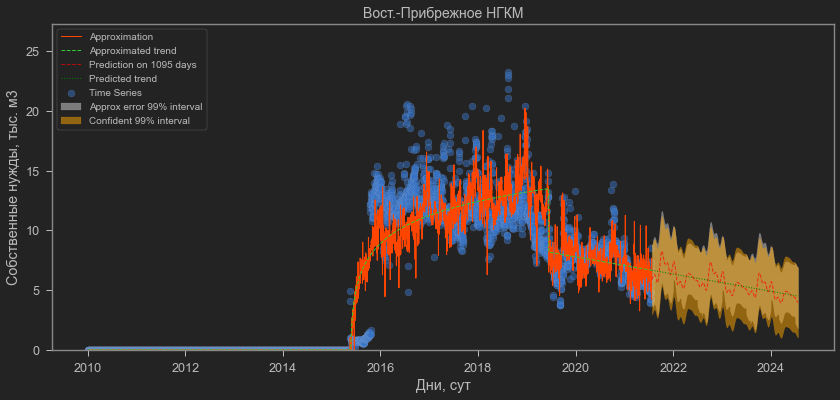

************************************************************************************************************************
The field "Сев.-Прибрежное НГКМ"
Change points: [2016.1 2019.3]
Fourier function of 8-th order
R2=0.682; MAE=0.06 (mean_y=0.28); RMSE=0.08


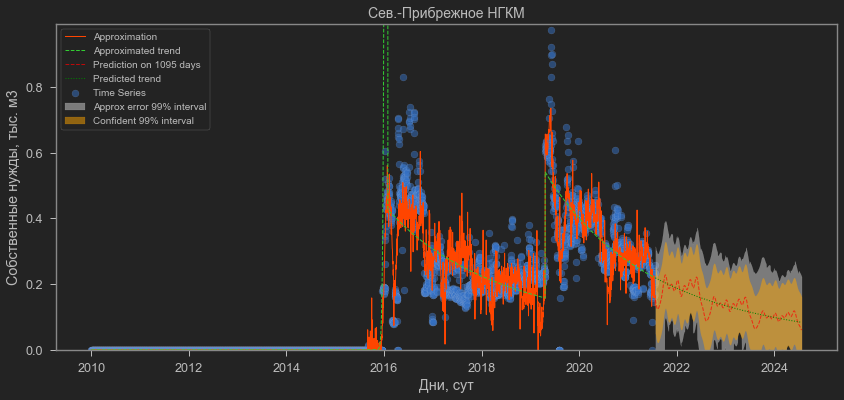

************************************************************************************************************************
The field "Ю.Черноерковск.НГКМ"
Change points: [2019.7]
Fourier function of 8-th order
R2=0.212; MAE=0.08 (mean_y=0.06); RMSE=0.14


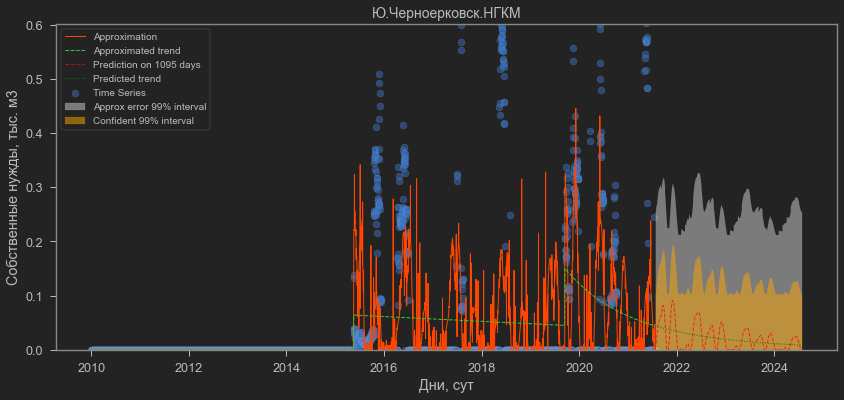

************************************************************************************************************************
The field "Мирненское ГКМ"
Change points: [2020.]
Fourier function of 8-th order
R2=0.544; MAE=0.99 (mean_y=6.07); RMSE=1.33


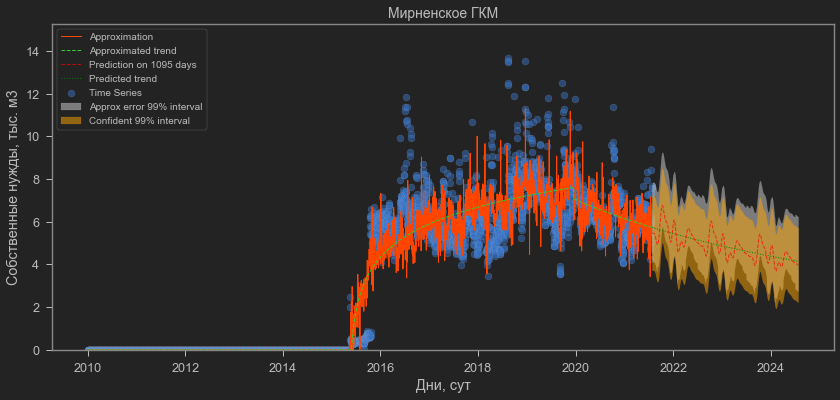

************************************************************************************************************************
The field "Журавское ГМ"
Change points: [2017.2]
Fourier function of 8-th order
R2=0.433; MAE=0.08 (mean_y=0.27); RMSE=0.11


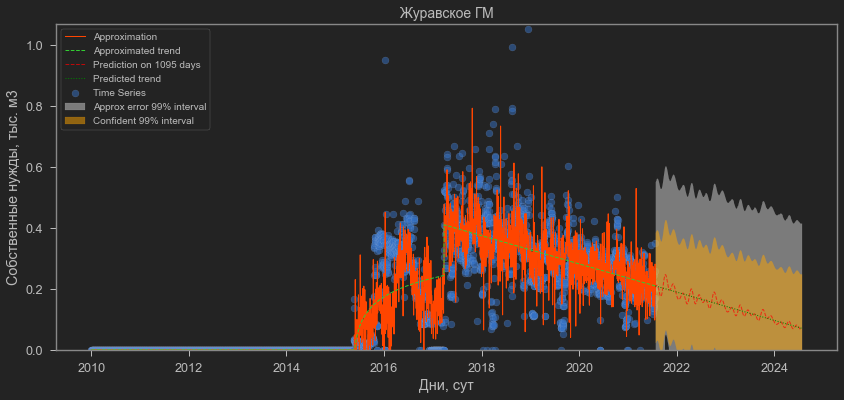

************************************************************************************************************************
The field "Каменно-Балковское ГМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.716; MAE=0.41 (mean_y=3.38); RMSE=0.59


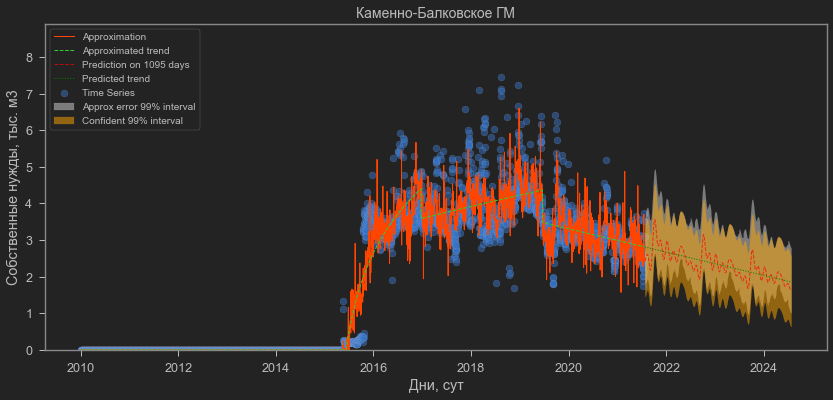

************************************************************************************************************************
The field "Петр.-Благодар.ГМ"
Change points: [2017.  2019.3]
Fourier function of 8-th order
R2=0.652; MAE=1.5 (mean_y=10.67); RMSE=2.08


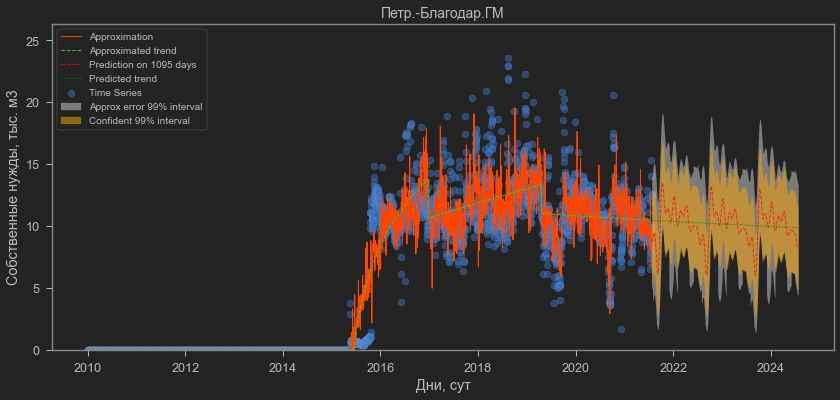

************************************************************************************************************************
The field "Кугутское ГМ"
Change points: [2017.7]
Fourier function of 8-th order
R2=0.629; MAE=0.67 (mean_y=3.44); RMSE=0.85


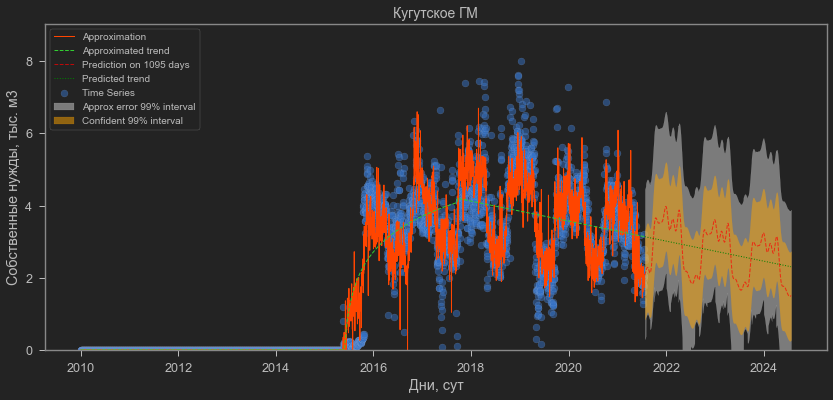

************************************************************************************************************************
The field "Казино - Грач. ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.0546; MAE=0.0 (mean_y=0.0); RMSE=0.01


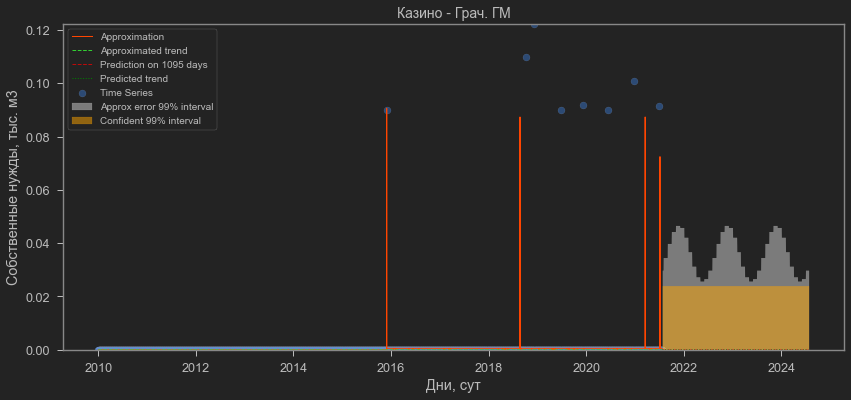

************************************************************************************************************************
The field "Вост.-Арзгирское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


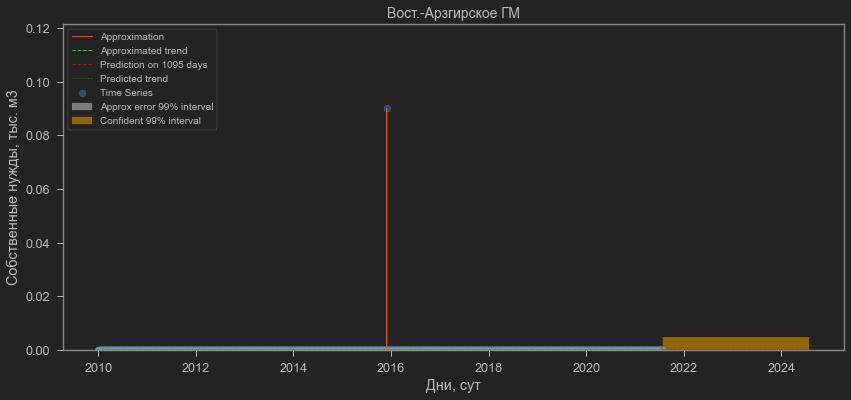

************************************************************************************************************************
The field "Безопасненское ГМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.607; MAE=0.12 (mean_y=0.77); RMSE=0.16


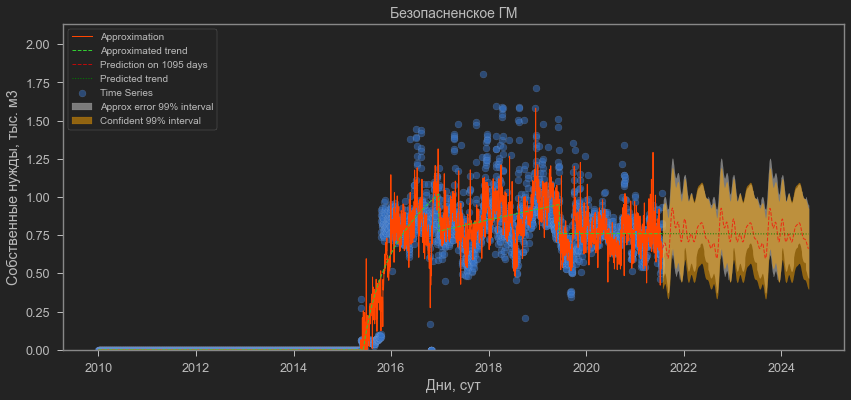

************************************************************************************************************************
The field "Тахта-Кугультинское ГМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.685; MAE=2.12 (mean_y=16.62); RMSE=2.99


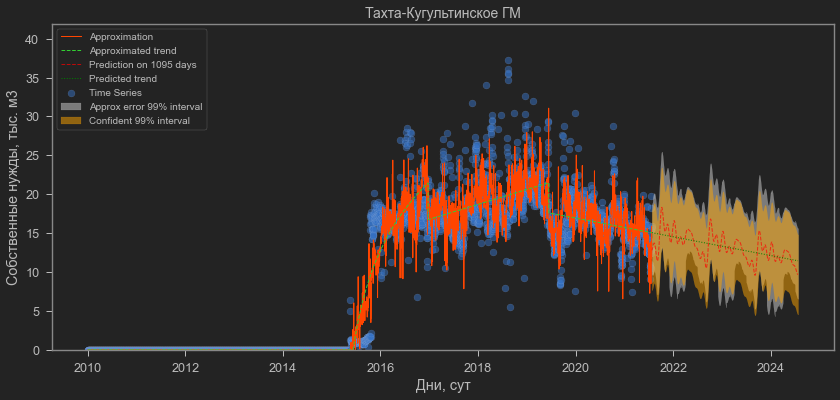

************************************************************************************************************************
The field "Радыковское ГМ"
Change points: [2017.  2018.6]
Fourier function of 8-th order
R2=0.715; MAE=0.17 (mean_y=1.27); RMSE=0.23


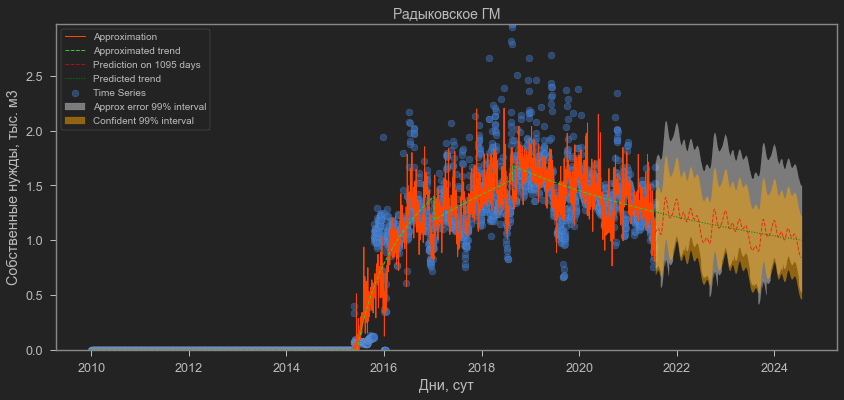

************************************************************************************************************************
The field "Южно-Радыковское ГМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.636; MAE=0.11 (mean_y=0.7); RMSE=0.15


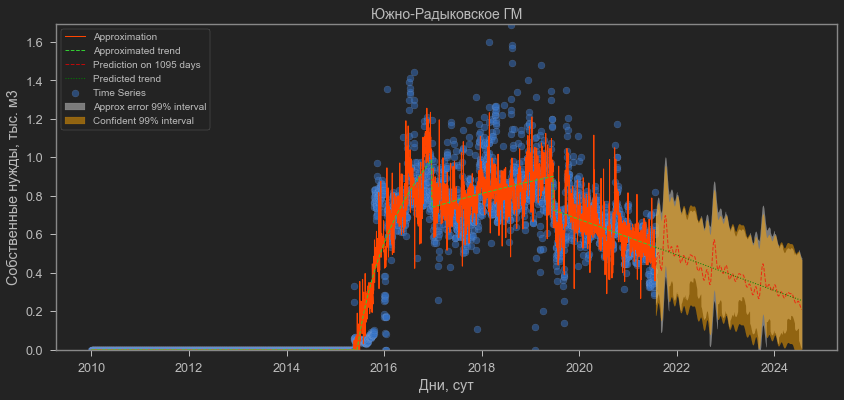

************************************************************************************************************************
The field "Сенгелеевское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.661; MAE=0.35 (mean_y=0.95); RMSE=0.58


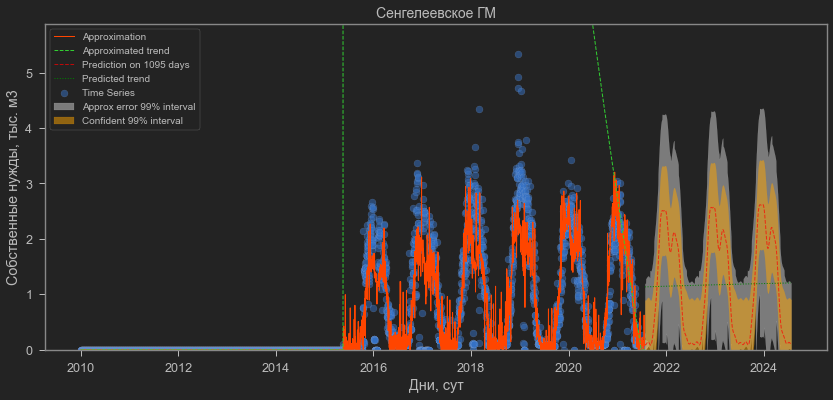

************************************************************************************************************************
The field "Расшеватское ГКМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.672; MAE=0.59 (mean_y=4.35); RMSE=0.83


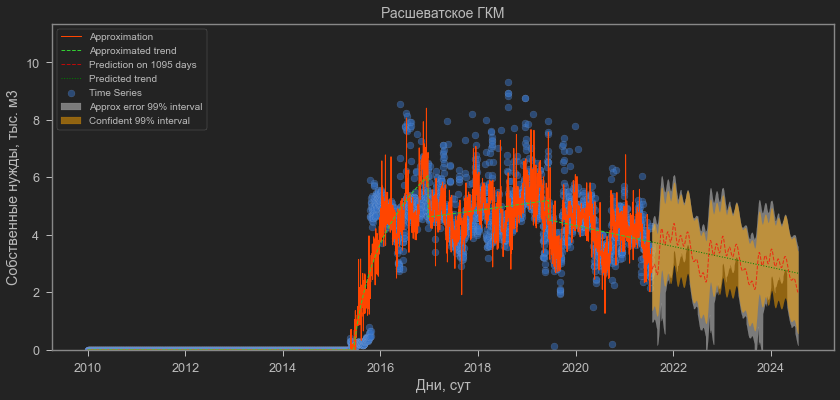

************************************************************************************************************************
The field "Николаевское ГКМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.712; MAE=0.43 (mean_y=3.61); RMSE=0.6


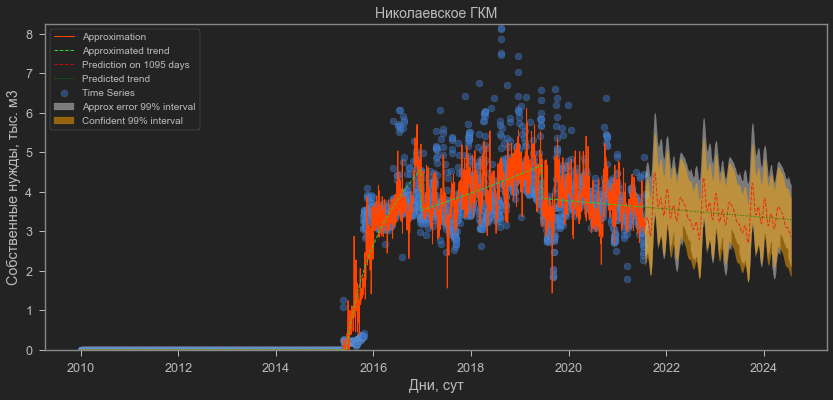

************************************************************************************************************************
The field "Ильинское ГКМ"
Change points: [2017.  2019.6]
Fourier function of 8-th order
R2=0.746; MAE=0.13 (mean_y=1.1); RMSE=0.19


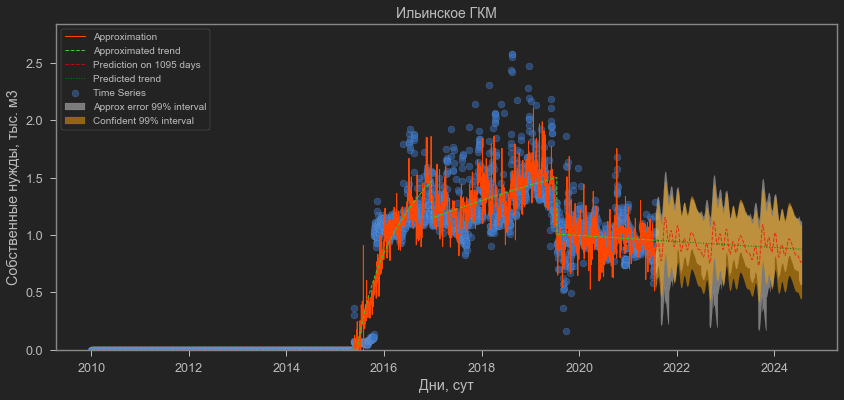

************************************************************************************************************************
The field "Вуктыльское"
Change points: [2012.8 2015.8]
Fourier function of 8-th order
R2=0.937; MAE=30.61 (mean_y=266.17); RMSE=52.9


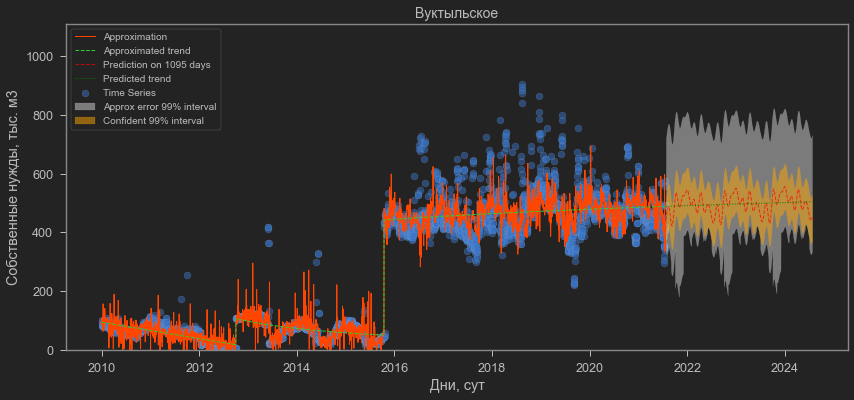

************************************************************************************************************************
The field "Зап.Соплесское"
Change points: [2012.8 2015.8 2017.7 2019.5]
Fourier function of 8-th order
R2=0.933; MAE=1.38 (mean_y=11.09); RMSE=2.24


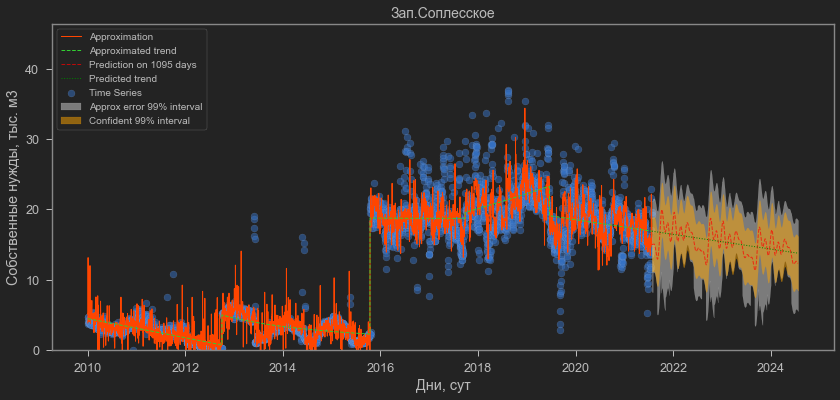

************************************************************************************************************************
The field "Югидское"
Change points: [2015.8]
Fourier function of 8-th order
R2=0.875; MAE=1.88 (mean_y=13.12); RMSE=2.89


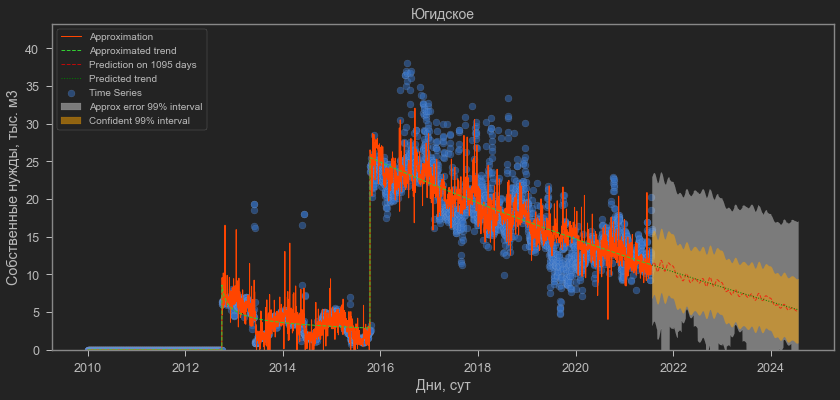

************************************************************************************************************************
The field "Печерокожвинское"
Change points: [2015.8 2017.7 2020. ]
Fourier function of 8-th order
R2=0.924; MAE=1.79 (mean_y=16.56); RMSE=2.87


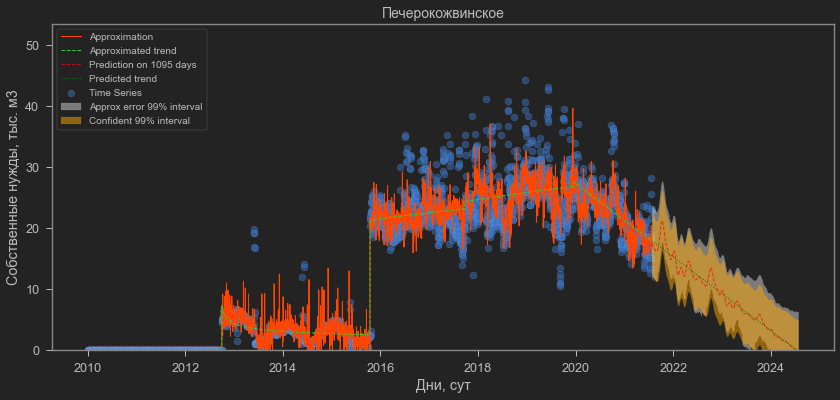

************************************************************************************************************************
The field "ЗАО ПечораНГП"
Change points: [2015.1 2016.4]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


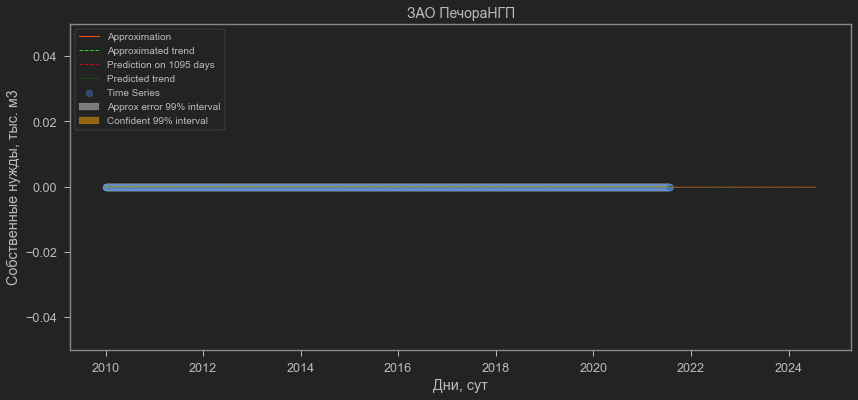

************************************************************************************************************************
The field "ПАО ГПН"
Change points: [2018.5]
Fourier function of 8-th order
R2=0.966; MAE=1246.15 (mean_y=9010.04); RMSE=1946.01


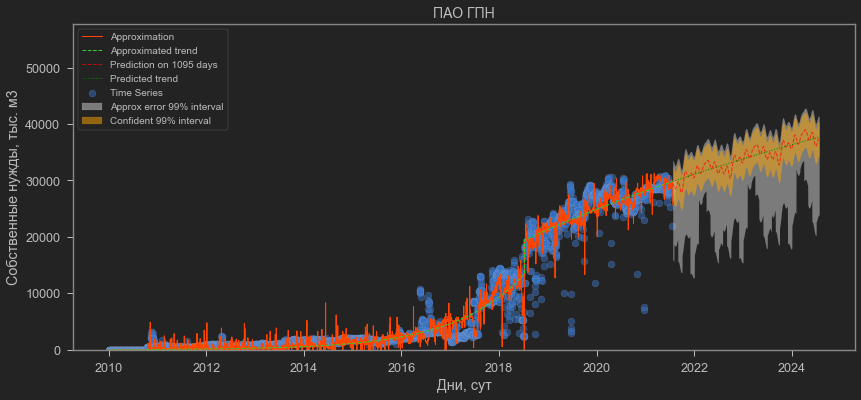

************************************************************************************************************************
The field "ГП ТГ Югорск"
Change points: [nan]
Fourier function of 8-th order
R2=0.902; MAE=0.57 (mean_y=4.13); RMSE=0.74


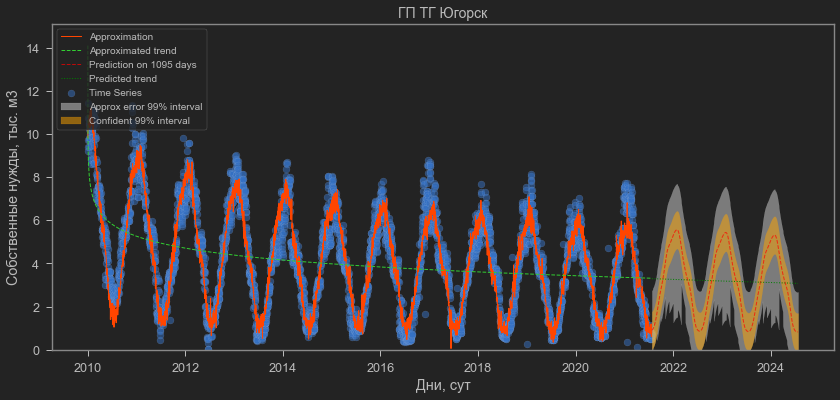

************************************************************************************************************************
The field "ОАО ГП ГР Элиста"
Change points: [2011.7]
Fourier function of 8-th order
R2=0.938; MAE=0.73 (mean_y=5.45); RMSE=1.03


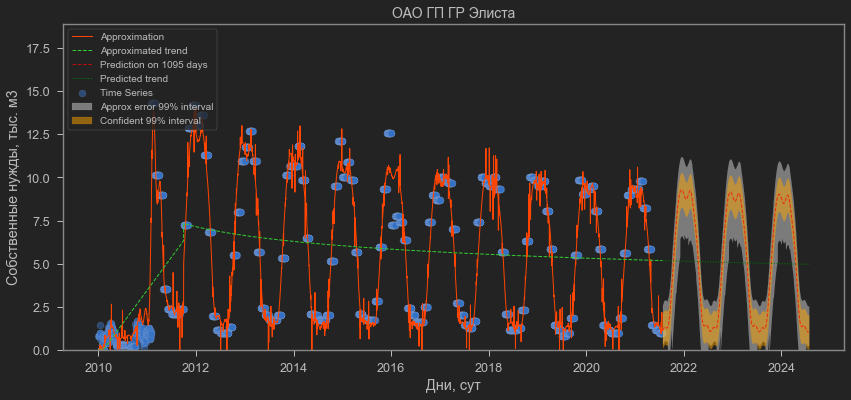

************************************************************************************************************************
The field "ЗАО Нортгаз (ГП 50%)"
Change points: [2011.7 2013.8 2017.5]
Fourier function of 8-th order
R2=0.945; MAE=27.35 (mean_y=283.91); RMSE=57.11


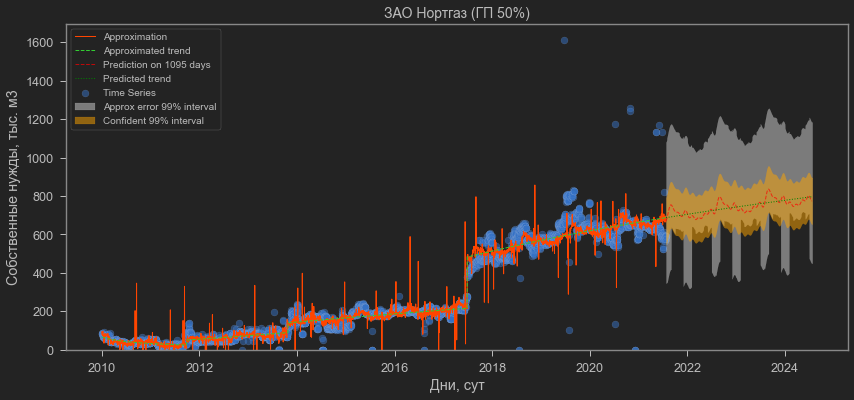

************************************************************************************************************************
The field "ОАО НГК Славнефть (ГП 50%)"
Change points: [2020.]
Fourier function of 8-th order
R2=0.464; MAE=183.44 (mean_y=1681.55); RMSE=406.07


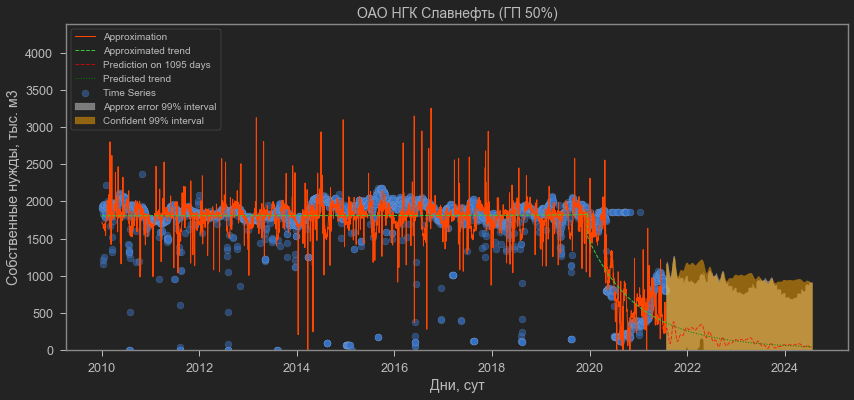

************************************************************************************************************************
The field "АО Арктикгаз (ГП 50%)"
Change points: [2015.5]
Fourier function of 8-th order
R2=0.765; MAE=208.72 (mean_y=884.52); RMSE=459.16


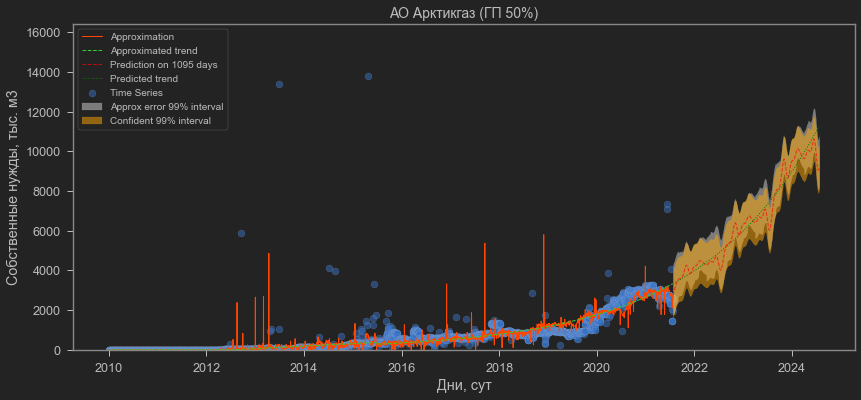

************************************************************************************************************************
The field "ЗАО УралНГП (ГП 37.7%)"
Change points: [nan]
Fourier function of 8-th order
R2=0.464; MAE=3.38 (mean_y=39.32); RMSE=6.08


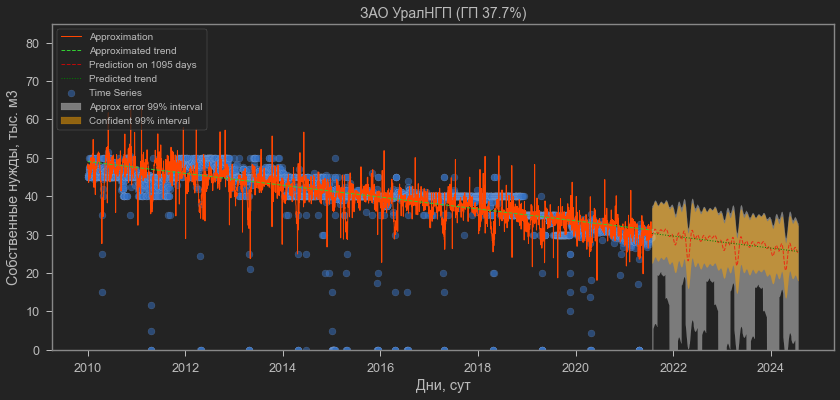

************************************************************************************************************************
The field "ОАО Томскнефть (ГП 50%)"
Change points: [2019.6]
Fourier function of 8-th order
R2=0.449; MAE=29.25 (mean_y=234.18); RMSE=44.78


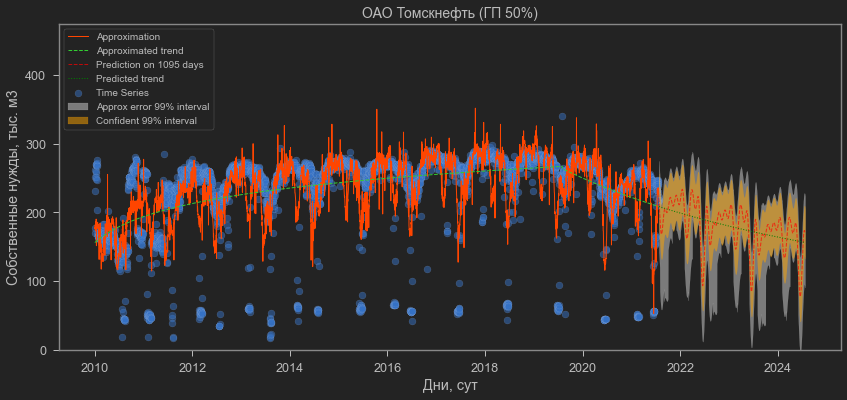

************************************************************************************************************************
The field "Нефтяные компании"
Change points: [2010.5]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


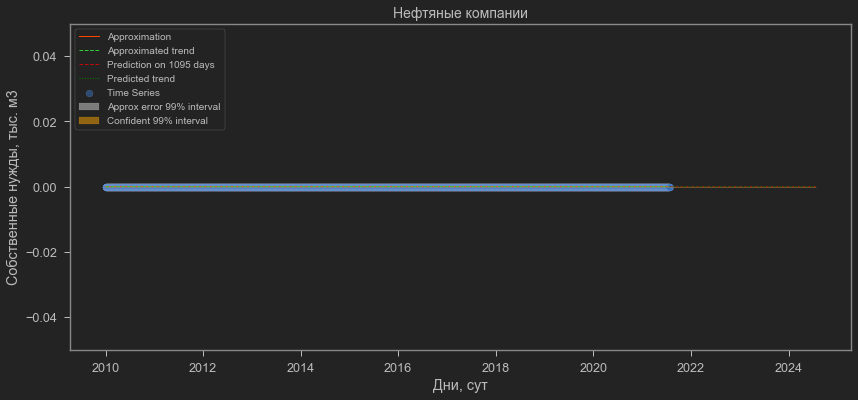

************************************************************************************************************************
The field "Независимые производители"
Change points: [2011.5 2017.5]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


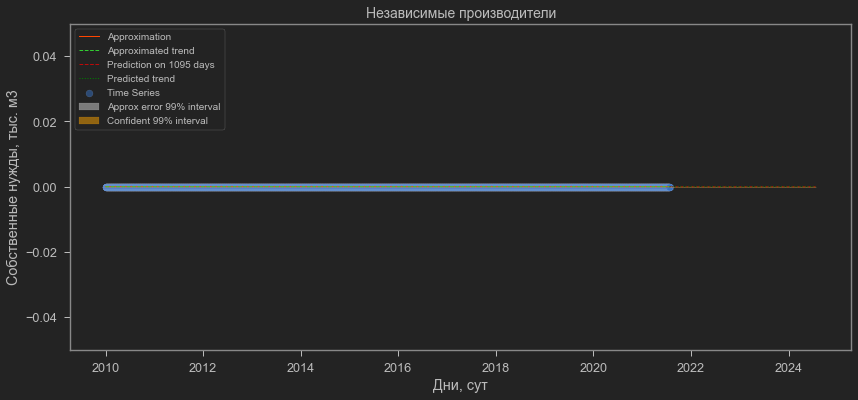

In [84]:
result = pd.DataFrame()
prediction = 365*3
fields = df['Месторождение'].unique()
# fields = ["Сев.-Прибрежное НГКМ"]

for field in fields:
    _result = time_series_approximation(df, field, fourier_order=8, noise_alpha=0.001, noise_window=5, prediction=prediction, exceptions=exceptions, 
                                        target_col='Собственные нужды')
    _result['Месторождение'] = field
    _result['Предприятие'] = df.loc[df['Месторождение'] == field, 'Предприятие'].unique()[0]
    result = pd.concat((result, _result), axis=0)

In [85]:
full_result = pd.merge(result, df[['Дата', 'Месторождение', 'Собственные нужды']], how='left', on=['Месторождение', 'Дата'])
full_result['Residuals'] = full_result['Approximation'] - full_result['Собственные нужды']
full_result['Series_Var'] = full_result['Series_STD'] ** 2

# Save approximation result
full_result.to_csv("consumption_result.csv")

In [17]:
result.head()

,Дата,Month,Approximation,Trend,Series_STD,Series_T-stat_0.95,Single_Noise,Bootstrap_quantile_0.025,Bootstrap_quantile_0.975,Месторождение
0,2010-01-01,1,3414.124924,3665.758434,42.992154,1.960526,-5.401323,-115.597575,155.68288,Заполярное
1,2010-01-02,1,3411.809078,3478.333411,42.992154,1.960526,-14.649213,-115.597575,155.68288,Заполярное
2,2010-01-03,1,3409.841655,3397.701547,42.992154,1.960526,-59.039082,-115.597575,155.68288,Заполярное
3,2010-01-04,1,3408.288856,3346.133671,42.992154,1.960526,42.687702,-115.597575,155.68288,Заполярное
4,2010-01-05,1,3407.205931,3308.308449,42.992154,1.960526,-3.551746,-115.597575,155.68288,Заполярное


-------

### Суммирование ошибок

In [132]:
df_sum = result.groupby('Дата').agg(Approximation=('Approximation', np.sum)).reset_index()
df_sum = pd.merge(df_sum, 
                  df.loc[np.isin(df['Месторождение'], fields_for_sum), ['Дата', 'Добыча', 'Месторождение']].groupby('Дата').agg(Добыча=('Добыча', np.sum)),
                  how='left', on='Дата')
df_sum.head()

,Дата,Approximation,Добыча
0,2010-01-01,1.555004e+06,1550582.66
1,2010-01-02,1.555447e+06,1556934.19
2,2010-01-03,1.554683e+06,1548875.29
3,2010-01-04,1.554008e+06,1552038.31
4,2010-01-05,1.553522e+06,1554068.51


In [133]:
def distr_reduction(input_array, items=1000, bins=100):
    hist, bin_edges = np.histogram(input_array, bins=bins, density=True)
#     return np.random.choice((bin_edges[1:] - np.diff(bin_edges) / 2), p=(hist * np.diff(bin_edges)), size=items)
    return np.random.choice(np.linspace(bin_edges[0], bin_edges[-1], bins), p=(hist * np.diff(bin_edges)), size=items)

def skewed_distribution_summarizer(df, items=1000, bins=100):
    skewed_distribution_data = pd.DataFrame()
    for month in range(11, 12):
#         month_data = df.loc[df['Month'] == month + 1, ['Дата', 'Месторождение', 'Approximation', 'Добыча', 'Residuals']].dropna()
        month_data = df.loc[:, ['Дата', 'Месторождение', 'Approximation', 'Добыча', 'Residuals']].dropna()
        fields = month_data['Месторождение'].unique()
        total_residuals = []
        for k in range(len(fields)):
            print('*' * 50)
            print(f'Month: {month + 1}; Field: {k}. {fields[k]}')
            if len(total_residuals) == 0:
                total_residuals = distr_reduction(month_data.loc[month_data['Месторождение'] == fields[k], 'Residuals'].values, items=items, bins=bins)
            else:
                total_residuals = distr_reduction(_total_residuals, items=items, bins=bins)
            for t in range(k+1, len(fields)):
                _total_residuals = []
                for j in total_residuals:
                    for i in distr_reduction(month_data.loc[month_data['Месторождение'] == fields[t], 'Residuals'].values, items=items, bins=bins):
                        _total_residuals.append(j + i)
        skewed_distribution_data = pd.concat((skewed_distribution_data, pd.DataFrame(data={'Month': [month+1 for _ in range(len(total_residuals))],
                                                                                           'Residuals': total_residuals})), axis=0)
        
    return skewed_distribution_data

In [189]:
full_result = pd.merge(result ,df[['Дата', 'Месторождение', 'Добыча']], how='left', on=['Месторождение', 'Дата'])
full_result['Residuals'] = full_result['Approximation'] - full_result['Добыча']
full_result['Series_Var'] = full_result['Series_STD']**2
full_result = full_result.drop(columns=['Series_STD', 'Single_Noise', 'Bootstrap_quantile_0.025', 'Bootstrap_quantile_0.975'])
sum_data = full_result.groupby('Дата').agg(Approximation=('Approximation', np.sum),
                                           Trend=('Trend', np.sum),
                                           Series_Tstat=('Series_T-stat_0.95', np.mean),
                                           Series_Var=('Series_Var', np.sum),
                                           Month=('Month', np.mean)).reset_index()
sum_data.rename(columns={'Series_Tstat': 'Series_T-stat_0.95'}, inplace=True)

In [ ]:
# %%time
# skewed_distribution_data = skewed_distribution_summarizer(full_result, items=1000, bins=100)

**************************************************
Month: 12; Field: 0. Заполярное
**************************************************
Month: 12; Field: 1. Тазовское (МНГ)
**************************************************
Month: 12; Field: 2. Ямбургское
**************************************************
Month: 12; Field: 3. Бованенковское
**************************************************
Month: 12; Field: 4. Медвежье (сеном)
**************************************************
Month: 12; Field: 5. УКПГ-НТС
**************************************************
Month: 12; Field: 6. УКПГ-Ныда
**************************************************
Month: 12; Field: 7. Харасавэйское
**************************************************
Month: 12; Field: 8. Юбилейное (сеном)
**************************************************
Month: 12; Field: 9. Ямсовейское
**************************************************
Month: 12; Field: 10. Вынгапуровское
**************************************************
Month: 1

In [16]:
#  skewed_distribution_data.to_csv("monthly_residuals.csv")

In [135]:
skewed_distribution_data = pd.read_csv("monthly_residuals.csv")

In [148]:
from Calculation_funcs import variation
from Supporting_inform_funcs import ts_graphic

In [205]:
df_sum['Month'] = df_sum['Дата'].dt.month
noise = pd.DataFrame(data={'Month': df_sum['Дата'][:-prediction].dt.month, 
                           'Residuals':df_sum['Добыча'][:-prediction].values - sum_data['Approximation'][:-prediction].values})
sum_data = variation(df_sum, noise, alpha=alpha, bootstrap=False)

In [209]:
alpha = 0.05

noise_of_total_series = pd.DataFrame(data={'Month': df_sum['Дата'][:-prediction].dt.month, 
                                           'Residuals': df_sum['Добыча'][:-prediction].values - uniform_filter1d(df_sum['Добыча'][:-prediction].values, size=7)})
sum_data = variation(sum_data, noise_of_total_series, alpha=0, bootstrap=False)
sum_data = variation(sum_data, skewed_distribution_data, alpha=alpha, bootstrap=True)
sum_data.head()

,Дата,Approximation,Добыча,Month,Series_STD,Series_T-stat_0.95,Series_T-stat_1,Bootstrap_quantile_0.025,Bootstrap_quantile_0.975
0,2010-01-01,1.555004e+06,1550582.66,1,37499.89242,1.966362,NaN,-64081.956964,50128.30262
1,2010-01-02,1.555447e+06,1556934.19,1,37499.89242,1.966362,NaN,-64081.956964,50128.30262
2,2010-01-03,1.554683e+06,1548875.29,1,37499.89242,1.966362,NaN,-64081.956964,50128.30262
3,2010-01-04,1.554008e+06,1552038.31,1,37499.89242,1.966362,NaN,-64081.956964,50128.30262
4,2010-01-05,1.553522e+06,1554068.51,1,37499.89242,1.966362,NaN,-64081.956964,50128.30262


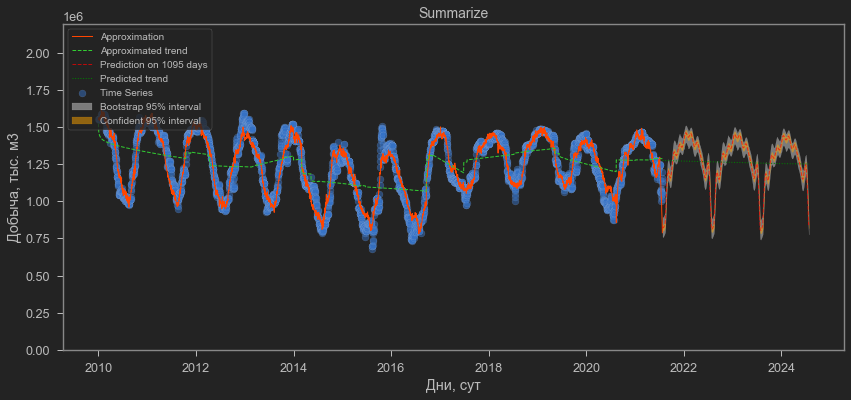

In [138]:
ts_graphic(df_sum['Добыча'][:-prediction].values, sum_data, field='Summarize', date_col='Дата', target_col='Добыча', days_col='Дни', prediction=prediction)

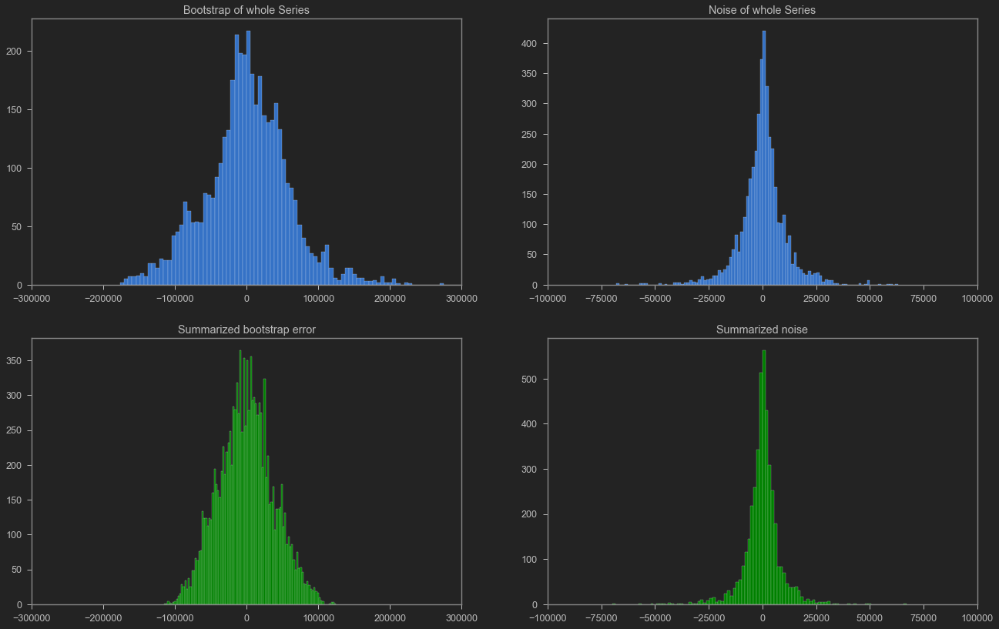

In [139]:
plt.figure(figsize=(22,14))

plt.subplot(221)
plt.hist(df_sum['Добыча'][:-prediction].values - sum_data['Approximation'][:-prediction].values, bins=100, edgecolor='white')
plt.xlim(-300000, 300000)
plt.title('Bootstrap of whole Series')

plt.subplot(222)
plt.hist(sum_data['Single_Noise'][:-prediction].values, bins=100, edgecolor='white')
plt.xlim(-100000, 100000)
plt.title('Noise of whole Series')

plt.subplot(223)
plt.hist(skewed_distribution_data['Residuals'].values, bins=100, edgecolor='white', color='green')
plt.xlim(-300000, 300000)
plt.title('Summarized bootstrap error')

plt.subplot(224)
plt.hist(noise, bins=100, edgecolor='white', color='green')
plt.xlim(-100000, 100000)
plt.title('Summarized noise')

plt.show()